In [1]:
!unzip -q /content/runs.zip -d /content/runs

In [3]:
!unzip -q /content/runs_pitch.zip -d /content/runs_pitch

In [4]:
!nvidia-smi

Wed May  7 11:19:50 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   36C    P8             11W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [5]:
!pip install -q gdown inference-gpu

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.7/105.7 kB 8.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.4/99.4 kB 10.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 65.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.9/75.9 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 72.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 86.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.4/243.4 kB 23.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.0/64.0 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 68.4 MB/s eta 0:00

In [6]:
!pip install -q git+https://github.com/van-123-egg/sports-smai
!pip list | grep supervision

  Preparing metadata (setup.py) ... done
supervision                           0.25.1


In [7]:
!gdown -O "573e61_0.mp4" "https://drive.google.com/uc?id=1yYPKuXbHsCxqjA9G-S6aeR2Kcnos8RPU"
!gdown -O "121364_0.mp4" "https://drive.google.com/uc?id=1vVwjW1dE1drIdd4ZSILfbCGPD4weoNiu"
!gdown -O "0bfacc_0.mp4" "https://drive.google.com/uc?id=12TqauVZ9tLAv8kWxTTBFWtgt2hNQ4_ZF"
!gdown -O "2e57b9_0.mp4" "https://drive.google.com/uc?id=19PGw55V8aA6GZu5-Aac5_9mCy3fNxmEf"
!gdown -O "08fd33_0.mp4" "https://drive.google.com/uc?id=1OG8K6wqUw9t7lp9ms1M48DxRhwTYciK-"


Downloading...
From: https://drive.google.com/uc?id=1yYPKuXbHsCxqjA9G-S6aeR2Kcnos8RPU
To: /content/573e61_0.mp4
100% 18.9M/18.9M [00:00<00:00, 21.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1vVwjW1dE1drIdd4ZSILfbCGPD4weoNiu
To: /content/121364_0.mp4
100% 17.2M/17.2M [00:00<00:00, 24.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=12TqauVZ9tLAv8kWxTTBFWtgt2hNQ4_ZF
To: /content/0bfacc_0.mp4
100% 19.9M/19.9M [00:00<00:00, 30.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=19PGw55V8aA6GZu5-Aac5_9mCy3fNxmEf
To: /content/2e57b9_0.mp4
100% 21.1M/21.1M [00:00<00:00, 35.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=1OG8K6wqUw9t7lp9ms1M48DxRhwTYciK-
To: /content/08fd33_0.mp4
100% 19.9M/19.9M [00:01<00:00, 17.7MB/s]


In [8]:
import os
os.environ["ONNXRUNTIME_EXECUTION_PROVIDERS"] = "[CUDAExecutionProvider]"

## ball, player, goalkeeper and referee detection

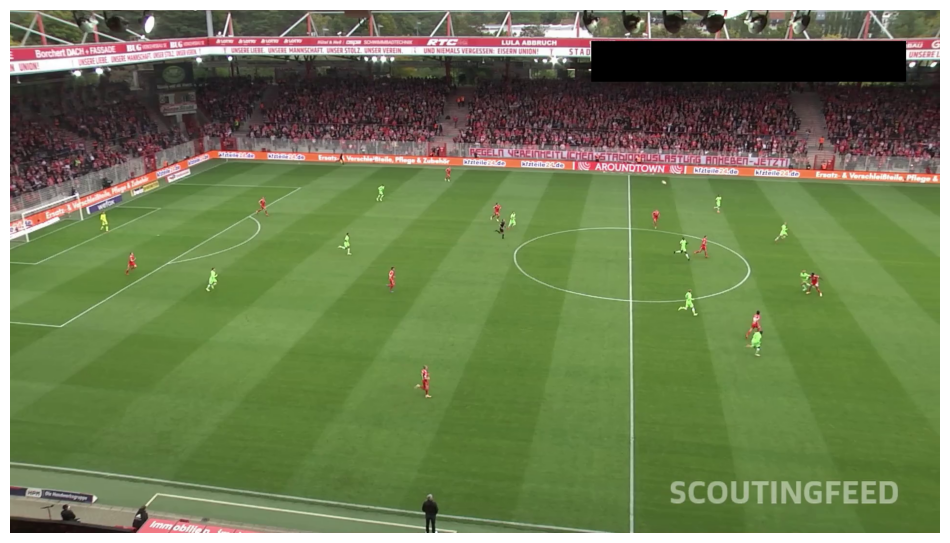

In [9]:
import supervision as sv

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

sv.plot_image(frame)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip -q /content/drive/MyDrive/runs.zip -d /content/drive/MyDrive/runs

In [10]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 49.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 123.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 97.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 105.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

In [ ]:
!unzip runs.zip -d runs

Archive:  runs.zip
   creating: runs/content/runs/
   creating: runs/content/runs/detect/
   creating: runs/content/runs/detect/train/
  inflating: runs/content/runs/detect/train/args.yaml  
   creating: runs/content/runs/detect/train/weights/
   creating: runs/content/runs/detect/val/
  inflating: runs/content/runs/detect/val/confusion_matrix.png  
  inflating: runs/content/runs/detect/val/confusion_matrix_normalized.png  
  inflating: runs/content/runs/detect/val/val_batch1_labels.jpg  
  inflating: runs/content/runs/detect/val/val_batch2_labels.jpg  
  inflating: runs/content/runs/detect/val/P_curve.png  
  inflating: runs/content/runs/detect/val/val_batch0_labels.jpg  
  inflating: runs/content/runs/detect/val/F1_curve.png  
  inflating: runs/content/runs/detect/val/R_curve.png  
  inflating: runs/content/runs/detect/val/val_batch1_pred.jpg  
  inflating: runs/content/runs/detect/val/val_batch2_pred.jpg  
  inflating: runs/content/runs/detect/val/PR_curve.png  
  inflating: runs/co

In [ ]:
!unzip runs_pitch.zip -d runs_pitch

Archive:  runs_pitch.zip
   creating: runs_pitch/content/runs/
   creating: runs_pitch/content/runs/pose/
   creating: runs_pitch/content/runs/pose/train/
  inflating: runs_pitch/content/runs/pose/train/args.yaml  
  inflating: runs_pitch/content/runs/pose/train/results.csv  
  inflating: runs_pitch/content/runs/pose/train/PoseR_curve.png  
  inflating: runs_pitch/content/runs/pose/train/confusion_matrix.png  
  inflating: runs_pitch/content/runs/pose/train/PosePR_curve.png  
  inflating: runs_pitch/content/runs/pose/train/confusion_matrix_normalized.png  
  inflating: runs_pitch/content/runs/pose/train/train_batch1.jpg  
  inflating: runs_pitch/content/runs/pose/train/val_batch1_labels.jpg  
  inflating: runs_pitch/content/runs/pose/train/train_batch1442.jpg  
  inflating: runs_pitch/content/runs/pose/train/PoseP_curve.png  
   creating: runs_pitch/content/runs/pose/train/weights/
  inflating: runs_pitch/content/runs/pose/train/weights/best.pt  
  inflating: runs_pitch/content/runs/po

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.

0: 384x640 1 goalkeeper, 20 players, 2 referees, 152.6ms
Speed: 27.4ms preprocess, 152.6ms inference, 511.1ms postprocess per image at shape (1, 3, 384, 640)


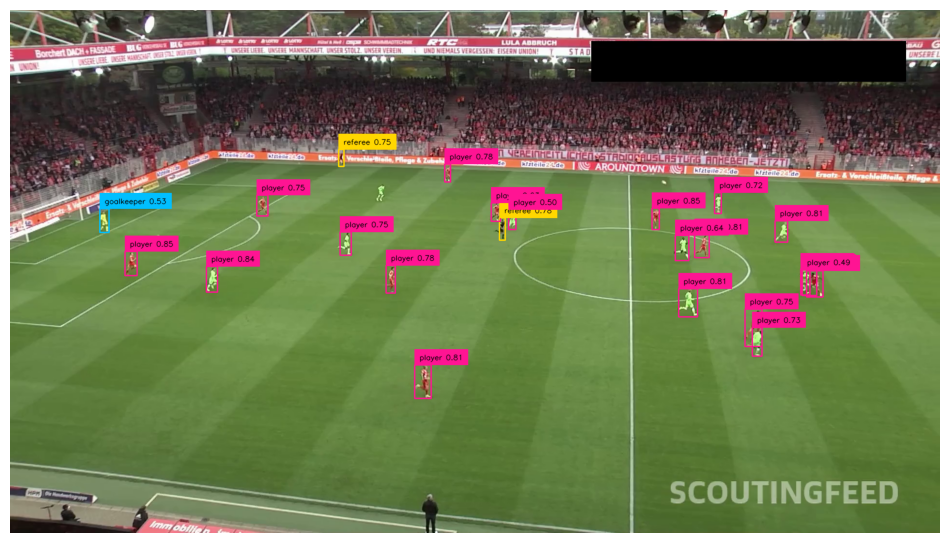

In [11]:
from ultralytics import YOLO
import supervision as sv

# Load your trained YOLOv8 model
model = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")  # Adjust the path to your model

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

# Set up annotators with custom colors
box_annotator = sv.BoxAnnotator(
    color=sv.ColorPalette.from_hex(['#FF8C00', '#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#FF8C00', '#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000')
)

# Read the video frame
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# Perform inference using YOLOv8 model
results = model(frame)[0]  # First frame, first result
detections = sv.Detections.from_ultralytics(results)  # Convert results to a format usable by Supervision

# Create labels for annotations
labels = [
    f"{label} {conf:.2f}"
    for label, conf in zip(detections.data['class_name'], detections.confidence)
]

# Annotate the frame with bounding boxes and labels
annotated_frame = frame.copy()
annotated_frame = box_annotator.annotate(
    scene=annotated_frame,
    detections=detections
)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=detections,
    labels=labels
)

# Display the annotated frame
sv.plot_image(annotated_frame)


## video game style visualization


0: 384x640 1 goalkeeper, 20 players, 2 referees, 65.1ms
Speed: 5.9ms preprocess, 65.1ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


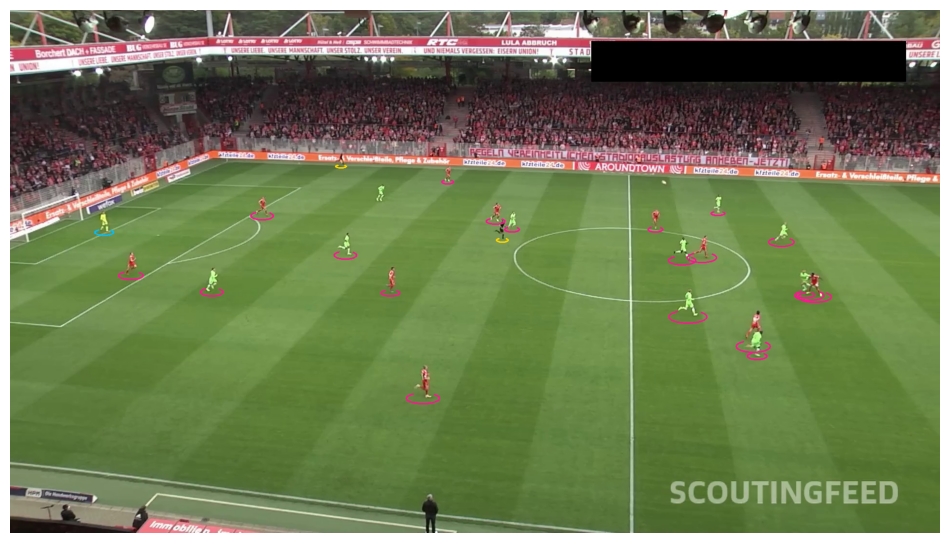

In [12]:
from ultralytics import YOLO
import supervision as sv

# Load your trained YOLOv8 model
# model = YOLO("/content/content/runs/detect/train3/weights/best.pt")  # Adjust the path to your model

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0

# Set up annotators
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=25,
    height=21,
    outline_thickness=1
)

# Read the video frame
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# Perform inference using YOLOv8 model
results = model(frame)[0]  # First frame, first result
detections = sv.Detections.from_ultralytics(results)  # Convert results to a format usable by Supervision

# Filter detections for the ball class (class_id == BALL_ID)
ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

# Filter remaining detections (non-ball) and apply NMS
all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections.class_id -= 1  # Adjust class_id for non-ball detections

# Annotate the frame with ellipses and triangles
annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections
)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections
)

# Display the annotated frame
sv.plot_image(annotated_frame)


## player tracking


0: 384x640 1 goalkeeper, 20 players, 2 referees, 64.2ms
Speed: 3.6ms preprocess, 64.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


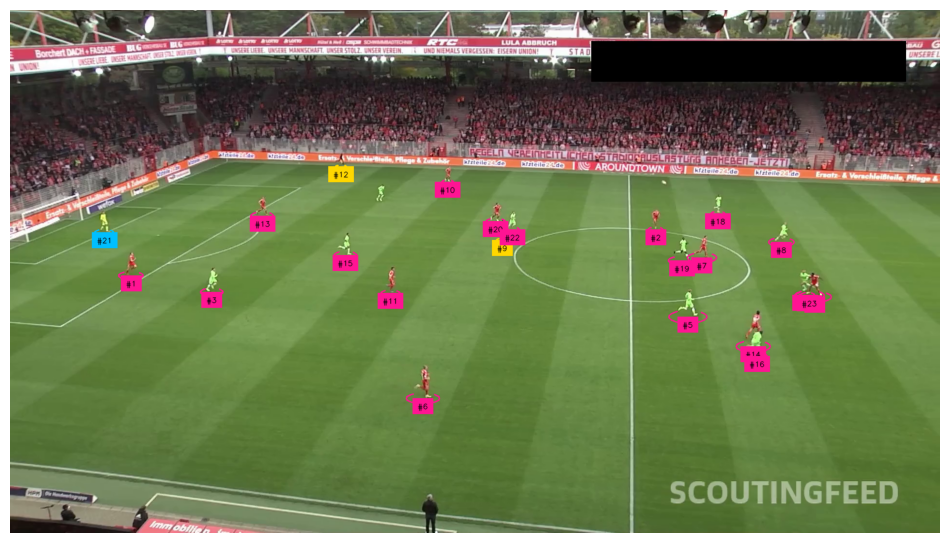

In [13]:
from ultralytics import YOLO
import supervision as sv

# Load your trained YOLOv8 model
model = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")  # Adjust path to your model

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0

# Set up annotators
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=25,
    height=21,
    outline_thickness=1
)

# Initialize tracker
tracker = sv.ByteTrack()
tracker.reset()

# Read video frame
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# Perform inference using YOLOv8 model
results = model(frame)[0]  # First frame, first result
detections = sv.Detections.from_ultralytics(results)  # Convert results to Supervision format

# Filter out ball detections (class_id == BALL_ID)
ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

# Filter out non-ball detections and apply NMS
all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections.class_id -= 1  # Adjust class ID for non-ball detections

# Track the non-ball detections
all_detections = tracker.update_with_detections(detections=all_detections)

# Create labels for each tracker
labels = [
    f"#{tracker_id}"
    for tracker_id in all_detections.tracker_id
]

# Annotate the frame
annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections
)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections,
    labels=labels
)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections
)

# Display the annotated frame
sv.plot_image(annotated_frame)


## split players into teams

![football AI diagram](https://media.roboflow.com/notebooks/examples/football-ai-team-clustering.png)

**Note:** Before training our player clustering model, we need to gather training data. To do this, we'll sample one frame per second, detect players within those frames, and then crop them out.

In [ ]:
from tqdm import tqdm
from ultralytics import YOLO
import supervision as sv
from sports.common.team import TeamClassifier

# Load your trained YOLOv8 player detection model
model = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")  # Adjust path as needed

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
PLAYER_ID = 2  # Class ID corresponding to player
STRIDE = 30    # Sample every 30th frame

# Set up video frame generator
frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

crops = []

# Iterate through frames and collect player crops
for frame in tqdm(frame_generator, desc='collecting crops'):
    # Perform inference using YOLOv8 model
    results = model(frame)[0]

    # Convert YOLO results to Supervision Detections format
    detections = sv.Detections.from_ultralytics(results)

    # Optional NMS (if not already applied inside YOLO)
    detections = detections.with_nms(threshold=0.5, class_agnostic=True)

    # Filter for player detections (class_id == PLAYER_ID)
    player_detections = detections[detections.class_id == PLAYER_ID]

    # Crop the detected players
    player_crops = [sv.crop_image(frame, xyxy) for xyxy in player_detections.xyxy]
    crops += player_crops

# Fit the team classifier on collected crops
team_classifier = TeamClassifier(device="cuda")
team_classifier.fit(crops)


collecting crops: 0it [00:00, ?it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 71.1ms
Speed: 3.0ms preprocess, 71.1ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 1it [00:01,  1.03s/it]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 35.2ms
Speed: 6.5ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 2it [00:01,  1.70it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 35.2ms
Speed: 7.0ms preprocess, 35.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 3it [00:01,  2.23it/s]


0: 384x640 20 players, 2 referees, 35.2ms
Speed: 5.0ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 4it [00:01,  2.55it/s]


0: 384x640 20 players, 1 referee, 35.3ms
Speed: 3.4ms preprocess, 35.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 5it [00:02,  2.80it/s]


0: 384x640 22 players, 1 referee, 35.1ms
Speed: 3.5ms preprocess, 35.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 6it [00:02,  2.99it/s]


0: 384x640 19 players, 2 referees, 35.1ms
Speed: 6.3ms preprocess, 35.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 7it [00:02,  3.20it/s]


0: 384x640 1 ball, 18 players, 2 referees, 56.6ms
Speed: 4.1ms preprocess, 56.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 8it [00:03,  3.24it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 63.0ms
Speed: 5.5ms preprocess, 63.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 9it [00:03,  3.17it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 62.9ms
Speed: 3.9ms preprocess, 62.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 10it [00:03,  3.14it/s]


0: 384x640 1 ball, 20 players, 2 referees, 62.8ms
Speed: 3.6ms preprocess, 62.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 11it [00:04,  3.14it/s]


0: 384x640 19 players, 1 referee, 62.8ms
Speed: 3.2ms preprocess, 62.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 12it [00:04,  3.14it/s]


0: 384x640 1 goalkeeper, 18 players, 1 referee, 62.8ms
Speed: 3.5ms preprocess, 62.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 13it [00:04,  3.16it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 62.8ms
Speed: 3.5ms preprocess, 62.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 14it [00:04,  3.20it/s]


0: 384x640 24 players, 2 referees, 62.8ms
Speed: 3.8ms preprocess, 62.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 15it [00:05,  3.15it/s]


0: 384x640 19 players, 2 referees, 62.9ms
Speed: 3.6ms preprocess, 62.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 16it [00:05,  3.12it/s]


0: 384x640 21 players, 2 referees, 63.2ms
Speed: 3.9ms preprocess, 63.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 17it [00:05,  3.04it/s]


0: 384x640 21 players, 1 referee, 62.9ms
Speed: 4.0ms preprocess, 62.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 18it [00:06,  2.98it/s]


0: 384x640 22 players, 2 referees, 62.9ms
Speed: 3.8ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 19it [00:06,  3.02it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 63.0ms
Speed: 4.2ms preprocess, 63.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 20it [00:06,  3.06it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 62.8ms
Speed: 3.0ms preprocess, 62.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 21it [00:07,  3.12it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 62.9ms
Speed: 3.9ms preprocess, 62.9ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 22it [00:07,  3.13it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 62.8ms
Speed: 3.0ms preprocess, 62.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 23it [00:07,  3.15it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 62.8ms
Speed: 4.6ms preprocess, 62.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 24it [00:08,  3.23it/s]


0: 384x640 25 players, 1 referee, 62.8ms
Speed: 2.6ms preprocess, 62.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 25it [00:08,  2.86it/s]
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.


config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/813M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/368 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


tokenizer_config.json:   0%|          | 0.00/711 [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/798k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/409 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.40M [00:00<?, ?B/s]

Embedding extraction: 16it [00:06,  2.66it/s]


**Note:** Here's a sample (100 elements) of the crops we've gathered.

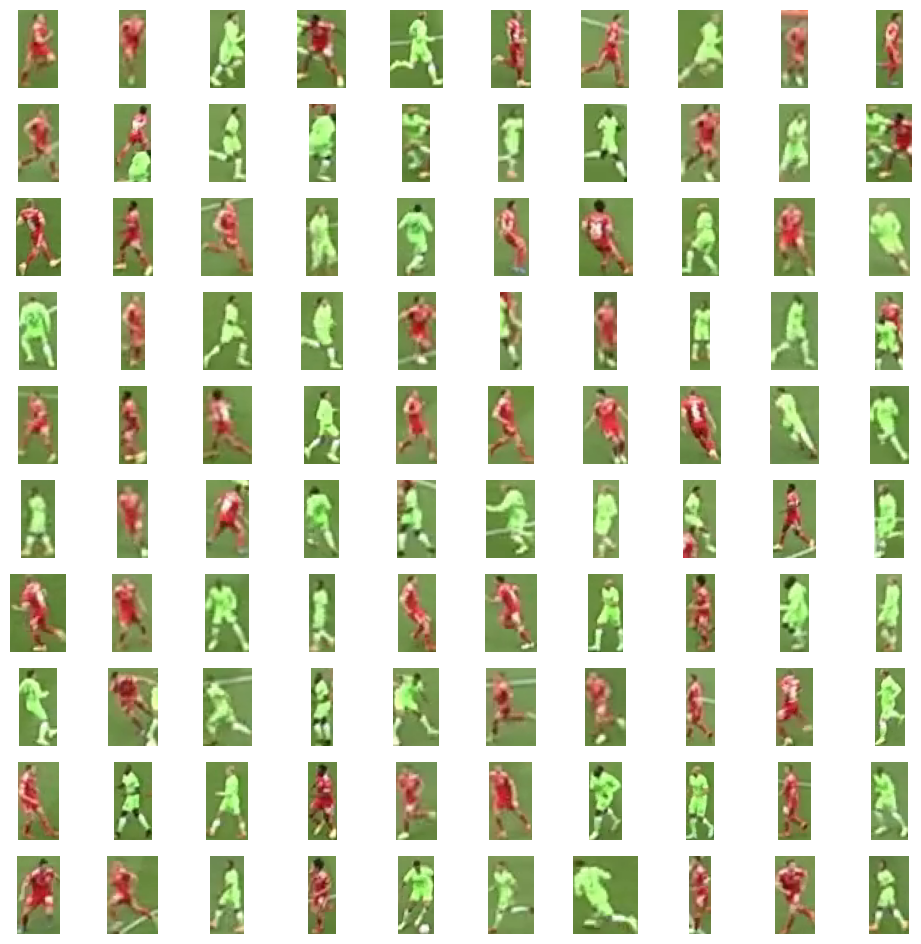

In [16]:
sv.plot_images_grid(crops[:100], grid_size=(10, 10))

**Note:** Next, we'll run [SigLIP](https://huggingface.co/docs/transformers/en/model_doc/siglip) to calculate embeddings for each of the crops.

In [17]:
import torch
from transformers import AutoProcessor, SiglipVisionModel

SIGLIP_MODEL_PATH = 'google/siglip-base-patch16-224'

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
EMBEDDINGS_MODEL = SiglipVisionModel.from_pretrained(SIGLIP_MODEL_PATH).to(DEVICE)
EMBEDDINGS_PROCESSOR = AutoProcessor.from_pretrained(SIGLIP_MODEL_PATH)

In [18]:
import torch

In [19]:
import numpy as np
from more_itertools import chunked

BATCH_SIZE = 32

crops = [sv.cv2_to_pillow(crop) for crop in crops]
batches = chunked(crops, BATCH_SIZE)
data = []
with torch.no_grad():
    for batch in tqdm(batches, desc='embedding extraction'):
        inputs = EMBEDDINGS_PROCESSOR(images=batch, return_tensors="pt").to(DEVICE)
        outputs = EMBEDDINGS_MODEL(**inputs)
        embeddings = torch.mean(outputs.last_hidden_state, dim=1).cpu().numpy()
        data.append(embeddings)

data = np.concatenate(data)

embedding extraction: 16it [00:05,  2.68it/s]


We are using [UMAP](https://github.com/lmcinnes/umap), we project our embeddings from `(N, 768)` to `(N, 3)` and then perform a two-cluster division using [KMeans].

In [20]:
import umap
from sklearn.cluster import KMeans

REDUCER = umap.UMAP(n_components=3)
CLUSTERING_MODEL = KMeans(n_clusters=2)

In [21]:
projections = REDUCER.fit_transform(data)
clusters = CLUSTERING_MODEL.fit_predict(projections)

**Note:** Here's an interactive visualization of our results. Click on a dot to display its associated crop.


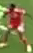
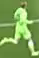
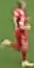
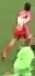
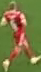
...
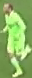
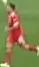
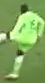
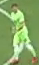
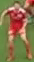

In [22]:
import plotly.graph_objects as go
import numpy as np
from typing import Dict, List
from IPython.core.display import display, HTML
from PIL import Image
import base64
from io import BytesIO


def pil_image_to_data_uri(image: Image.Image) -> str:
    buffered = BytesIO()
    image.save(buffered, format="PNG")
    img_str = base64.b64encode(buffered.getvalue()).decode("utf-8")
    return f"data:image/png;base64,{img_str}"


def display_projections(
    labels: np.ndarray,
    projections: np.ndarray,
    images: List[Image.Image],
    show_legend: bool = False,
    show_markers_with_text: bool = True
) -> None:
    image_data_uris = {f"image_{i}": pil_image_to_data_uri(image) for i, image in enumerate(images)}
    image_ids = np.array([f"image_{i}" for i in range(len(images))])

    unique_labels = np.unique(labels)
    traces = []
    for unique_label in unique_labels:
        mask = labels == unique_label
        customdata_masked = image_ids[mask]
        trace = go.Scatter3d(
            x=projections[mask][:, 0],
            y=projections[mask][:, 1],
            z=projections[mask][:, 2],
            mode='markers+text' if show_markers_with_text else 'markers',
            text=labels[mask],
            customdata=customdata_masked,
            name=str(unique_label),
            marker=dict(size=8),
            hovertemplate="<b>class: %{text}</b><br>image ID: %{customdata}<extra></extra>"
        )
        traces.append(trace)

    # Calculate shared range for cube appearance
    all_axes = projections
    min_val = np.min(all_axes)
    max_val = np.max(all_axes)
    padding = (max_val - min_val) * 0.05
    axis_range = [min_val - padding, max_val + padding]

    fig = go.Figure(data=traces)
    fig.update_layout(
        scene=dict(
            xaxis=dict(title='X', range=axis_range),
            yaxis=dict(title='Y', range=axis_range),
            zaxis=dict(title='Z', range=axis_range),
            aspectmode='cube'  # Ensures equal scaling
        ),
        width=1000,
        height=1000,
        showlegend=show_legend
    )

    plotly_div = fig.to_html(full_html=False, include_plotlyjs=False, div_id="scatter-plot-3d")

    javascript_code = f"""
    <script>
        function displayImage(imageId) {{
            var imageElement = document.getElementById('image-display');
            var placeholderText = document.getElementById('placeholder-text');
            var imageDataURIs = {image_data_uris};
            imageElement.src = imageDataURIs[imageId];
            imageElement.style.display = 'block';
            placeholderText.style.display = 'none';
        }}

        var chartElement = document.getElementById('scatter-plot-3d');

        chartElement.on('plotly_click', function(data) {{
            var customdata = data.points[0].customdata;
            displayImage(customdata);
        }});
    </script>
    """

    html_template = f"""
    <!DOCTYPE html>
    <html>
        <head>
            <script src="https://cdn.plot.ly/plotly-latest.min.js"></script>
            <style>
                #image-container {{
                    position: fixed;
                    top: 0;
                    left: 0;
                    width: 200px;
                    height: 200px;
                    padding: 5px;
                    border: 1px solid #ccc;
                    background-color: white;
                    z-index: 1000;
                    box-sizing: border-box;
                    display: flex;
                    align-items: center;
                    justify-content: center;
                    text-align: center;
                }}
                #image-display {{
                    width: 100%;
                    height: 100%;
                    object-fit: contain;
                }}
            </style>
        </head>
        <body>
            {plotly_div}
            <div id="image-container">
                <img id="image-display" src="" alt="Selected image" style="display: none;" />
                <p id="placeholder-text">Click on a data entry to display an image</p>
            </div>
            {javascript_code}
        </body>
    </html>
    """

    display(HTML(html_template))

display_projections(clusters, projections, crops)

**Note:** To simplify the use of the SigLIP, UMAP, and KMeans combo, I've packaged all these models into a [`TeamClassifier`](https://github.com/roboflow/sports/blob/06053616f1f8a8ae1fa936eb00dcdc2e4f888bb1/sports/common/team.py#L41) that you can find in the [sports](https://github.com/roboflow/sports) repository.

In [23]:
# import supervision as sv
# from tqdm import tqdm
# from sports.common.team import TeamClassifier

# SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
# PLAYER_ID = 2
# STRIDE = 30

# frame_generator = sv.get_video_frames_generator(
#     source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

# crops = []
# for frame in tqdm(frame_generator, desc='collecting crops'):
#     result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
#     detections = sv.Detections.from_inference(result)
#     players_detections = detections[detections.class_id == PLAYER_ID]
#     players_crops = [sv.crop_image(frame, xyxy) for xyxy in detections.xyxy]
#     crops += players_crops

# team_classifier = TeamClassifier(device="cuda")
# team_classifier.fit(crops)
import supervision as sv
from tqdm import tqdm
from ultralytics import YOLO
from sports.common.team import TeamClassifier

# Load your trained YOLOv8 model
model = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")  # Adjust the path to your model

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
PLAYER_ID = 2
STRIDE = 30

# Set up video frame generator
frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

crops = []
# Process frames and collect crops
for frame in tqdm(frame_generator, desc='collecting crops'):
    # Perform inference using YOLOv8 model
    results = model(frame)[0]  # First frame, first result
    detections = sv.Detections.from_ultralytics(results)  # Convert results to Supervision format

    # Filter player detections
    players_detections = detections[detections.class_id == PLAYER_ID]

    # Crop the player regions from the frame
    players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
    crops += players_crops

# Initialize and train the team classifier
team_classifier = TeamClassifier(device="cuda")
team_classifier.fit(crops)


collecting crops: 0it [00:00, ?it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 64.4ms
Speed: 3.4ms preprocess, 64.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 1it [00:01,  1.97s/it]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 35.2ms
Speed: 4.5ms preprocess, 35.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 2it [00:02,  1.08s/it]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 40.0ms
Speed: 4.5ms preprocess, 40.0ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 3it [00:02,  1.20it/s]


0: 384x640 20 players, 2 referees, 44.8ms
Speed: 3.4ms preprocess, 44.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 4it [00:03,  1.36it/s]


0: 384x640 20 players, 1 referee, 62.9ms
Speed: 4.1ms preprocess, 62.9ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 5it [00:04,  1.46it/s]


0: 384x640 22 players, 1 referee, 62.9ms
Speed: 3.8ms preprocess, 62.9ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 6it [00:04,  1.46it/s]


0: 384x640 19 players, 2 referees, 64.2ms
Speed: 3.4ms preprocess, 64.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 7it [00:05,  1.53it/s]


0: 384x640 1 ball, 18 players, 2 referees, 62.9ms
Speed: 11.4ms preprocess, 62.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 8it [00:05,  1.61it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 63.2ms
Speed: 3.4ms preprocess, 63.2ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 9it [00:06,  1.67it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 64.6ms
Speed: 3.9ms preprocess, 64.6ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 10it [00:07,  1.72it/s]


0: 384x640 1 ball, 20 players, 2 referees, 64.5ms
Speed: 3.5ms preprocess, 64.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 11it [00:07,  1.79it/s]


0: 384x640 19 players, 1 referee, 62.9ms
Speed: 3.2ms preprocess, 62.9ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 12it [00:08,  1.82it/s]


0: 384x640 1 goalkeeper, 18 players, 1 referee, 63.2ms
Speed: 3.3ms preprocess, 63.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 13it [00:08,  1.87it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 63.1ms
Speed: 3.4ms preprocess, 63.1ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 14it [00:09,  1.88it/s]


0: 384x640 24 players, 2 referees, 62.9ms
Speed: 3.5ms preprocess, 62.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 15it [00:09,  1.91it/s]


0: 384x640 19 players, 2 referees, 62.9ms
Speed: 3.3ms preprocess, 62.9ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 16it [00:10,  1.91it/s]


0: 384x640 21 players, 2 referees, 64.3ms
Speed: 3.5ms preprocess, 64.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 17it [00:10,  1.99it/s]


0: 384x640 21 players, 1 referee, 67.2ms
Speed: 3.6ms preprocess, 67.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 18it [00:11,  2.03it/s]


0: 384x640 22 players, 2 referees, 63.0ms
Speed: 7.0ms preprocess, 63.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 19it [00:11,  2.22it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 62.9ms
Speed: 3.4ms preprocess, 62.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 20it [00:11,  2.32it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 68.1ms
Speed: 3.5ms preprocess, 68.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 21it [00:12,  2.31it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 62.9ms
Speed: 9.0ms preprocess, 62.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 22it [00:12,  2.24it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 71.5ms
Speed: 3.6ms preprocess, 71.5ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 23it [00:13,  2.22it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 62.9ms
Speed: 3.7ms preprocess, 62.9ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 24it [00:13,  2.17it/s]


0: 384x640 25 players, 1 referee, 62.9ms
Speed: 5.3ms preprocess, 62.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 25it [00:14,  1.74it/s]
Embedding extraction: 17it [00:06,  2.78it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



**Note:** Time to assign goalkeepers to teams. We'll use a simple heuristic: calculate the average position (centroid) of the players belonging to both teams and then assign the goalkeeper to the team whose average position is closer.

In [24]:
import numpy as np
import supervision as sv

def resolve_goalkeepers_team_id(
    players: sv.Detections,
    goalkeepers: sv.Detections
) -> np.ndarray:
    goalkeepers_xy = goalkeepers.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    players_xy = players.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    team_0_centroid = players_xy[players.class_id == 0].mean(axis=0)
    team_1_centroid = players_xy[players.class_id == 1].mean(axis=0)
    goalkeepers_team_id = []
    for goalkeeper_xy in goalkeepers_xy:
        dist_0 = np.linalg.norm(goalkeeper_xy - team_0_centroid)
        dist_1 = np.linalg.norm(goalkeeper_xy - team_1_centroid)
        goalkeepers_team_id.append(0 if dist_0 < dist_1 else 1)

    return np.array(goalkeepers_team_id)


0: 384x640 1 goalkeeper, 20 players, 2 referees, 65.8ms
Speed: 3.6ms preprocess, 65.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


Embedding extraction: 1it [00:00,  3.48it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



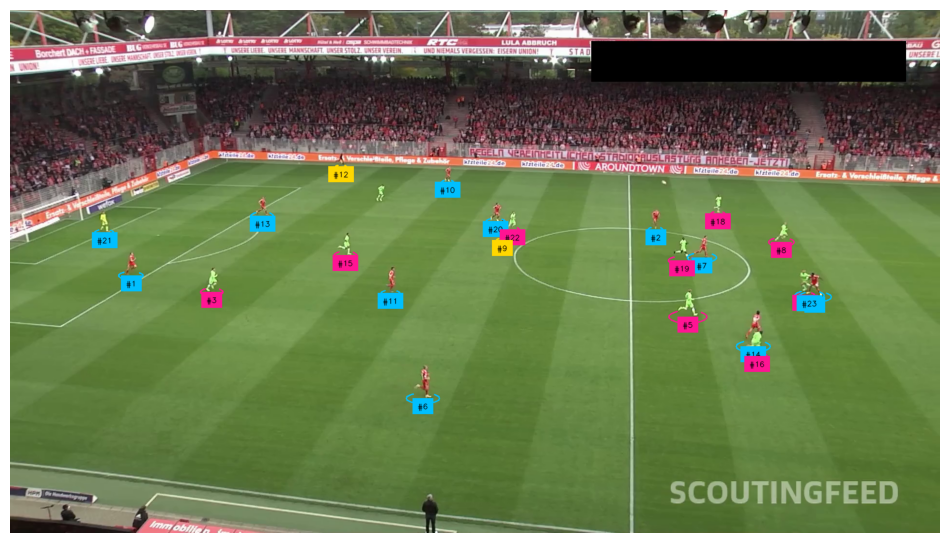

In [25]:
import supervision as sv
from ultralytics import YOLO

# Load your trained YOLOv8 model
model = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")  # Adjust the path to your model

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3

ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=25,
    height=21,
    outline_thickness=1
)

tracker = sv.ByteTrack()
tracker.reset()

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# Perform inference using YOLOv8 model
results = model(frame)[0]  # First frame, first result
detections = sv.Detections.from_ultralytics(results)  # Convert results to Supervision format

# Separate detections by class
ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections = tracker.update_with_detections(detections=all_detections)

goalkeepers_detections = all_detections[all_detections.class_id == GOALKEEPER_ID]
players_detections = all_detections[all_detections.class_id == PLAYER_ID]
referees_detections = all_detections[all_detections.class_id == REFEREE_ID]

# Crop player regions from the frame
players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
# Use the team classifier to predict teams for the players
players_detections.class_id = team_classifier.predict(players_crops)

# Resolve goalkeeper team IDs
goalkeepers_detections.class_id = resolve_goalkeepers_team_id(
    players_detections, goalkeepers_detections)

# Adjust referee class IDs
referees_detections.class_id -= 1

# Merge all detections
all_detections = sv.Detections.merge([
    players_detections, goalkeepers_detections, referees_detections])

# Prepare labels for tracker IDs
labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

# Ensure class IDs are integers
all_detections.class_id = all_detections.class_id.astype(int)

# Annotate frame with detections
annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections,
    labels=labels)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections)

# Display the annotated frame
sv.plot_image(annotated_frame)


## pitch keypoint detection


0: 384x640 1 pitch, 55.5ms
Speed: 3.3ms preprocess, 55.5ms inference, 7.0ms postprocess per image at shape (1, 3, 384, 640)


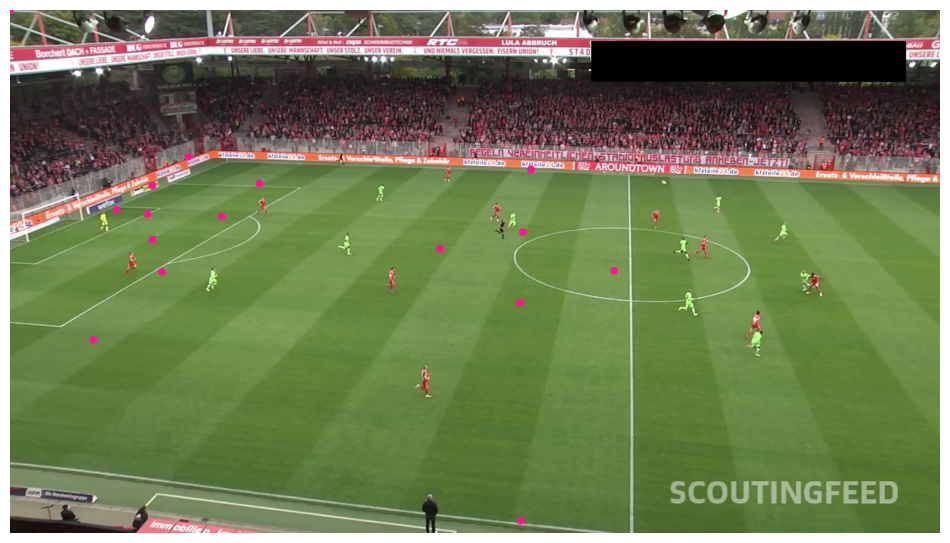

In [26]:
# import supervision as sv

# SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

# vertex_annotator = sv.VertexAnnotator(
#     color=sv.Color.from_hex('#FF1493'),
#     radius=8)

# frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
# frame = next(frame_generator)

# result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
# key_points = sv.KeyPoints.from_inference(result)

# annotated_frame = frame.copy()
# annotated_frame = vertex_annotator.annotate(
#     scene=annotated_frame,
#     key_points=key_points)

# sv.plot_image(annotated_frame)


# Load your trained YOLOv8 keypoint model

import supervision as sv
from ultralytics import YOLO
import cv2

model = YOLO("/content/runs_pitch/content/runs/pose/train/weights/best.pt")

# Load your trained YOLOv8 keypoint model
# model = YOLO("/content/runs/pose/train/weights/best.pt")

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

vertex_annotator = sv.VertexAnnotator(
    color=sv.Color.from_hex('#FF1493'),
    radius=8)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# Run inference
results = model.predict(source=frame, conf=0.3)

# Use built-in utility to convert from YOLO keypoints to supervision KeyPoints
key_points = sv.KeyPoints.from_ultralytics(results[0])

# Annotate and show the frame
annotated_frame = frame.copy()
annotated_frame = vertex_annotator.annotate(
    scene=annotated_frame,
    key_points=key_points)

sv.plot_image(annotated_frame)



**Note:** Notice that some of the keypoints we detected are in incorrect locations. These are keypoints with a low confidence level. Let's filter out these keypoints and keep only the ones the model is confident about.

## filter low confidence keypoints

In [ ]:
!unzip -q /content/drive/MyDrive/runs_pitch.zip -d /content/drive/MyDrive/runs_pitch


0: 384x640 1 pitch, 65.4ms
Speed: 3.1ms preprocess, 65.4ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


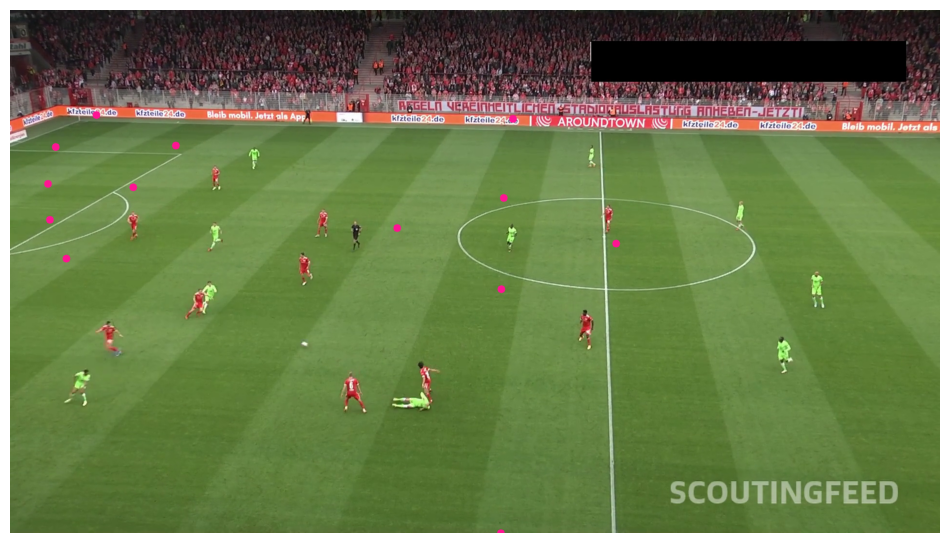

In [27]:
# import supervision as sv

# SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

# vertex_annotator = sv.VertexAnnotator(
#     color=sv.Color.from_hex('#FF1493'),
#     radius=8)

# frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
# frame = next(frame_generator)

# result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
# key_points = sv.KeyPoints.from_inference(result)

# filter = key_points.confidence[0] > 0.5
# frame_reference_points = key_points.xy[0][filter]
# frame_reference_key_points = sv.KeyPoints(
#     xy=frame_reference_points[np.newaxis, ...])

# annotated_frame = frame.copy()
# annotated_frame = vertex_annotator.annotate(
#     scene=annotated_frame,
#     key_points=frame_reference_key_points)

# sv.plot_image(annotated_frame)
import supervision as sv
from ultralytics import YOLO
import numpy as np

# Load your trained keypoint model
model = YOLO("/content/runs_pitch/content/runs/pose/train/weights/best.pt")

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

# Annotator for marking keypoints
vertex_annotator = sv.VertexAnnotator(
    color=sv.Color.from_hex('#FF1493'),
    radius=8)

# Start video from frame 200
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
frame = next(frame_generator)

# Inference
results = model.predict(source=frame, conf=0.3)

# Get supervision KeyPoints object
key_points = sv.KeyPoints.from_ultralytics(results[0])

# Filter keypoints by confidence (> 0.5)
confidence = results[0].keypoints.conf[0].cpu().numpy()  # shape: (num_keypoints,)
coordinates = results[0].keypoints.xy[0].cpu().numpy()   # shape: (num_keypoints, 2)

mask = confidence > 0.5
filtered_coordinates = coordinates[mask]

# Re-wrap filtered coordinates in supervision KeyPoints (as batch of 1 frame)
frame_reference_key_points = sv.KeyPoints(xy=np.expand_dims(filtered_coordinates, axis=0))

# Annotate
annotated_frame = frame.copy()
annotated_frame = vertex_annotator.annotate(
    scene=annotated_frame,
    key_points=frame_reference_key_points)

sv.plot_image(annotated_frame)


## project pitch lines on frame

**Note:** The [sports](https://github.com/roboflow/sports) repository contains a [`SoccerPitchConfiguration`](https://github.com/roboflow/sports/blob/06053616f1f8a8ae1fa936eb00dcdc2e4f888bb1/sports/configs/soccer.py#L6) that provides information about the real-world geometry of the soccer pitch. It also includes utilities for visualizing elements located on the pitch.

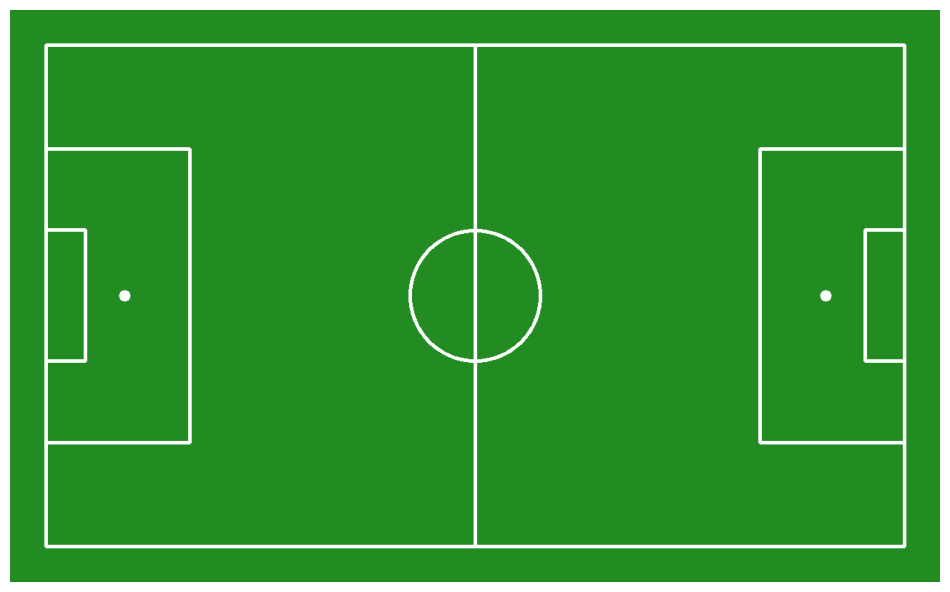

In [28]:
from sports.annotators.soccer import draw_pitch
from sports.configs.soccer import SoccerPitchConfiguration

CONFIG = SoccerPitchConfiguration()

annotated_frame = draw_pitch(CONFIG)

sv.plot_image(annotated_frame)

**Note:** It's time to utilize the keypoint pairs located on the camera perspective plane and the football pitch plane. The [sports](https://github.com/roboflow/sports) repository includes a [`ViewTransformer`](https://github.com/roboflow/sports/blob/06053616f1f8a8ae1fa936eb00dcdc2e4f888bb1/sports/common/view.py#L7), which employs homography for perspective transformation.


0: 384x640 1 pitch, 68.5ms
Speed: 3.4ms preprocess, 68.5ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)


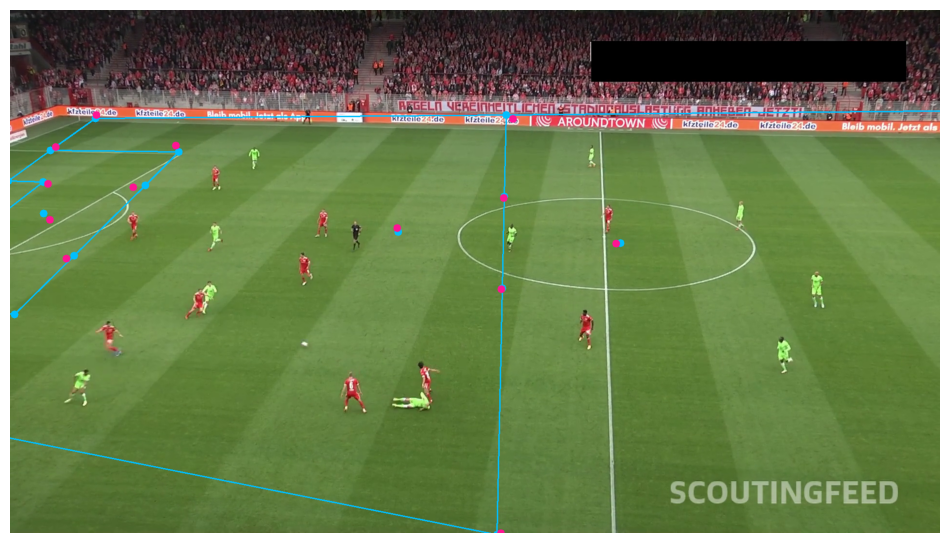

In [29]:
# import numpy as np
# import supervision as sv
# from sports.common.view import ViewTransformer

# SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

# edge_annotator = sv.EdgeAnnotator(
#     color=sv.Color.from_hex('#00BFFF'),
#     thickness=2, edges=CONFIG.edges)
# vertex_annotator = sv.VertexAnnotator(
#     color=sv.Color.from_hex('#FF1493'),
#     radius=8)
# vertex_annotator_2 = sv.VertexAnnotator(
#     color=sv.Color.from_hex('#00BFFF'),
#     radius=8)

# frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
# frame = next(frame_generator)

# result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
# key_points = sv.KeyPoints.from_inference(result)

# filter = key_points.confidence[0] > 0.5
# frame_reference_points = key_points.xy[0][filter]
# frame_reference_key_points = sv.KeyPoints(
#     xy=frame_reference_points[np.newaxis, ...])

# pitch_reference_points = np.array(CONFIG.vertices)[filter]

# transformer = ViewTransformer(
#     source=pitch_reference_points,
#     target=frame_reference_points
# )

# pitch_all_points = np.array(CONFIG.vertices)
# frame_all_points = transformer.transform_points(points=pitch_all_points)

# frame_all_key_points = sv.KeyPoints(xy=frame_all_points[np.newaxis, ...])

# annotated_frame = frame.copy()
# annotated_frame = edge_annotator.annotate(
#     scene=annotated_frame,
#     key_points=frame_all_key_points)
# annotated_frame = vertex_annotator_2.annotate(
#     scene=annotated_frame,
#     key_points=frame_all_key_points)
# annotated_frame = vertex_annotator.annotate(
#     scene=annotated_frame,
#     key_points=frame_reference_key_points)

# sv.plot_image(annotated_frame)
import numpy as np
import supervision as sv
from ultralytics import YOLO
from sports.common.view import ViewTransformer

# Load custom pitch/field detection model
model = YOLO("/content/runs_pitch/content/runs/pose/train/weights/best.pt")

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

# Annotators
edge_annotator = sv.EdgeAnnotator(
    color=sv.Color.from_hex('#00BFFF'),
    thickness=2, edges=CONFIG.edges)
vertex_annotator = sv.VertexAnnotator(
    color=sv.Color.from_hex('#FF1493'),
    radius=8)
vertex_annotator_2 = sv.VertexAnnotator(
    color=sv.Color.from_hex('#00BFFF'),
    radius=8)

# Read one frame from video
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
frame = next(frame_generator)

# Inference with YOLOv8 keypoint model
results = model.predict(source=frame, conf=0.3)

# Extract keypoints and confidence
keypoints_xy = results[0].keypoints.xy[0].cpu().numpy()        # shape: (N, 2)
keypoints_conf = results[0].keypoints.conf[0].cpu().numpy()    # shape: (N,)

# Filter keypoints with confidence > 0.5
mask = keypoints_conf > 0.5
frame_reference_points = keypoints_xy[mask]

# Wrap filtered keypoints into supervision format
frame_reference_key_points = sv.KeyPoints(
    xy=frame_reference_points[np.newaxis, ...])

# Get pitch reference points using the same mask
pitch_reference_points = np.array(CONFIG.vertices)[mask]

# Create transformer using matched keypoints
transformer = ViewTransformer(
    source=pitch_reference_points,
    target=frame_reference_points
)

# Transform all CONFIG vertices into frame points
pitch_all_points = np.array(CONFIG.vertices)
frame_all_points = transformer.transform_points(points=pitch_all_points)

# Wrap all projected points for annotation
frame_all_key_points = sv.KeyPoints(xy=frame_all_points[np.newaxis, ...])

# Annotate frame with edges and keypoints
annotated_frame = frame.copy()
annotated_frame = edge_annotator.annotate(
    scene=annotated_frame,
    key_points=frame_all_key_points)
annotated_frame = vertex_annotator_2.annotate(
    scene=annotated_frame,
    key_points=frame_all_key_points)
annotated_frame = vertex_annotator.annotate(
    scene=annotated_frame,
    key_points=frame_reference_key_points)

# Display the result
sv.plot_image(annotated_frame)


## project ball, players and referies on pitch

In [30]:
# import supervision as sv
# from tqdm import tqdm
# from sports.common.team import TeamClassifier

# SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
# PLAYER_ID = 2
# STRIDE = 30

# frame_generator = sv.get_video_frames_generator(
#     source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

# crops = []
# for frame in tqdm(frame_generator, desc='collecting crops'):
#     result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
#     detections = sv.Detections.from_inference(result)
#     players_detections = detections[detections.class_id == PLAYER_ID]
#     players_crops = [sv.crop_image(frame, xyxy) for xyxy in detections.xyxy]
#     crops += players_crops

# team_classifier = TeamClassifier(device="cuda")
# team_classifier.fit(crops)
import supervision as sv
from tqdm import tqdm
from ultralytics import YOLO
from sports.common.team import TeamClassifier

# Load your trained YOLOv8 player detection model
model = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")  # <-- Adjust this path if needed

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
PLAYER_ID = 2
STRIDE = 30

# Create frame generator with stride
frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

crops = []

# Collect player crops from video
for frame in tqdm(frame_generator, desc='collecting crops'):
    # Run inference using YOLOv8
    results = model(frame)[0]  # Get the first result

    # Convert to Supervision Detections format
    detections = sv.Detections.from_ultralytics(results)

    # Filter for players only
    player_detections = detections[detections.class_id == PLAYER_ID]

    # Crop each player detection from the frame
    player_crops = [sv.crop_image(frame, xyxy) for xyxy in player_detections.xyxy]
    crops += player_crops

# Fit team classifier on collected player crops
team_classifier = TeamClassifier(device="cuda")
team_classifier.fit(crops)


collecting crops: 0it [00:00, ?it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 64.4ms
Speed: 3.5ms preprocess, 64.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 1it [00:02,  2.80s/it]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 35.9ms
Speed: 3.3ms preprocess, 35.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 2it [00:03,  1.41s/it]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 35.9ms
Speed: 3.7ms preprocess, 35.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 3it [00:03,  1.03it/s]


0: 384x640 20 players, 2 referees, 46.2ms
Speed: 11.6ms preprocess, 46.2ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 4it [00:04,  1.27it/s]


0: 384x640 20 players, 1 referee, 35.8ms
Speed: 4.5ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 5it [00:04,  1.61it/s]


0: 384x640 22 players, 1 referee, 57.8ms
Speed: 4.0ms preprocess, 57.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 6it [00:04,  1.98it/s]


0: 384x640 19 players, 2 referees, 61.8ms
Speed: 4.9ms preprocess, 61.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 7it [00:05,  2.28it/s]


0: 384x640 1 ball, 18 players, 2 referees, 62.9ms
Speed: 6.5ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 8it [00:05,  2.53it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 63.3ms
Speed: 5.1ms preprocess, 63.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 9it [00:05,  2.75it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 62.9ms
Speed: 3.7ms preprocess, 62.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 10it [00:05,  2.90it/s]


0: 384x640 1 ball, 20 players, 2 referees, 62.9ms
Speed: 4.4ms preprocess, 62.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 11it [00:06,  2.93it/s]


0: 384x640 19 players, 1 referee, 62.8ms
Speed: 3.5ms preprocess, 62.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 12it [00:06,  2.95it/s]


0: 384x640 1 goalkeeper, 18 players, 1 referee, 62.9ms
Speed: 4.5ms preprocess, 62.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 13it [00:06,  3.08it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 62.9ms
Speed: 6.5ms preprocess, 62.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 14it [00:07,  3.13it/s]


0: 384x640 24 players, 2 referees, 62.9ms
Speed: 4.7ms preprocess, 62.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 15it [00:07,  3.14it/s]


0: 384x640 19 players, 2 referees, 62.9ms
Speed: 3.9ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 16it [00:07,  3.16it/s]


0: 384x640 21 players, 2 referees, 62.8ms
Speed: 3.9ms preprocess, 62.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 17it [00:08,  3.22it/s]


0: 384x640 21 players, 1 referee, 62.9ms
Speed: 3.8ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 18it [00:08,  3.25it/s]


0: 384x640 22 players, 2 referees, 62.9ms
Speed: 3.7ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 19it [00:08,  3.27it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 62.9ms
Speed: 4.3ms preprocess, 62.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 20it [00:09,  3.26it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 62.9ms
Speed: 3.9ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 21it [00:09,  3.23it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 62.9ms
Speed: 5.1ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 22it [00:09,  3.29it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 63.0ms
Speed: 5.6ms preprocess, 63.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 23it [00:09,  3.31it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 62.9ms
Speed: 3.9ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 24it [00:10,  3.39it/s]


0: 384x640 25 players, 1 referee, 62.9ms
Speed: 3.9ms preprocess, 62.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


collecting crops: 25it [00:10,  2.32it/s]
Embedding extraction: 17it [00:06,  2.79it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



In [31]:
import cv2
from typing import Optional

def draw_pitch_voronoi_diagram_2(
    config: SoccerPitchConfiguration,
    team_1_xy: np.ndarray,
    team_2_xy: np.ndarray,
    team_1_color: sv.Color = sv.Color.RED,
    team_2_color: sv.Color = sv.Color.WHITE,
    opacity: float = 0.5,
    padding: int = 50,
    scale: float = 0.1,
    pitch: Optional[np.ndarray] = None
) -> np.ndarray:
    """
    Draws a Voronoi diagram on a soccer pitch representing the control areas of two
    teams with smooth color transitions.

    Args:
        config (SoccerPitchConfiguration): Configuration object containing the
            dimensions and layout of the pitch.
        team_1_xy (np.ndarray): Array of (x, y) coordinates representing the positions
            of players in team 1.
        team_2_xy (np.ndarray): Array of (x, y) coordinates representing the positions
            of players in team 2.
        team_1_color (sv.Color, optional): Color representing the control area of
            team 1. Defaults to sv.Color.RED.
        team_2_color (sv.Color, optional): Color representing the control area of
            team 2. Defaults to sv.Color.WHITE.
        opacity (float, optional): Opacity of the Voronoi diagram overlay.
            Defaults to 0.5.
        padding (int, optional): Padding around the pitch in pixels.
            Defaults to 50.
        scale (float, optional): Scaling factor for the pitch dimensions.
            Defaults to 0.1.
        pitch (Optional[np.ndarray], optional): Existing pitch image to draw the
            Voronoi diagram on. If None, a new pitch will be created. Defaults to None.

    Returns:
        np.ndarray: Image of the soccer pitch with the Voronoi diagram overlay.
    """
    if pitch is None:
        pitch = draw_pitch(
            config=config,
            padding=padding,
            scale=scale
        )

    scaled_width = int(config.width * scale)
    scaled_length = int(config.length * scale)

    voronoi = np.zeros_like(pitch, dtype=np.uint8)

    team_1_color_bgr = np.array(team_1_color.as_bgr(), dtype=np.uint8)
    team_2_color_bgr = np.array(team_2_color.as_bgr(), dtype=np.uint8)

    y_coordinates, x_coordinates = np.indices((
        scaled_width + 2 * padding,
        scaled_length + 2 * padding
    ))

    y_coordinates -= padding
    x_coordinates -= padding

    def calculate_distances(xy, x_coordinates, y_coordinates):
        return np.sqrt((xy[:, 0][:, None, None] * scale - x_coordinates) ** 2 +
                       (xy[:, 1][:, None, None] * scale - y_coordinates) ** 2)

    distances_team_1 = calculate_distances(team_1_xy, x_coordinates, y_coordinates)
    distances_team_2 = calculate_distances(team_2_xy, x_coordinates, y_coordinates)

    min_distances_team_1 = np.min(distances_team_1, axis=0)
    min_distances_team_2 = np.min(distances_team_2, axis=0)

    # Increase steepness of the blend effect
    steepness = 15  # Increased steepness for sharper transition
    distance_ratio = min_distances_team_2 / np.clip(min_distances_team_1 + min_distances_team_2, a_min=1e-5, a_max=None)
    blend_factor = np.tanh((distance_ratio - 0.5) * steepness) * 0.5 + 0.5

    # Create the smooth color transition
    for c in range(3):  # Iterate over the B, G, R channels
        voronoi[:, :, c] = (blend_factor * team_1_color_bgr[c] +
                            (1 - blend_factor) * team_2_color_bgr[c]).astype(np.uint8)

    overlay = cv2.addWeighted(voronoi, opacity, pitch, 1 - opacity, 0)

    return overlay

In [32]:
import sports.annotators.soccer as mqwqqw

In [33]:
def draw_pitch_voronoi_diagram_2(
    config: SoccerPitchConfiguration,
    team_1_xy: np.ndarray,
    team_2_xy: np.ndarray,
    team_1_color: sv.Color,
    team_2_color: sv.Color,
    sigma: float = 50.0,
    opacity: float = 0.6,
    padding: int = 50,
    scale: float = 0.1,
    pitch: Optional[np.ndarray] = None
) -> np.ndarray:
    """
    Draws a smooth, blended Voronoi-style control map using Gaussian influence zones.

    Args:
        config (SoccerPitchConfiguration): Soccer pitch configuration.
        team_1_xy (np.ndarray): Team 1 player positions.
        team_2_xy (np.ndarray): Team 2 player positions.
        team_1_color (sv.Color): RGB color for Team 1 influence.
        team_2_color (sv.Color): RGB color for Team 2 influence.
        sigma (float): Standard deviation for Gaussian blur in pixel space.
        opacity (float): Overlay opacity (0.0 to 1.0).
        padding (int): Padding around pitch.
        scale (float): Pitch scale.
        pitch (Optional[np.ndarray]): Existing pitch image to draw on.

    Returns:
        np.ndarray: Pitch image with blended Voronoi overlay.
    """
    if pitch is None:
        pitch = draw_pitch(config=config, padding=padding, scale=scale)

    height, width, _ = pitch.shape

    influence_team_1 = np.zeros((height, width), dtype=np.float32)
    influence_team_2 = np.zeros((height, width), dtype=np.float32)

    # Place Gaussian blobs for each player
    def add_gaussians(influence_map, points):
        for point in points:
            x = int(point[0] * scale) + padding
            y = int(point[1] * scale) + padding
            if 0 <= x < width and 0 <= y < height:
                influence_map[y, x] = 1.0
        return cv2.GaussianBlur(influence_map, (0, 0), sigmaX=sigma, sigmaY=sigma)

    influence_team_1 = add_gaussians(influence_team_1, team_1_xy)
    influence_team_2 = add_gaussians(influence_team_2, team_2_xy)

    total = influence_team_1 + influence_team_2 + 1e-6
    team_1_weight = influence_team_1 / total
    team_2_weight = influence_team_2 / total

    team_1_color_arr = np.array(team_1_color.as_bgr(), dtype=np.float32)
    team_2_color_arr = np.array(team_2_color.as_bgr(), dtype=np.float32)

    blended = (
        team_1_weight[..., None] * team_1_color_arr +
        team_2_weight[..., None] * team_2_color_arr
    ).astype(np.uint8)

    blended_overlay = cv2.addWeighted(blended, opacity, pitch, 1 - opacity, 0)

    return blended_overlay


In [34]:

def draw_mpoints_on_pitch(
    config: SoccerPitchConfiguration,
    xy: np.ndarray,
    face_color: sv.Color = sv.Color.RED,
    edge_color: sv.Color = sv.Color.BLACK,
    radius: int = 10,
    thickness: int = 2,
    padding: int = 50,
    scale: float = 0.1,
    pitch: Optional[np.ndarray] = None
) -> np.ndarray:
    """
    Draws points on a soccer pitch.

    Args:
        config (SoccerPitchConfiguration): Configuration object containing the
            dimensions and layout of the pitch.
        xy (np.ndarray): Array of points to be drawn, with each point represented by
            its (x, y) coordinates.
        face_color (sv.Color, optional): Color of the point faces.
            Defaults to sv.Color.RED.
        edge_color (sv.Color, optional): Color of the point edges.
            Defaults to sv.Color.BLACK.
        radius (int, optional): Radius of the points in pixels.
            Defaults to 10.
        thickness (int, optional): Thickness of the point edges in pixels.
            Defaults to 2.
        padding (int, optional): Padding around the pitch in pixels.
            Defaults to 50.
        scale (float, optional): Scaling factor for the pitch dimensions.
            Defaults to 0.1.
        pitch (Optional[np.ndarray], optional): Existing pitch image to draw points on.
            If None, a new pitch will be created. Defaults to None.

    Returns:
        np.ndarray: Image of the soccer pitch with points drawn on it.
    """
    if pitch is None:
        pitch = draw_pitch(
            config=config,
            padding=padding,
            scale=scale
        )

    for point in xy:
        scaled_point = (
            int(point[0] * scale) + padding,
            int(point[1] * scale) + padding
        )
        cv2.circle(
            img=pitch,
            center=scaled_point,
            radius=radius,
            color=face_color.as_bgr(),
            thickness=-1
        )
        cv2.circle(
            img=pitch,
            center=scaled_point,
            radius=radius,
            color=edge_color.as_bgr(),
            thickness=2
        )

    return pitch


In [35]:
pitch_players_xy

NameError: name 'pitch_players_xy' is not defined

In [ ]:
pitch_referees_xy

array([[     5753.7,        2910],
       [       2975,      274.31]], dtype=float32)

In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open(SOURCE_VIDEO_PATH,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


0: 384x640 1 goalkeeper, 20 players, 2 referees, 55.9ms
Speed: 2.6ms preprocess, 55.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


Embedding extraction: 1it [00:00,  4.10it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



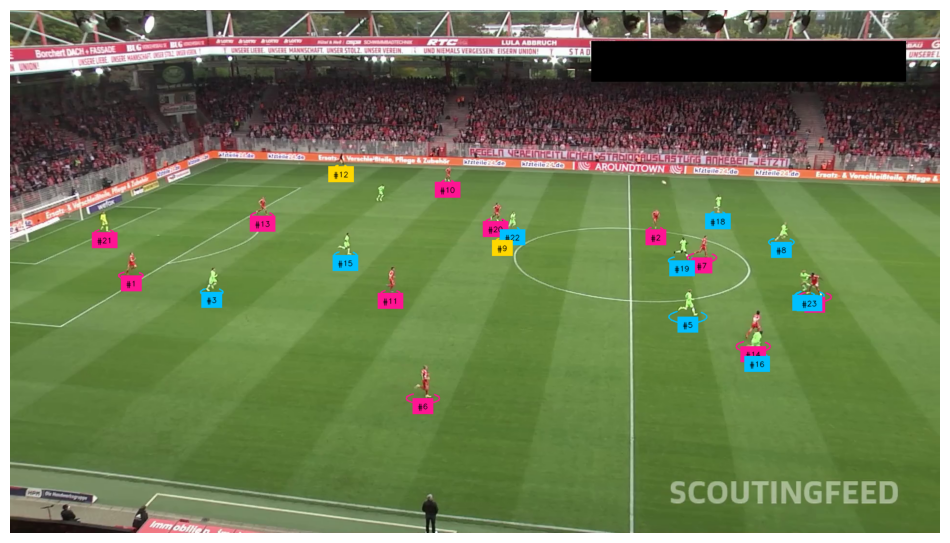


0: 384x640 1 pitch, 40.3ms
Speed: 2.3ms preprocess, 40.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


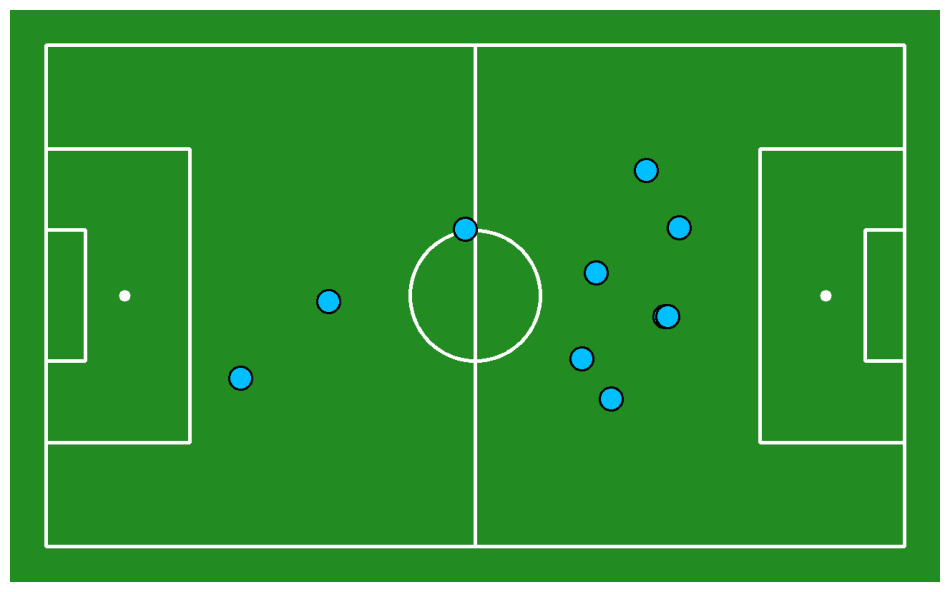

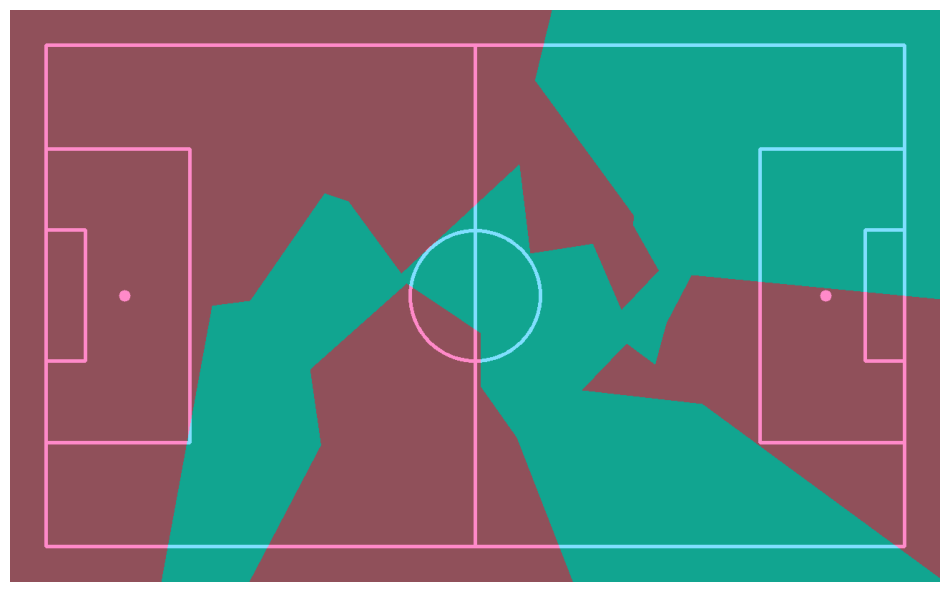

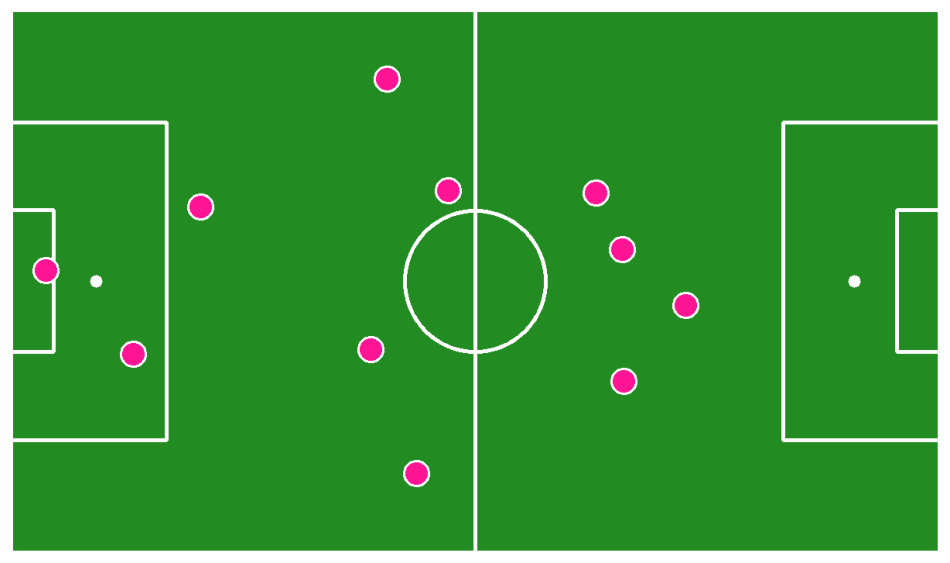

In [36]:
import numpy as np
import supervision as sv
from ultralytics import YOLO
from tqdm import tqdm
from sports.annotators.soccer import (
    draw_pitch,
    draw_points_on_pitch,
    draw_pitch_voronoi_diagram,
    # draw_pitch_voronoi_diagram_2
)

# === Load Models ===
detection_model = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")  # YOLOv8 detection model
keypoint_model = YOLO("/content/runs_pitch/content/runs/pose/train/weights/best.pt")  # Custom keypoint model

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID, GOALKEEPER_ID, PLAYER_ID, REFEREE_ID = 0, 1, 2, 3

# === Annotators ===
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

# === Tracker ===
tracker = sv.ByteTrack()
tracker.reset()

# === First Frame ===
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# === Object Detection ===
results = detection_model(frame)[0]
detections = sv.Detections.from_ultralytics(results)

ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections = tracker.update_with_detections(detections=all_detections)

goalkeepers_detections = all_detections[all_detections.class_id == GOALKEEPER_ID]
players_detections = all_detections[all_detections.class_id == PLAYER_ID]
referees_detections = all_detections[all_detections.class_id == REFEREE_ID]

# === Team Classification & Goalkeeper Assignment (Assume your team_classifier & resolve_goalkeepers_team_id are defined) ===
players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
players_detections.class_id = team_classifier.predict(players_crops)
goalkeepers_detections.class_id = resolve_goalkeepers_team_id(players_detections, goalkeepers_detections)
referees_detections.class_id -= 1

# === Merge All Detections ===
all_detections = sv.Detections.merge([
    players_detections, goalkeepers_detections, referees_detections
])

# === Annotate on Frame ===
labels = [f"#{tracker_id}" for tracker_id in all_detections.tracker_id]
all_detections.class_id = all_detections.class_id.astype(int)

annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(annotated_frame, all_detections)
annotated_frame = label_annotator.annotate(annotated_frame, all_detections, labels)
annotated_frame = triangle_annotator.annotate(annotated_frame, ball_detections)

sv.plot_image(annotated_frame)

# === Merge Players and Goalkeepers for Projection ===
players_detections = sv.Detections.merge([players_detections, goalkeepers_detections])

# === Replace FIELD_DETECTION_MODEL with Custom Keypoint Model ===
keypoint_results = keypoint_model.predict(source=frame, conf=0.3)
confidence = keypoint_results[0].keypoints.conf[0].cpu().numpy()
coordinates = keypoint_results[0].keypoints.xy[0].cpu().numpy()

mask = confidence > 0.5
filtered_coordinates = coordinates[mask]
frame_reference_key_points = sv.KeyPoints(xy=np.expand_dims(filtered_coordinates, axis=0))

frame_reference_points = filtered_coordinates
pitch_reference_points = np.array(CONFIG.vertices)[mask]

# === Perspective Transformation ===
transformer = ViewTransformer(
    source=frame_reference_points,
    target=pitch_reference_points
)

frame_ball_xy = ball_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_ball_xy = transformer.transform_points(points=frame_ball_xy)

players_xy = players_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_players_xy = transformer.transform_points(points=players_xy)

referees_xy = referees_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_referees_xy = transformer.transform_points(points=referees_xy)

# === Radar View ===
annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_mpoints_on_pitch(CONFIG, pitch_ball_xy, sv.Color.WHITE, sv.Color.BLACK, 10, annotated_frame)
annotated_frame = draw_mpoints_on_pitch(CONFIG, pitch_players_xy[players_detections.class_id == 0],
                                       sv.Color.from_hex('00BFFF'), sv.Color.BLACK, 16, annotated_frame)
# annotated_frame = draw_mpoints_on_pitch(CONFIG, pitch_players_xy[players_detections.class_id == 1],
#                                        sv.Color.from_hex('FF1493'), sv.Color.BLACK, 16, annotated_frame)
# annotated_frame = draw_mpoints_on_pitch(CONFIG, pitch_referees_xy,
#                                        sv.Color.from_hex('FFD700'), sv.Color.BLACK, 16, annotated_frame)

sv.plot_image(annotated_frame)

# === Voronoi Diagram ===
annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_pitch_voronoi_diagram(
    config=CONFIG,
    team_1_xy=pitch_players_xy[players_detections.class_id == 0],
    team_2_xy=pitch_players_xy[players_detections.class_id == 1],
    team_1_color=sv.Color.from_hex('00BFFF'),
    team_2_color=sv.Color.from_hex('FF1493'),
    pitch=annotated_frame)
sv.plot_image(annotated_frame)

# === Voronoi with Blend ===
annotated_frame = draw_pitch(CONFIG, background_color=sv.Color.WHITE, line_color=sv.Color.BLACK)
annotated_frame = draw_pitch_voronoi_diagram_2(
    config=CONFIG,
    team_1_xy=pitch_players_xy[players_detections.class_id == 0],
    team_2_xy=pitch_players_xy[players_detections.class_id == 1],
    team_1_color=sv.Color.from_hex('00BFFF'),
    team_2_color=sv.Color.from_hex('FF1493'),
    pitch=annotated_frame)
annotated_frame = draw_mpoints_on_pitch(CONFIG, pitch_ball_xy, sv.Color.WHITE, sv.Color.WHITE, 8, annotated_frame, 1)
annotated_frame = draw_mpoints_on_pitch(CONFIG, pitch_players_xy[players_detections.class_id == 0],
                                       sv.Color.from_hex('00BFFF'), sv.Color.WHITE, 16, annotated_frame, 1)
annotated_frame = draw_mpoints_on_pitch(CONFIG, pitch_players_xy[players_detections.class_id == 1],
                                       sv.Color.from_hex('FF1493'), sv.Color.WHITE, 16, annotated_frame, 1)

sv.plot_image(annotated_frame)


## ball tracking

In [37]:
from collections import deque
import numpy as np
import supervision as sv
from ultralytics import YOLO
from tqdm import tqdm
from sports.annotators.soccer import draw_pitch, draw_points_on_pitch

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
MAXLEN = 5

# Load models
PLAYER_DETECTION_MODEL = YOLO("/content/runs/content/runs/detect/train3/weights/best.pt")
KEYPOINT_MODEL = YOLO("/content/runs_pitch/content/runs/pose/train/weights/best.pt")

video_info = sv.VideoInfo.from_video_path(SOURCE_VIDEO_PATH)
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

path_raw = []
M = deque(maxlen=MAXLEN)

for frame in tqdm(frame_generator, total=video_info.total_frames):

    # --- Ball Detection ---
    result = PLAYER_DETECTION_MODEL(frame)[0]
    detections = sv.Detections.from_ultralytics(result)

    ball_detections = detections[detections.class_id == BALL_ID]
    ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

    # --- Keypoint Detection using custom model ---
    kp_result = KEYPOINT_MODEL.predict(source=frame, conf=0.3)[0]
    confidence = kp_result.keypoints.conf[0].cpu().numpy()
    coordinates = kp_result.keypoints.xy[0].cpu().numpy()

    mask = confidence > 0.5
    frame_reference_points = coordinates[mask]
    pitch_reference_points = np.array(CONFIG.vertices)[mask]

    # --- View Transformer ---
    transformer = ViewTransformer(
        source=frame_reference_points,
        target=pitch_reference_points
    )
    M.append(transformer.m)
    transformer.m = np.mean(np.array(M), axis=0)

    # --- Ball projection to pitch ---
    frame_ball_xy = ball_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    pitch_ball_xy = transformer.transform_points(points=frame_ball_xy)

    path_raw.append(pitch_ball_xy)


  0%|          | 0/750 [00:00<?, ?it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 61.6ms
Speed: 5.4ms preprocess, 61.6ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 42.5ms
Speed: 3.5ms preprocess, 42.5ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)


  0%|          | 1/750 [00:02<33:28,  2.68s/it]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 38.3ms
Speed: 6.7ms preprocess, 38.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.9ms preprocess, 37.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


  0%|          | 2/750 [00:02<14:42,  1.18s/it]


0: 384x640 20 players, 2 referees, 32.5ms
Speed: 3.9ms preprocess, 32.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.5ms
Speed: 3.7ms preprocess, 33.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 31.1ms
Speed: 3.7ms preprocess, 31.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.4ms
Speed: 3.7ms preprocess, 33.4ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 4/750 [00:03<06:14,  1.99it/s]


0: 384x640 1 ball, 1 goalkeeper, 21 players, 1 referee, 31.1ms
Speed: 3.6ms preprocess, 31.1ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.5ms
Speed: 4.2ms preprocess, 33.5ms inference, 4.3ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 5/750 [00:03<04:43,  2.62it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 31.5ms
Speed: 3.7ms preprocess, 31.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 4.2ms preprocess, 35.1ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 6/750 [00:03<03:40,  3.37it/s]


0: 384x640 1 ball, 1 goalkeeper, 22 players, 1 referee, 30.2ms
Speed: 4.1ms preprocess, 30.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 32.9ms
Speed: 3.8ms preprocess, 32.9ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 7/750 [00:03<02:57,  4.18it/s]


0: 384x640 1 goalkeeper, 18 players, 1 referee, 30.2ms
Speed: 3.6ms preprocess, 30.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.2ms preprocess, 35.2ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 8/750 [00:03<02:28,  4.98it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 32.9ms
Speed: 3.5ms preprocess, 32.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 3.0ms preprocess, 34.7ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 9/750 [00:03<02:07,  5.81it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 32.1ms
Speed: 3.2ms preprocess, 32.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.3ms preprocess, 35.3ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


  1%|▏         | 10/750 [00:03<01:52,  6.59it/s]


0: 384x640 1 goalkeeper, 21 players, 37.7ms
Speed: 4.4ms preprocess, 37.7ms inference, 5.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 32.8ms
Speed: 4.0ms preprocess, 32.8ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


  1%|▏         | 11/750 [00:03<01:45,  7.02it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 30.6ms
Speed: 6.8ms preprocess, 30.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.9ms preprocess, 36.3ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 12/750 [00:03<01:38,  7.46it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 30.2ms
Speed: 4.0ms preprocess, 30.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.7ms
Speed: 3.7ms preprocess, 33.7ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 13/750 [00:04<01:33,  7.84it/s]


0: 384x640 1 goalkeeper, 18 players, 31.5ms
Speed: 3.4ms preprocess, 31.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 32.9ms
Speed: 3.1ms preprocess, 32.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 1 referee, 35.8ms
Speed: 6.4ms preprocess, 35.8ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.1ms
Speed: 3.5ms preprocess, 33.1ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 15/750 [00:04<01:26,  8.47it/s]


0: 384x640 20 players, 1 referee, 31.4ms
Speed: 3.5ms preprocess, 31.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.2ms preprocess, 34.4ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 16/750 [00:04<01:24,  8.64it/s]


0: 384x640 1 ball, 1 goalkeeper, 20 players, 30.8ms
Speed: 3.6ms preprocess, 30.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 3.2ms preprocess, 33.8ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 17/750 [00:04<01:22,  8.91it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.2ms
Speed: 3.6ms preprocess, 31.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.3ms
Speed: 4.9ms preprocess, 33.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.8ms
Speed: 4.2ms preprocess, 32.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 3.0ms preprocess, 35.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 19/750 [00:04<01:17,  9.48it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.7ms
Speed: 3.4ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.2ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 2.8ms preprocess, 35.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 21/750 [00:04<01:12, 10.01it/s]


0: 384x640 1 ball, 1 goalkeeper, 20 players, 2 referees, 30.3ms
Speed: 3.3ms preprocess, 30.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.7ms
Speed: 3.0ms preprocess, 33.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 32.9ms
Speed: 3.2ms preprocess, 32.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.1ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 23/750 [00:04<01:12, 10.09it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 33.4ms
Speed: 3.2ms preprocess, 33.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 2.9ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 17 players, 2 referees, 32.0ms
Speed: 3.4ms preprocess, 32.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 2.9ms preprocess, 36.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 25/750 [00:05<01:10, 10.32it/s]


0: 384x640 1 goalkeeper, 17 players, 2 referees, 33.1ms
Speed: 3.3ms preprocess, 33.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 2.8ms preprocess, 34.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 33.1ms
Speed: 3.5ms preprocess, 33.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.0ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  4%|▎         | 27/750 [00:05<01:09, 10.46it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.0ms
Speed: 3.1ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 3.1ms preprocess, 34.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 2.7ms preprocess, 36.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 29/750 [00:05<01:08, 10.57it/s]


0: 384x640 1 goalkeeper, 23 players, 2 referees, 31.7ms
Speed: 4.8ms preprocess, 31.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.9ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.5ms
Speed: 5.8ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 2.1ms preprocess, 33.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 31/750 [00:05<01:07, 10.62it/s]


0: 384x640 1 goalkeeper, 22 players, 2 referees, 32.7ms
Speed: 3.5ms preprocess, 32.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 2.9ms preprocess, 36.4ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.0ms
Speed: 3.3ms preprocess, 33.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.0ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 33/750 [00:05<01:06, 10.71it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.0ms
Speed: 3.3ms preprocess, 33.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.0ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 32.9ms
Speed: 3.4ms preprocess, 32.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.3ms preprocess, 34.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 35/750 [00:06<01:06, 10.75it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 32.9ms
Speed: 3.4ms preprocess, 32.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.0ms preprocess, 35.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 32.5ms
Speed: 5.3ms preprocess, 32.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 2.2ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 37/750 [00:06<01:06, 10.76it/s]


0: 384x640 1 ball, 1 goalkeeper, 19 players, 1 referee, 33.9ms
Speed: 3.1ms preprocess, 33.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.1ms
Speed: 4.7ms preprocess, 33.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 32.4ms
Speed: 3.4ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.5ms preprocess, 35.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


  5%|▌         | 39/750 [00:06<01:06, 10.66it/s]


0: 384x640 1 ball, 21 players, 2 referees, 32.6ms
Speed: 3.4ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 2.8ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 34.4ms
Speed: 3.4ms preprocess, 34.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.5ms preprocess, 35.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  5%|▌         | 41/750 [00:06<01:06, 10.73it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 32.6ms
Speed: 3.3ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.2ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 33.6ms
Speed: 3.3ms preprocess, 33.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 43/750 [00:06<01:05, 10.83it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 32.3ms
Speed: 3.6ms preprocess, 32.3ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 5.7ms preprocess, 34.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 19 players, 2 referees, 33.4ms
Speed: 3.7ms preprocess, 33.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.5ms
Speed: 2.7ms preprocess, 34.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 45/750 [00:07<01:05, 10.83it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.5ms
Speed: 3.3ms preprocess, 31.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.3ms preprocess, 36.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.0ms
Speed: 3.3ms preprocess, 33.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.7ms
Speed: 3.1ms preprocess, 34.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


  6%|▋         | 47/750 [00:07<01:04, 10.82it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.8ms
Speed: 3.2ms preprocess, 31.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.3ms
Speed: 2.2ms preprocess, 35.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.8ms
Speed: 3.3ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 3.0ms preprocess, 34.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 49/750 [00:07<01:05, 10.77it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 33.3ms
Speed: 3.2ms preprocess, 33.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.1ms
Speed: 3.1ms preprocess, 34.1ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 1 referee, 32.4ms
Speed: 3.3ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 2.5ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 51/750 [00:07<01:04, 10.76it/s]


0: 384x640 21 players, 2 referees, 33.4ms
Speed: 4.8ms preprocess, 33.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 3.3ms preprocess, 33.8ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 35.0ms
Speed: 3.1ms preprocess, 35.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.1ms preprocess, 34.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 53/750 [00:07<01:05, 10.62it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 30.9ms
Speed: 4.7ms preprocess, 30.9ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.1ms
Speed: 3.6ms preprocess, 34.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 4.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.5ms preprocess, 34.4ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 55/750 [00:07<01:06, 10.40it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 31.5ms
Speed: 3.2ms preprocess, 31.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.1ms
Speed: 3.2ms preprocess, 36.1ms inference, 4.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 32.6ms
Speed: 3.6ms preprocess, 32.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.7ms
Speed: 3.6ms preprocess, 33.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 57/750 [00:08<01:06, 10.46it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.3ms
Speed: 3.1ms preprocess, 32.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.3ms preprocess, 35.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 19 players, 2 referees, 32.9ms
Speed: 4.9ms preprocess, 32.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.3ms
Speed: 3.5ms preprocess, 33.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 59/750 [00:08<01:07, 10.22it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 31.0ms
Speed: 3.1ms preprocess, 31.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.7ms
Speed: 3.4ms preprocess, 37.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 30.5ms
Speed: 3.1ms preprocess, 30.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.1ms
Speed: 3.2ms preprocess, 36.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 61/750 [00:08<01:09,  9.91it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 31.5ms
Speed: 3.5ms preprocess, 31.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.9ms
Speed: 3.3ms preprocess, 36.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 62/750 [00:08<01:09,  9.86it/s]


0: 384x640 1 ball, 1 goalkeeper, 20 players, 2 referees, 32.0ms
Speed: 3.2ms preprocess, 32.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.3ms
Speed: 3.7ms preprocess, 35.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 32.7ms
Speed: 3.7ms preprocess, 32.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.7ms
Speed: 3.7ms preprocess, 34.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


  9%|▊         | 64/750 [00:08<01:07, 10.18it/s]


0: 384x640 1 ball, 1 goalkeeper, 20 players, 1 referee, 33.6ms
Speed: 3.7ms preprocess, 33.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.8ms
Speed: 2.9ms preprocess, 36.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 17 players, 1 referee, 34.0ms
Speed: 3.4ms preprocess, 34.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 39.2ms
Speed: 3.4ms preprocess, 39.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 66/750 [00:09<01:06, 10.30it/s]


0: 384x640 17 players, 1 referee, 32.5ms
Speed: 3.7ms preprocess, 32.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.6ms
Speed: 3.8ms preprocess, 34.6ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 1 referee, 33.0ms
Speed: 3.3ms preprocess, 33.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 3.9ms preprocess, 35.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 68/750 [00:09<01:06, 10.28it/s]


0: 384x640 18 players, 1 referee, 31.7ms
Speed: 3.5ms preprocess, 31.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 3.4ms preprocess, 35.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 34.4ms
Speed: 3.4ms preprocess, 34.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.0ms
Speed: 3.3ms preprocess, 35.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 70/750 [00:09<01:06, 10.26it/s]


0: 384x640 18 players, 2 referees, 35.3ms
Speed: 3.5ms preprocess, 35.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 32.8ms
Speed: 3.4ms preprocess, 32.8ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 17 players, 2 referees, 34.5ms
Speed: 4.6ms preprocess, 34.5ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.8ms
Speed: 5.3ms preprocess, 33.8ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 72/750 [00:09<01:06, 10.14it/s]


0: 384x640 19 players, 2 referees, 32.8ms
Speed: 3.6ms preprocess, 32.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.0ms
Speed: 3.9ms preprocess, 37.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 33.1ms
Speed: 4.9ms preprocess, 33.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 3.0ms preprocess, 34.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 74/750 [00:09<01:05, 10.30it/s]


0: 384x640 19 players, 2 referees, 33.3ms
Speed: 3.1ms preprocess, 33.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.1ms
Speed: 3.2ms preprocess, 34.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 31.8ms
Speed: 3.1ms preprocess, 31.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.0ms
Speed: 3.3ms preprocess, 35.0ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 10%|█         | 76/750 [00:10<01:05, 10.24it/s]


0: 384x640 18 players, 2 referees, 31.3ms
Speed: 4.9ms preprocess, 31.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.9ms
Speed: 3.9ms preprocess, 33.9ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 30.4ms
Speed: 7.7ms preprocess, 30.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 3.1ms preprocess, 34.3ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 10%|█         | 78/750 [00:10<01:08,  9.83it/s]


0: 384x640 18 players, 2 referees, 32.3ms
Speed: 4.4ms preprocess, 32.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 4.0ms preprocess, 35.2ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 79/750 [00:10<01:08,  9.85it/s]


0: 384x640 17 players, 2 referees, 32.6ms
Speed: 3.2ms preprocess, 32.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 4.1ms preprocess, 35.4ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 32.3ms
Speed: 3.1ms preprocess, 32.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.2ms
Speed: 4.3ms preprocess, 34.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 81/750 [00:10<01:06, 10.06it/s]


0: 384x640 18 players, 2 referees, 34.2ms
Speed: 3.5ms preprocess, 34.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.7ms
Speed: 3.2ms preprocess, 34.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.7ms
Speed: 3.4ms preprocess, 32.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.0ms
Speed: 4.3ms preprocess, 37.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 83/750 [00:10<01:04, 10.26it/s]


0: 384x640 19 players, 2 referees, 32.6ms
Speed: 3.6ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 3.3ms preprocess, 34.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.5ms
Speed: 3.2ms preprocess, 33.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.3ms
Speed: 3.3ms preprocess, 35.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 11%|█▏        | 85/750 [00:10<01:04, 10.38it/s]


0: 384x640 18 players, 2 referees, 32.5ms
Speed: 3.4ms preprocess, 32.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.0ms
Speed: 3.9ms preprocess, 36.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.6ms
Speed: 3.5ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.7ms
Speed: 3.6ms preprocess, 33.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 87/750 [00:11<01:03, 10.48it/s]


0: 384x640 20 players, 2 referees, 31.1ms
Speed: 11.2ms preprocess, 31.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.0ms
Speed: 3.0ms preprocess, 34.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.6ms
Speed: 3.9ms preprocess, 33.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.1ms
Speed: 3.6ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 89/750 [00:11<01:03, 10.42it/s]


0: 384x640 19 players, 2 referees, 31.8ms
Speed: 3.6ms preprocess, 31.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 5.2ms preprocess, 34.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.5ms
Speed: 3.9ms preprocess, 33.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.5ms
Speed: 3.4ms preprocess, 33.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 91/750 [00:11<01:02, 10.50it/s]


0: 384x640 19 players, 2 referees, 31.4ms
Speed: 3.4ms preprocess, 31.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.7ms
Speed: 3.1ms preprocess, 36.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.6ms
Speed: 4.7ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.6ms
Speed: 3.4ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 93/750 [00:11<01:02, 10.51it/s]


0: 384x640 20 players, 2 referees, 33.1ms
Speed: 3.7ms preprocess, 33.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.3ms
Speed: 3.5ms preprocess, 35.3ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.4ms
Speed: 4.1ms preprocess, 32.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.4ms
Speed: 4.4ms preprocess, 36.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 95/750 [00:11<01:02, 10.52it/s]


0: 384x640 19 players, 2 referees, 31.7ms
Speed: 3.4ms preprocess, 31.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.7ms
Speed: 3.3ms preprocess, 36.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 32.5ms
Speed: 4.9ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.9ms
Speed: 3.8ms preprocess, 33.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 97/750 [00:12<01:02, 10.47it/s]


0: 384x640 18 players, 1 referee, 32.4ms
Speed: 3.5ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 3.0ms preprocess, 34.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 1 referee, 32.9ms
Speed: 3.3ms preprocess, 32.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.8ms
Speed: 3.3ms preprocess, 33.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 99/750 [00:12<01:02, 10.38it/s]


0: 384x640 19 players, 1 referee, 33.2ms
Speed: 3.3ms preprocess, 33.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.7ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.5ms
Speed: 5.2ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.6ms
Speed: 2.7ms preprocess, 33.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 101/750 [00:12<01:01, 10.52it/s]


0: 384x640 20 players, 2 referees, 32.4ms
Speed: 3.2ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 2.9ms preprocess, 35.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.4ms
Speed: 3.4ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.5ms
Speed: 3.2ms preprocess, 34.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▎        | 103/750 [00:12<01:01, 10.60it/s]


0: 384x640 21 players, 2 referees, 32.9ms
Speed: 3.3ms preprocess, 32.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.5ms
Speed: 2.9ms preprocess, 34.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.4ms
Speed: 3.2ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.4ms
Speed: 3.8ms preprocess, 36.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 105/750 [00:12<01:01, 10.53it/s]


0: 384x640 20 players, 1 referee, 32.1ms
Speed: 3.8ms preprocess, 32.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.9ms
Speed: 4.5ms preprocess, 34.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 33.8ms
Speed: 3.9ms preprocess, 33.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.6ms
Speed: 3.8ms preprocess, 34.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 107/750 [00:13<01:01, 10.54it/s]


0: 384x640 20 players, 2 referees, 31.4ms
Speed: 3.8ms preprocess, 31.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 3.7ms preprocess, 35.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 32.6ms
Speed: 3.7ms preprocess, 32.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.1ms
Speed: 3.3ms preprocess, 38.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▍        | 109/750 [00:13<01:01, 10.41it/s]


0: 384x640 18 players, 2 referees, 30.5ms
Speed: 3.4ms preprocess, 30.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.2ms
Speed: 3.2ms preprocess, 34.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.1ms
Speed: 4.1ms preprocess, 33.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 3.6ms preprocess, 35.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▍        | 111/750 [00:13<01:01, 10.32it/s]


0: 384x640 1 ball, 20 players, 2 referees, 32.6ms
Speed: 4.1ms preprocess, 32.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.1ms
Speed: 3.9ms preprocess, 34.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.7ms
Speed: 9.0ms preprocess, 32.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.8ms
Speed: 3.3ms preprocess, 34.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 113/750 [00:13<01:01, 10.38it/s]


0: 384x640 22 players, 2 referees, 31.8ms
Speed: 3.6ms preprocess, 31.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 2.9ms preprocess, 35.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.6ms
Speed: 3.7ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 3.2ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 115/750 [00:13<01:00, 10.43it/s]


0: 384x640 20 players, 2 referees, 33.1ms
Speed: 3.7ms preprocess, 33.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.1ms
Speed: 3.4ms preprocess, 34.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.1ms
Speed: 3.5ms preprocess, 32.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.9ms
Speed: 3.3ms preprocess, 34.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 117/750 [00:13<01:00, 10.42it/s]


0: 384x640 20 players, 2 referees, 32.6ms
Speed: 3.5ms preprocess, 32.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.1ms
Speed: 3.3ms preprocess, 35.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.5ms
Speed: 3.2ms preprocess, 33.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.8ms
Speed: 4.1ms preprocess, 33.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 119/750 [00:14<00:59, 10.55it/s]


0: 384x640 21 players, 3 referees, 33.2ms
Speed: 3.8ms preprocess, 33.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.1ms
Speed: 4.6ms preprocess, 37.1ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 32.1ms
Speed: 3.9ms preprocess, 32.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.8ms
Speed: 3.5ms preprocess, 34.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 121/750 [00:14<01:00, 10.46it/s]


0: 384x640 19 players, 1 referee, 32.3ms
Speed: 4.6ms preprocess, 32.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.2ms
Speed: 3.4ms preprocess, 34.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.9ms
Speed: 3.8ms preprocess, 33.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.0ms
Speed: 3.8ms preprocess, 35.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▋        | 123/750 [00:14<00:59, 10.51it/s]


0: 384x640 20 players, 2 referees, 32.1ms
Speed: 4.3ms preprocess, 32.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.5ms
Speed: 3.3ms preprocess, 36.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 31.9ms
Speed: 3.7ms preprocess, 31.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.4ms
Speed: 4.8ms preprocess, 36.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 125/750 [00:14<01:00, 10.41it/s]


0: 384x640 20 players, 2 referees, 30.8ms
Speed: 6.5ms preprocess, 30.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 3.0ms preprocess, 35.7ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.0ms
Speed: 3.6ms preprocess, 32.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 3.2ms preprocess, 35.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 127/750 [00:14<01:00, 10.26it/s]


0: 384x640 22 players, 2 referees, 32.6ms
Speed: 4.6ms preprocess, 32.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 33.9ms
Speed: 4.4ms preprocess, 33.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.1ms
Speed: 3.7ms preprocess, 33.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.4ms
Speed: 3.5ms preprocess, 34.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 129/750 [00:15<01:00, 10.31it/s]


0: 384x640 20 players, 2 referees, 31.4ms
Speed: 3.9ms preprocess, 31.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.5ms
Speed: 4.1ms preprocess, 34.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 33.5ms
Speed: 3.8ms preprocess, 33.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.1ms
Speed: 6.4ms preprocess, 36.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 131/750 [00:15<01:00, 10.27it/s]


0: 384x640 20 players, 1 referee, 31.4ms
Speed: 3.3ms preprocess, 31.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.4ms
Speed: 2.6ms preprocess, 36.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 32.6ms
Speed: 5.4ms preprocess, 32.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 3.5ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 133/750 [00:15<01:00, 10.24it/s]


0: 384x640 1 ball, 21 players, 2 referees, 32.2ms
Speed: 2.9ms preprocess, 32.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 3.8ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 21 players, 2 referees, 33.2ms
Speed: 3.4ms preprocess, 33.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.5ms
Speed: 3.2ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 135/750 [00:15<00:59, 10.29it/s]


0: 384x640 1 ball, 22 players, 2 referees, 31.9ms
Speed: 3.4ms preprocess, 31.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.6ms preprocess, 35.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 2 referees, 33.1ms
Speed: 4.2ms preprocess, 33.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.9ms preprocess, 34.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 137/750 [00:15<00:59, 10.37it/s]


0: 384x640 19 players, 2 referees, 33.1ms
Speed: 4.7ms preprocess, 33.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 6.0ms preprocess, 34.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 19 players, 2 referees, 32.5ms
Speed: 3.6ms preprocess, 32.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.4ms preprocess, 36.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▊        | 139/750 [00:16<00:58, 10.39it/s]


0: 384x640 19 players, 2 referees, 31.4ms
Speed: 4.1ms preprocess, 31.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.9ms preprocess, 36.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.7ms
Speed: 4.0ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.6ms preprocess, 35.7ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 141/750 [00:16<00:59, 10.30it/s]


0: 384x640 1 ball, 21 players, 2 referees, 34.1ms
Speed: 3.1ms preprocess, 34.1ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.4ms
Speed: 4.9ms preprocess, 33.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 21 players, 2 referees, 32.7ms
Speed: 3.3ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.3ms preprocess, 36.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 143/750 [00:16<00:58, 10.43it/s]


0: 384x640 22 players, 2 referees, 31.9ms
Speed: 3.6ms preprocess, 31.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.2ms preprocess, 36.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 23 players, 1 referee, 32.6ms
Speed: 3.2ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.9ms
Speed: 2.8ms preprocess, 33.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 145/750 [00:16<00:57, 10.45it/s]


0: 384x640 1 ball, 21 players, 1 referee, 32.3ms
Speed: 3.7ms preprocess, 32.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.4ms preprocess, 34.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 32.7ms
Speed: 4.5ms preprocess, 32.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 4.0ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 20%|█▉        | 147/750 [00:16<00:57, 10.47it/s]


0: 384x640 21 players, 1 referee, 32.5ms
Speed: 4.5ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.5ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 21 players, 1 referee, 34.2ms
Speed: 3.5ms preprocess, 34.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 2.5ms preprocess, 34.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 20%|█▉        | 149/750 [00:17<00:57, 10.50it/s]


0: 384x640 21 players, 2 referees, 32.0ms
Speed: 3.5ms preprocess, 32.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.8ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 31.9ms
Speed: 4.6ms preprocess, 31.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.1ms preprocess, 36.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 151/750 [00:17<00:57, 10.35it/s]


0: 384x640 20 players, 2 referees, 32.4ms
Speed: 3.8ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 4.1ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 1 referee, 32.8ms
Speed: 3.4ms preprocess, 32.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.1ms
Speed: 3.8ms preprocess, 34.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 153/750 [00:17<00:57, 10.42it/s]


0: 384x640 20 players, 2 referees, 33.2ms
Speed: 4.0ms preprocess, 33.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.5ms
Speed: 3.0ms preprocess, 37.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.1ms
Speed: 3.5ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.8ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 155/750 [00:17<00:56, 10.44it/s]


0: 384x640 2 balls, 18 players, 2 referees, 33.4ms
Speed: 3.4ms preprocess, 33.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.1ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.4ms
Speed: 3.2ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.1ms preprocess, 35.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 157/750 [00:17<00:56, 10.49it/s]


0: 384x640 21 players, 2 referees, 32.3ms
Speed: 3.1ms preprocess, 32.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.1ms preprocess, 37.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.7ms
Speed: 3.4ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 2.6ms preprocess, 34.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 159/750 [00:18<00:56, 10.53it/s]


0: 384x640 20 players, 2 referees, 33.3ms
Speed: 3.4ms preprocess, 33.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.4ms preprocess, 37.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 33.0ms
Speed: 3.4ms preprocess, 33.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.6ms preprocess, 34.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 21%|██▏       | 161/750 [00:18<00:55, 10.61it/s]


0: 384x640 20 players, 2 referees, 31.7ms
Speed: 2.8ms preprocess, 31.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.3ms
Speed: 3.4ms preprocess, 33.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.1ms
Speed: 3.2ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.7ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 163/750 [00:18<00:55, 10.49it/s]


0: 384x640 20 players, 2 referees, 32.9ms
Speed: 3.1ms preprocess, 32.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 5.7ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.2ms
Speed: 3.6ms preprocess, 32.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.2ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 165/750 [00:18<00:55, 10.51it/s]


0: 384x640 22 players, 2 referees, 32.4ms
Speed: 3.1ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.1ms
Speed: 3.4ms preprocess, 34.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.6ms
Speed: 3.2ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.0ms preprocess, 36.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 167/750 [00:18<00:55, 10.46it/s]


0: 384x640 20 players, 2 referees, 32.9ms
Speed: 3.1ms preprocess, 32.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.6ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.3ms
Speed: 3.8ms preprocess, 33.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.9ms
Speed: 3.1ms preprocess, 33.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 169/750 [00:18<00:55, 10.48it/s]


0: 384x640 21 players, 2 referees, 31.5ms
Speed: 3.2ms preprocess, 31.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.5ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 32.7ms
Speed: 3.4ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.0ms preprocess, 36.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 171/750 [00:19<00:55, 10.45it/s]


0: 384x640 20 players, 2 referees, 32.9ms
Speed: 3.4ms preprocess, 32.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 3.7ms preprocess, 34.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.4ms
Speed: 5.2ms preprocess, 32.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 4.9ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 173/750 [00:19<00:54, 10.53it/s]


0: 384x640 19 players, 2 referees, 32.3ms
Speed: 3.6ms preprocess, 32.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.5ms preprocess, 36.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.4ms
Speed: 3.5ms preprocess, 32.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.6ms preprocess, 36.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 175/750 [00:19<00:55, 10.45it/s]


0: 384x640 18 players, 2 referees, 33.1ms
Speed: 6.6ms preprocess, 33.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.6ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.5ms
Speed: 2.6ms preprocess, 32.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.1ms
Speed: 4.0ms preprocess, 34.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▎       | 177/750 [00:19<00:55, 10.38it/s]


0: 384x640 21 players, 2 referees, 33.4ms
Speed: 3.1ms preprocess, 33.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.6ms
Speed: 3.4ms preprocess, 36.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.7ms
Speed: 3.8ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.3ms preprocess, 34.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 179/750 [00:19<00:54, 10.48it/s]


0: 384x640 19 players, 2 referees, 32.4ms
Speed: 3.9ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.6ms preprocess, 34.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 33.4ms
Speed: 3.6ms preprocess, 33.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.3ms preprocess, 35.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 181/750 [00:20<00:54, 10.49it/s]


0: 384x640 21 players, 2 referees, 31.6ms
Speed: 3.6ms preprocess, 31.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 2.9ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.8ms
Speed: 4.0ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 3.3ms preprocess, 35.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 183/750 [00:20<00:54, 10.44it/s]


0: 384x640 20 players, 2 referees, 34.4ms
Speed: 3.6ms preprocess, 34.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.4ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.6ms
Speed: 6.2ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 2.8ms preprocess, 35.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▍       | 185/750 [00:20<00:53, 10.46it/s]


0: 384x640 22 players, 2 referees, 35.2ms
Speed: 4.6ms preprocess, 35.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 3.4ms preprocess, 34.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 30.2ms
Speed: 4.3ms preprocess, 30.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.6ms preprocess, 35.0ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▍       | 187/750 [00:20<00:55, 10.16it/s]


0: 384x640 18 players, 2 referees, 32.7ms
Speed: 3.4ms preprocess, 32.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 4.1ms preprocess, 36.3ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 21 players, 2 referees, 30.2ms
Speed: 5.8ms preprocess, 30.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.3ms preprocess, 35.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 189/750 [00:20<00:55, 10.19it/s]


0: 384x640 1 ball, 21 players, 2 referees, 30.9ms
Speed: 7.3ms preprocess, 30.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.0ms preprocess, 36.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.3ms
Speed: 3.2ms preprocess, 32.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.2ms preprocess, 35.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 191/750 [00:21<00:55, 10.06it/s]


0: 384x640 20 players, 1 referee, 31.1ms
Speed: 3.3ms preprocess, 31.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 3.0ms preprocess, 35.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 31.8ms
Speed: 3.4ms preprocess, 31.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.2ms preprocess, 36.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 193/750 [00:21<00:55, 10.05it/s]


0: 384x640 20 players, 2 referees, 31.3ms
Speed: 3.4ms preprocess, 31.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.1ms preprocess, 36.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 3 referees, 31.8ms
Speed: 4.4ms preprocess, 31.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.5ms preprocess, 35.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 195/750 [00:21<00:55,  9.98it/s]


0: 384x640 1 ball, 20 players, 2 referees, 31.8ms
Speed: 3.3ms preprocess, 31.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.3ms preprocess, 36.1ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 196/750 [00:21<00:55,  9.91it/s]


0: 384x640 1 ball, 20 players, 2 referees, 30.3ms
Speed: 3.6ms preprocess, 30.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.5ms preprocess, 35.3ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▋       | 197/750 [00:21<00:55,  9.88it/s]


0: 384x640 1 ball, 21 players, 2 referees, 31.8ms
Speed: 5.1ms preprocess, 31.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.5ms
Speed: 6.3ms preprocess, 33.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▋       | 198/750 [00:21<00:56,  9.82it/s]


0: 384x640 1 ball, 22 players, 1 referee, 33.2ms
Speed: 3.8ms preprocess, 33.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.1ms preprocess, 35.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 30.7ms
Speed: 7.6ms preprocess, 30.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.7ms
Speed: 4.7ms preprocess, 33.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 200/750 [00:22<00:55,  9.84it/s]


0: 384x640 1 ball, 20 players, 2 referees, 33.1ms
Speed: 3.7ms preprocess, 33.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 3.9ms preprocess, 36.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 30.7ms
Speed: 3.7ms preprocess, 30.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.6ms preprocess, 35.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 202/750 [00:22<00:55,  9.89it/s]


0: 384x640 1 ball, 19 players, 2 referees, 32.3ms
Speed: 4.5ms preprocess, 32.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.2ms preprocess, 36.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.9ms
Speed: 3.0ms preprocess, 32.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.4ms preprocess, 36.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 204/750 [00:22<00:54,  9.99it/s]


0: 384x640 1 ball, 23 players, 2 referees, 33.4ms
Speed: 3.8ms preprocess, 33.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 4.4ms preprocess, 34.4ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 22 players, 2 referees, 32.3ms
Speed: 3.3ms preprocess, 32.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 3.4ms preprocess, 34.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 206/750 [00:22<00:54,  9.97it/s]


0: 384x640 1 ball, 21 players, 2 referees, 34.2ms
Speed: 3.9ms preprocess, 34.2ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.3ms
Speed: 5.4ms preprocess, 33.3ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 207/750 [00:22<00:54,  9.95it/s]


0: 384x640 1 ball, 20 players, 2 referees, 32.5ms
Speed: 5.0ms preprocess, 32.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 3.2ms preprocess, 34.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 34.8ms
Speed: 3.4ms preprocess, 34.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.5ms
Speed: 3.3ms preprocess, 37.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 209/750 [00:22<00:53, 10.14it/s]


0: 384x640 1 ball, 18 players, 2 referees, 32.8ms
Speed: 6.3ms preprocess, 32.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.2ms preprocess, 37.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 18 players, 2 referees, 30.6ms
Speed: 3.7ms preprocess, 30.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.4ms preprocess, 35.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 211/750 [00:23<00:54,  9.92it/s]


0: 384x640 18 players, 2 referees, 35.1ms
Speed: 3.5ms preprocess, 35.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.3ms preprocess, 34.4ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 17 players, 2 referees, 33.3ms
Speed: 3.3ms preprocess, 33.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.5ms preprocess, 36.5ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 213/750 [00:23<00:53, 10.03it/s]


0: 384x640 18 players, 2 referees, 30.8ms
Speed: 3.3ms preprocess, 30.8ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.9ms
Speed: 3.3ms preprocess, 33.9ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 32.0ms
Speed: 3.4ms preprocess, 32.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.2ms preprocess, 35.7ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▊       | 215/750 [00:23<00:55,  9.72it/s]


0: 384x640 19 players, 1 referee, 32.4ms
Speed: 3.4ms preprocess, 32.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.3ms preprocess, 34.8ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 33.0ms
Speed: 3.9ms preprocess, 33.0ms inference, 6.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.4ms
Speed: 7.4ms preprocess, 33.4ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 217/750 [00:23<00:54,  9.85it/s]


0: 384x640 19 players, 2 referees, 33.2ms
Speed: 3.4ms preprocess, 33.2ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 7.6ms preprocess, 33.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 33.1ms
Speed: 6.1ms preprocess, 33.1ms inference, 5.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 3.8ms preprocess, 33.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 219/750 [00:23<00:53,  9.98it/s]


0: 384x640 19 players, 1 referee, 31.7ms
Speed: 4.3ms preprocess, 31.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 3.7ms preprocess, 33.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 220/750 [00:24<00:53,  9.97it/s]


0: 384x640 19 players, 2 referees, 32.0ms
Speed: 3.7ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 4.2ms preprocess, 35.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.3ms
Speed: 4.5ms preprocess, 32.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.4ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 222/750 [00:24<00:52, 10.07it/s]


0: 384x640 19 players, 2 referees, 32.4ms
Speed: 3.3ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.7ms preprocess, 37.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 1 referee, 32.9ms
Speed: 4.8ms preprocess, 32.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 5.4ms preprocess, 34.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 224/750 [00:24<00:52, 10.08it/s]


0: 384x640 21 players, 1 referee, 32.3ms
Speed: 3.9ms preprocess, 32.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 3.7ms preprocess, 36.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.5ms
Speed: 5.8ms preprocess, 32.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.2ms preprocess, 35.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 30%|███       | 226/750 [00:24<00:51, 10.09it/s]


0: 384x640 1 ball, 18 players, 2 referees, 35.0ms
Speed: 4.1ms preprocess, 35.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 3.8ms preprocess, 34.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 19 players, 2 referees, 32.9ms
Speed: 3.8ms preprocess, 32.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.8ms preprocess, 36.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 30%|███       | 228/750 [00:24<00:50, 10.25it/s]


0: 384x640 1 ball, 21 players, 2 referees, 30.6ms
Speed: 6.2ms preprocess, 30.6ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.5ms preprocess, 35.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 19 players, 2 referees, 30.8ms
Speed: 4.1ms preprocess, 30.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 5.3ms preprocess, 34.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 230/750 [00:25<00:51, 10.03it/s]


0: 384x640 1 ball, 21 players, 2 referees, 31.4ms
Speed: 4.1ms preprocess, 31.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.7ms preprocess, 35.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 33.4ms
Speed: 3.6ms preprocess, 33.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 4.8ms preprocess, 36.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 232/750 [00:25<00:51, 10.09it/s]


0: 384x640 21 players, 2 referees, 32.6ms
Speed: 3.4ms preprocess, 32.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.8ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 2 referees, 36.1ms
Speed: 3.3ms preprocess, 36.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.5ms preprocess, 37.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 234/750 [00:25<00:50, 10.31it/s]


0: 384x640 1 ball, 19 players, 2 referees, 32.0ms
Speed: 3.7ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 3.3ms preprocess, 33.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 24 players, 1 referee, 33.0ms
Speed: 4.0ms preprocess, 33.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.4ms preprocess, 34.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 31%|███▏      | 236/750 [00:25<00:50, 10.26it/s]


0: 384x640 22 players, 2 referees, 33.3ms
Speed: 4.0ms preprocess, 33.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.9ms preprocess, 35.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 33.0ms
Speed: 4.9ms preprocess, 33.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.8ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 238/750 [00:25<00:49, 10.27it/s]


0: 384x640 22 players, 2 referees, 32.2ms
Speed: 3.5ms preprocess, 32.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.6ms
Speed: 4.2ms preprocess, 36.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 31.3ms
Speed: 13.3ms preprocess, 31.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 3.4ms preprocess, 35.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 240/750 [00:26<00:50, 10.14it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 31.9ms
Speed: 3.6ms preprocess, 31.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 3.7ms preprocess, 35.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.2ms
Speed: 3.6ms preprocess, 33.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 4.2ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 242/750 [00:26<00:49, 10.25it/s]


0: 384x640 22 players, 2 referees, 35.3ms
Speed: 3.2ms preprocess, 35.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.8ms preprocess, 34.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 32.9ms
Speed: 3.1ms preprocess, 32.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.0ms
Speed: 3.1ms preprocess, 37.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 244/750 [00:26<00:48, 10.36it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 32.0ms
Speed: 7.5ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.0ms
Speed: 3.5ms preprocess, 37.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.1ms
Speed: 3.5ms preprocess, 33.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.6ms preprocess, 34.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 246/750 [00:26<00:48, 10.31it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 34.5ms
Speed: 3.5ms preprocess, 34.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.1ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.5ms
Speed: 3.1ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.7ms preprocess, 36.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 248/750 [00:26<00:48, 10.35it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 34.9ms
Speed: 3.8ms preprocess, 34.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 6.6ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.1ms
Speed: 3.6ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.2ms
Speed: 3.8ms preprocess, 38.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 250/750 [00:26<00:48, 10.25it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.3ms
Speed: 3.9ms preprocess, 33.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 4.3ms preprocess, 34.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 34.3ms
Speed: 3.6ms preprocess, 34.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.8ms preprocess, 36.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▎      | 252/750 [00:27<00:47, 10.42it/s]


0: 384x640 20 players, 1 referee, 31.9ms
Speed: 3.3ms preprocess, 31.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.2ms preprocess, 37.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 31.6ms
Speed: 3.8ms preprocess, 31.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.6ms preprocess, 36.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 254/750 [00:27<00:48, 10.27it/s]


0: 384x640 22 players, 2 referees, 32.9ms
Speed: 3.5ms preprocess, 32.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 3.3ms preprocess, 34.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 31.6ms
Speed: 3.5ms preprocess, 31.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 31.9ms
Speed: 3.2ms preprocess, 31.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 256/750 [00:27<00:47, 10.47it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 30.9ms
Speed: 3.3ms preprocess, 30.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 31.3ms
Speed: 3.8ms preprocess, 31.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 23 players, 2 referees, 32.4ms
Speed: 3.7ms preprocess, 32.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.6ms preprocess, 35.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 258/750 [00:27<00:47, 10.33it/s]


0: 384x640 1 goalkeeper, 24 players, 1 referee, 33.3ms
Speed: 3.4ms preprocess, 33.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 4.3ms preprocess, 33.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 33.1ms
Speed: 3.3ms preprocess, 33.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.2ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 260/750 [00:27<00:47, 10.41it/s]


0: 384x640 1 goalkeeper, 20 players, 3 referees, 31.9ms
Speed: 4.1ms preprocess, 31.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 4.1ms preprocess, 37.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 24 players, 2 referees, 30.6ms
Speed: 9.4ms preprocess, 30.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.1ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 262/750 [00:28<00:48, 10.16it/s]


0: 384x640 22 players, 1 referee, 31.9ms
Speed: 3.1ms preprocess, 31.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.5ms preprocess, 35.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 19 players, 2 referees, 33.6ms
Speed: 3.0ms preprocess, 33.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.6ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▌      | 264/750 [00:28<00:47, 10.32it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 32.0ms
Speed: 6.1ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.6ms
Speed: 4.1ms preprocess, 33.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 20 players, 2 referees, 31.6ms
Speed: 3.5ms preprocess, 31.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.3ms preprocess, 35.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▌      | 266/750 [00:28<00:47, 10.25it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 31.4ms
Speed: 3.2ms preprocess, 31.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 4.7ms preprocess, 35.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 1 referee, 32.1ms
Speed: 4.8ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.8ms preprocess, 36.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 268/750 [00:28<00:47, 10.23it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 31.8ms
Speed: 3.7ms preprocess, 31.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 4.2ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.9ms
Speed: 3.1ms preprocess, 32.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.6ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 270/750 [00:28<00:46, 10.26it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.1ms
Speed: 3.3ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.9ms
Speed: 3.3ms preprocess, 33.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.4ms
Speed: 3.5ms preprocess, 31.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 2.9ms preprocess, 35.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▋      | 272/750 [00:29<00:46, 10.30it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 32.0ms
Speed: 3.2ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.6ms
Speed: 3.9ms preprocess, 37.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.8ms
Speed: 6.8ms preprocess, 32.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.3ms preprocess, 36.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 274/750 [00:29<00:46, 10.18it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 32.7ms
Speed: 3.3ms preprocess, 32.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 5.0ms preprocess, 34.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 1 referee, 34.9ms
Speed: 3.3ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.2ms preprocess, 36.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 276/750 [00:29<00:45, 10.37it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.9ms
Speed: 3.9ms preprocess, 31.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 4.0ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 33.0ms
Speed: 3.3ms preprocess, 33.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.1ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 278/750 [00:29<00:45, 10.35it/s]


0: 384x640 20 players, 2 referees, 34.7ms
Speed: 3.3ms preprocess, 34.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.0ms preprocess, 35.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.0ms
Speed: 4.5ms preprocess, 33.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.5ms
Speed: 4.0ms preprocess, 37.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 280/750 [00:29<00:45, 10.44it/s]


0: 384x640 1 goalkeeper, 17 players, 2 referees, 32.0ms
Speed: 3.8ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.4ms preprocess, 36.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 17 players, 1 referee, 32.8ms
Speed: 3.2ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.5ms preprocess, 36.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 282/750 [00:30<00:45, 10.35it/s]


0: 384x640 1 ball, 1 goalkeeper, 18 players, 1 referee, 34.8ms
Speed: 3.5ms preprocess, 34.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 4.0ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 1 referee, 33.3ms
Speed: 3.2ms preprocess, 33.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.5ms preprocess, 36.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 284/750 [00:30<00:44, 10.39it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 32.1ms
Speed: 3.4ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.0ms preprocess, 36.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 22 players, 1 referee, 32.5ms
Speed: 3.1ms preprocess, 32.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 4.0ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 286/750 [00:30<00:44, 10.37it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 34.5ms
Speed: 3.2ms preprocess, 34.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 4.1ms preprocess, 34.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 19 players, 32.7ms
Speed: 3.3ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.6ms
Speed: 3.2ms preprocess, 37.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 288/750 [00:30<00:44, 10.46it/s]


0: 384x640 18 players, 31.7ms
Speed: 4.4ms preprocess, 31.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.2ms preprocess, 36.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.4ms
Speed: 3.8ms preprocess, 32.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.6ms preprocess, 36.4ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▊      | 290/750 [00:30<00:44, 10.27it/s]


0: 384x640 20 players, 2 referees, 30.8ms
Speed: 4.9ms preprocess, 30.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.9ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.5ms
Speed: 4.0ms preprocess, 33.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 4.1ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 292/750 [00:31<00:44, 10.25it/s]


0: 384x640 20 players, 2 referees, 34.5ms
Speed: 3.5ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.7ms preprocess, 35.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.9ms
Speed: 3.4ms preprocess, 32.9ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 2.9ms preprocess, 36.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 294/750 [00:31<00:44, 10.33it/s]


0: 384x640 21 players, 2 referees, 30.6ms
Speed: 2.3ms preprocess, 30.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.9ms preprocess, 35.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 2 referees, 31.9ms
Speed: 3.3ms preprocess, 31.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.3ms preprocess, 35.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 296/750 [00:31<00:44, 10.15it/s]


0: 384x640 18 players, 2 referees, 32.9ms
Speed: 3.5ms preprocess, 32.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 4.5ms preprocess, 34.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 18 players, 3 referees, 32.4ms
Speed: 3.5ms preprocess, 32.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 3.4ms preprocess, 36.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 40%|███▉      | 298/750 [00:31<00:44, 10.18it/s]


0: 384x640 18 players, 3 referees, 33.2ms
Speed: 3.4ms preprocess, 33.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.3ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 19 players, 2 referees, 31.8ms
Speed: 3.1ms preprocess, 31.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 3.8ms preprocess, 35.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 300/750 [00:31<00:43, 10.31it/s]


0: 384x640 1 ball, 20 players, 2 referees, 33.2ms
Speed: 4.2ms preprocess, 33.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.9ms preprocess, 37.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 3 referees, 32.8ms
Speed: 4.7ms preprocess, 32.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.1ms
Speed: 3.4ms preprocess, 34.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 302/750 [00:32<00:42, 10.42it/s]


0: 384x640 21 players, 2 referees, 32.0ms
Speed: 3.9ms preprocess, 32.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.7ms
Speed: 3.6ms preprocess, 33.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 31.8ms
Speed: 3.5ms preprocess, 31.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.8ms preprocess, 36.4ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 304/750 [00:32<00:43, 10.33it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 32.7ms
Speed: 3.5ms preprocess, 32.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.3ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 32.6ms
Speed: 4.4ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.6ms preprocess, 36.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 306/750 [00:32<00:42, 10.35it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.3ms
Speed: 7.8ms preprocess, 33.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.5ms preprocess, 34.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 32.3ms
Speed: 3.1ms preprocess, 32.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 4.6ms preprocess, 34.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 308/750 [00:32<00:42, 10.36it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.4ms
Speed: 3.4ms preprocess, 33.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.5ms preprocess, 36.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.9ms
Speed: 2.4ms preprocess, 31.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.1ms preprocess, 35.8ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 41%|████▏     | 310/750 [00:32<00:42, 10.24it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.2ms
Speed: 7.5ms preprocess, 32.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.4ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.6ms
Speed: 4.8ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.2ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 312/750 [00:32<00:42, 10.31it/s]


0: 384x640 21 players, 1 referee, 33.6ms
Speed: 3.7ms preprocess, 33.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.7ms preprocess, 36.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 33.4ms
Speed: 3.8ms preprocess, 33.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.9ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 314/750 [00:33<00:41, 10.48it/s]


0: 384x640 21 players, 1 referee, 35.6ms
Speed: 3.5ms preprocess, 35.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.1ms preprocess, 35.8ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 31.4ms
Speed: 3.1ms preprocess, 31.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.3ms preprocess, 35.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 316/750 [00:33<00:41, 10.46it/s]


0: 384x640 19 players, 2 referees, 31.1ms
Speed: 3.4ms preprocess, 31.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.6ms preprocess, 35.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 33.7ms
Speed: 3.3ms preprocess, 33.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.6ms
Speed: 3.4ms preprocess, 36.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 318/750 [00:33<00:41, 10.39it/s]


0: 384x640 18 players, 2 referees, 32.4ms
Speed: 3.5ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 3.5ms preprocess, 34.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 32.1ms
Speed: 5.3ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.4ms preprocess, 34.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 320/750 [00:33<00:41, 10.28it/s]


0: 384x640 19 players, 2 referees, 33.5ms
Speed: 3.6ms preprocess, 33.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 4.0ms preprocess, 35.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 18 players, 2 referees, 34.4ms
Speed: 3.5ms preprocess, 34.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 4.6ms preprocess, 34.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 322/750 [00:33<00:42, 10.13it/s]


0: 384x640 1 ball, 20 players, 2 referees, 33.3ms
Speed: 3.1ms preprocess, 33.3ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.2ms preprocess, 35.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 31.0ms
Speed: 3.2ms preprocess, 31.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 3.2ms preprocess, 35.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 324/750 [00:34<00:41, 10.20it/s]


0: 384x640 20 players, 2 referees, 32.4ms
Speed: 3.1ms preprocess, 32.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 3.0ms preprocess, 35.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 37.9ms
Speed: 3.4ms preprocess, 37.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 4.1ms preprocess, 34.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 326/750 [00:34<00:42,  9.97it/s]


0: 384x640 20 players, 2 referees, 32.7ms
Speed: 5.1ms preprocess, 32.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.1ms preprocess, 35.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▎     | 327/750 [00:34<00:42,  9.92it/s]


0: 384x640 20 players, 2 referees, 32.5ms
Speed: 3.5ms preprocess, 32.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.6ms preprocess, 36.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▎     | 328/750 [00:34<00:42,  9.89it/s]


0: 384x640 20 players, 2 referees, 32.7ms
Speed: 6.2ms preprocess, 32.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.2ms preprocess, 37.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 329/750 [00:34<00:43,  9.78it/s]


0: 384x640 20 players, 2 referees, 30.9ms
Speed: 9.2ms preprocess, 30.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.1ms preprocess, 34.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 330/750 [00:34<00:43,  9.62it/s]


0: 384x640 19 players, 1 referee, 32.8ms
Speed: 5.5ms preprocess, 32.8ms inference, 6.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 5.7ms preprocess, 34.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 331/750 [00:34<00:43,  9.67it/s]


0: 384x640 20 players, 1 referee, 31.1ms
Speed: 3.6ms preprocess, 31.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.2ms preprocess, 34.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 1 referee, 33.3ms
Speed: 4.5ms preprocess, 33.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.2ms
Speed: 3.8ms preprocess, 38.2ms inference, 7.3ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 333/750 [00:35<00:42,  9.82it/s]


0: 384x640 19 players, 2 referees, 30.8ms
Speed: 3.4ms preprocess, 30.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 4.9ms preprocess, 35.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▍     | 334/750 [00:35<00:42,  9.85it/s]


0: 384x640 20 players, 2 referees, 32.5ms
Speed: 4.5ms preprocess, 32.5ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.3ms preprocess, 36.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 30.7ms
Speed: 3.3ms preprocess, 30.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▍     | 336/750 [00:35<00:41,  9.88it/s]


0: 384x640 21 players, 2 referees, 36.6ms
Speed: 3.3ms preprocess, 36.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.1ms preprocess, 35.2ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▍     | 337/750 [00:35<00:43,  9.57it/s]


0: 384x640 20 players, 1 referee, 36.6ms
Speed: 4.1ms preprocess, 36.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.8ms preprocess, 34.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 338/750 [00:35<00:43,  9.44it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 31.6ms
Speed: 4.1ms preprocess, 31.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.9ms preprocess, 34.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 339/750 [00:35<00:43,  9.49it/s]


0: 384x640 1 ball, 1 goalkeeper, 20 players, 1 referee, 31.7ms
Speed: 3.5ms preprocess, 31.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 2.9ms preprocess, 35.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 340/750 [00:35<00:42,  9.56it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 34.7ms
Speed: 3.3ms preprocess, 34.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 3.4ms preprocess, 34.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 341/750 [00:35<00:42,  9.57it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 31.1ms
Speed: 9.7ms preprocess, 31.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.5ms
Speed: 3.1ms preprocess, 37.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 342/750 [00:36<00:43,  9.47it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 31.1ms
Speed: 3.9ms preprocess, 31.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.4ms preprocess, 35.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 343/750 [00:36<00:42,  9.56it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 32.6ms
Speed: 3.4ms preprocess, 32.6ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.7ms
Speed: 3.5ms preprocess, 33.7ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 344/750 [00:36<00:43,  9.42it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 40.8ms
Speed: 3.5ms preprocess, 40.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.9ms
Speed: 3.3ms preprocess, 33.9ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 345/750 [00:36<00:43,  9.30it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.3ms
Speed: 3.1ms preprocess, 31.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.5ms preprocess, 36.9ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 346/750 [00:36<00:43,  9.35it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 31.1ms
Speed: 3.2ms preprocess, 31.1ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.3ms preprocess, 35.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▋     | 347/750 [00:36<00:42,  9.43it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 32.7ms
Speed: 3.2ms preprocess, 32.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.1ms preprocess, 37.1ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▋     | 348/750 [00:36<00:42,  9.53it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 30.7ms
Speed: 3.3ms preprocess, 30.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.4ms preprocess, 34.8ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 17 players, 2 referees, 31.7ms
Speed: 6.5ms preprocess, 31.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.2ms preprocess, 35.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 350/750 [00:36<00:41,  9.64it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 31.5ms
Speed: 6.3ms preprocess, 31.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.7ms preprocess, 35.7ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 351/750 [00:36<00:42,  9.40it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 31.1ms
Speed: 3.8ms preprocess, 31.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.4ms preprocess, 34.6ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 352/750 [00:37<00:42,  9.40it/s]


0: 384x640 1 goalkeeper, 19 players, 31.8ms
Speed: 3.7ms preprocess, 31.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 5.4ms preprocess, 34.6ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 353/750 [00:37<00:42,  9.27it/s]


0: 384x640 1 goalkeeper, 19 players, 32.4ms
Speed: 3.2ms preprocess, 32.4ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 5.4ms preprocess, 34.7ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 30.5ms
Speed: 3.1ms preprocess, 30.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 3.0ms preprocess, 34.3ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 355/750 [00:37<00:42,  9.35it/s]


0: 384x640 1 goalkeeper, 20 players, 32.8ms
Speed: 3.9ms preprocess, 32.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.4ms
Speed: 3.2ms preprocess, 37.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 356/750 [00:37<00:41,  9.48it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 32.1ms
Speed: 3.2ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.3ms preprocess, 37.1ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 goalkeepers, 20 players, 31.1ms
Speed: 8.1ms preprocess, 31.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.6ms preprocess, 35.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 358/750 [00:37<00:40,  9.71it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 31.6ms
Speed: 3.4ms preprocess, 31.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.0ms
Speed: 3.3ms preprocess, 37.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 359/750 [00:37<00:40,  9.76it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 33.6ms
Speed: 3.5ms preprocess, 33.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.3ms preprocess, 36.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 1 referee, 32.9ms
Speed: 3.5ms preprocess, 32.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.1ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 361/750 [00:38<00:38, 10.02it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.3ms preprocess, 35.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 1 referee, 32.7ms
Speed: 3.4ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.3ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 363/750 [00:38<00:38, 10.11it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 34.3ms
Speed: 3.3ms preprocess, 34.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.6ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.5ms
Speed: 3.4ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 4.9ms preprocess, 35.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▊     | 365/750 [00:38<00:37, 10.20it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 33.6ms
Speed: 5.5ms preprocess, 33.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.5ms preprocess, 35.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 3 referees, 31.9ms
Speed: 3.6ms preprocess, 31.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.3ms preprocess, 34.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 367/750 [00:38<00:37, 10.26it/s]


0: 384x640 18 players, 2 referees, 32.8ms
Speed: 3.3ms preprocess, 32.8ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.3ms
Speed: 3.1ms preprocess, 37.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 31.5ms
Speed: 3.3ms preprocess, 31.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.4ms preprocess, 36.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 369/750 [00:38<00:37, 10.23it/s]


0: 384x640 19 players, 2 referees, 30.9ms
Speed: 5.9ms preprocess, 30.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.2ms preprocess, 36.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 32.9ms
Speed: 4.4ms preprocess, 32.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.4ms preprocess, 35.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 371/750 [00:38<00:37, 10.15it/s]


0: 384x640 17 players, 2 referees, 32.7ms
Speed: 3.7ms preprocess, 32.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.2ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 17 players, 2 referees, 35.5ms
Speed: 3.5ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.4ms preprocess, 36.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 50%|████▉     | 373/750 [00:39<00:36, 10.28it/s]


0: 384x640 15 players, 2 referees, 31.2ms
Speed: 3.5ms preprocess, 31.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 3.7ms preprocess, 34.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 15 players, 2 referees, 33.0ms
Speed: 2.5ms preprocess, 33.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.4ms preprocess, 37.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 375/750 [00:39<00:36, 10.22it/s]


0: 384x640 15 players, 2 referees, 32.8ms
Speed: 3.3ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 4.0ms preprocess, 36.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 16 players, 2 referees, 34.2ms
Speed: 3.3ms preprocess, 34.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.5ms preprocess, 34.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 377/750 [00:39<00:36, 10.32it/s]


0: 384x640 15 players, 2 referees, 32.1ms
Speed: 8.4ms preprocess, 32.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.8ms preprocess, 35.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 17 players, 2 referees, 31.6ms
Speed: 4.3ms preprocess, 31.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.7ms preprocess, 35.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 379/750 [00:39<00:36, 10.14it/s]


0: 384x640 1 ball, 1 goalkeeper, 18 players, 2 referees, 32.1ms
Speed: 3.4ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 4.0ms preprocess, 34.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 18 players, 2 referees, 31.9ms
Speed: 4.0ms preprocess, 31.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 4.6ms preprocess, 34.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 381/750 [00:39<00:36, 10.03it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 34.7ms
Speed: 3.8ms preprocess, 34.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 4.4ms preprocess, 35.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 17 players, 2 referees, 33.8ms
Speed: 3.5ms preprocess, 33.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 4.1ms preprocess, 37.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 383/750 [00:40<00:35, 10.19it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.4ms
Speed: 3.3ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 4.7ms preprocess, 36.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 19 players, 2 referees, 32.5ms
Speed: 3.6ms preprocess, 32.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.4ms preprocess, 35.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████▏    | 385/750 [00:40<00:35, 10.15it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 34.7ms
Speed: 3.5ms preprocess, 34.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 2.9ms preprocess, 35.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 3 referees, 31.4ms
Speed: 3.3ms preprocess, 31.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.8ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 387/750 [00:40<00:35, 10.24it/s]


0: 384x640 1 ball, 1 goalkeeper, 18 players, 2 referees, 31.2ms
Speed: 3.5ms preprocess, 31.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 4.1ms preprocess, 36.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.4ms
Speed: 3.2ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.4ms
Speed: 6.5ms preprocess, 37.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 389/750 [00:40<00:35, 10.14it/s]


0: 384x640 1 goalkeeper, 18 players, 2 referees, 31.1ms
Speed: 4.1ms preprocess, 31.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.6ms preprocess, 34.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 36.7ms
Speed: 3.5ms preprocess, 36.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.6ms
Speed: 4.0ms preprocess, 36.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 391/750 [00:40<00:35, 10.05it/s]


0: 384x640 1 ball, 2 goalkeepers, 19 players, 2 referees, 33.9ms
Speed: 4.4ms preprocess, 33.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 4.2ms preprocess, 36.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 19 players, 2 referees, 34.6ms
Speed: 3.6ms preprocess, 34.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.6ms
Speed: 3.1ms preprocess, 37.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 393/750 [00:41<00:35, 10.07it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 33.2ms
Speed: 3.4ms preprocess, 33.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 4.0ms preprocess, 34.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.5ms
Speed: 3.6ms preprocess, 32.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.6ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 395/750 [00:41<00:35, 10.13it/s]


0: 384x640 20 players, 2 referees, 32.6ms
Speed: 3.2ms preprocess, 32.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 2.9ms preprocess, 36.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 36.4ms
Speed: 3.5ms preprocess, 36.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 5.8ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 397/750 [00:41<00:34, 10.15it/s]


0: 384x640 21 players, 2 referees, 34.0ms
Speed: 3.6ms preprocess, 34.0ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.7ms
Speed: 3.2ms preprocess, 37.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 32.0ms
Speed: 3.3ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.2ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 399/750 [00:41<00:34, 10.27it/s]


0: 384x640 22 players, 1 referee, 35.0ms
Speed: 3.8ms preprocess, 35.0ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.2ms preprocess, 35.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 31.9ms
Speed: 3.3ms preprocess, 31.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.2ms preprocess, 35.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 401/750 [00:41<00:33, 10.29it/s]


0: 384x640 1 ball, 1 goalkeeper, 21 players, 1 referee, 32.1ms
Speed: 3.4ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.8ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 32.9ms
Speed: 3.4ms preprocess, 32.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.3ms preprocess, 36.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▎    | 403/750 [00:42<00:34, 10.18it/s]


0: 384x640 21 players, 1 referee, 32.4ms
Speed: 3.1ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.4ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 33.8ms
Speed: 3.7ms preprocess, 33.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 3.8ms preprocess, 35.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 405/750 [00:42<00:33, 10.27it/s]


0: 384x640 1 ball, 1 goalkeeper, 21 players, 1 referee, 32.4ms
Speed: 3.4ms preprocess, 32.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.2ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 33.7ms
Speed: 3.1ms preprocess, 33.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.4ms preprocess, 36.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 407/750 [00:42<00:33, 10.24it/s]


0: 384x640 1 ball, 21 players, 1 referee, 33.1ms
Speed: 5.2ms preprocess, 33.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.4ms preprocess, 36.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 22 players, 1 referee, 33.4ms
Speed: 3.2ms preprocess, 33.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.3ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 409/750 [00:42<00:32, 10.36it/s]


0: 384x640 1 ball, 21 players, 1 referee, 32.4ms
Speed: 5.2ms preprocess, 32.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 4.5ms preprocess, 35.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 33.6ms
Speed: 3.2ms preprocess, 33.6ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.5ms preprocess, 34.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 411/750 [00:42<00:33, 10.26it/s]


0: 384x640 21 players, 2 referees, 33.8ms
Speed: 3.3ms preprocess, 33.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.3ms
Speed: 3.1ms preprocess, 37.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 37.1ms
Speed: 3.3ms preprocess, 37.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.2ms preprocess, 37.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▌    | 413/750 [00:43<00:32, 10.29it/s]


0: 384x640 21 players, 2 referees, 32.9ms
Speed: 3.7ms preprocess, 32.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.5ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.1ms
Speed: 3.3ms preprocess, 32.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 3.8ms preprocess, 34.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▌    | 415/750 [00:43<00:32, 10.36it/s]


0: 384x640 23 players, 2 referees, 33.7ms
Speed: 3.7ms preprocess, 33.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.9ms
Speed: 3.4ms preprocess, 37.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.8ms
Speed: 3.4ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 4.3ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 417/750 [00:43<00:32, 10.30it/s]


0: 384x640 21 players, 2 referees, 33.6ms
Speed: 3.4ms preprocess, 33.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 3.1ms preprocess, 35.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 32.5ms
Speed: 3.4ms preprocess, 32.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.4ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 419/750 [00:43<00:31, 10.43it/s]


0: 384x640 22 players, 2 referees, 33.5ms
Speed: 3.2ms preprocess, 33.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.0ms preprocess, 36.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 24 players, 2 referees, 33.6ms
Speed: 3.3ms preprocess, 33.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.3ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 421/750 [00:43<00:31, 10.55it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.9ms
Speed: 3.6ms preprocess, 33.9ms inference, 5.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.3ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 33.0ms
Speed: 3.4ms preprocess, 33.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.3ms
Speed: 3.7ms preprocess, 38.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▋    | 423/750 [00:44<00:31, 10.45it/s]


0: 384x640 21 players, 2 referees, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.4ms preprocess, 34.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.0ms
Speed: 3.5ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.2ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 425/750 [00:44<00:31, 10.45it/s]


0: 384x640 21 players, 3 referees, 34.4ms
Speed: 3.5ms preprocess, 34.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 3.5ms preprocess, 36.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.2ms
Speed: 3.4ms preprocess, 32.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.6ms preprocess, 36.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 427/750 [00:44<00:31, 10.40it/s]


0: 384x640 1 ball, 21 players, 3 referees, 32.9ms
Speed: 3.9ms preprocess, 32.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.3ms preprocess, 35.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 2 referees, 33.0ms
Speed: 3.3ms preprocess, 33.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.3ms preprocess, 36.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 429/750 [00:44<00:30, 10.48it/s]


0: 384x640 1 ball, 22 players, 2 referees, 34.3ms
Speed: 3.3ms preprocess, 34.3ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.7ms
Speed: 3.4ms preprocess, 37.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 2 referees, 34.5ms
Speed: 3.6ms preprocess, 34.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 4.4ms preprocess, 36.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 431/750 [00:44<00:30, 10.36it/s]


0: 384x640 20 players, 2 referees, 32.8ms
Speed: 4.0ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 5.3ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 35.6ms
Speed: 3.2ms preprocess, 35.6ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 7.1ms preprocess, 34.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 433/750 [00:45<00:30, 10.45it/s]


0: 384x640 19 players, 2 referees, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.0ms
Speed: 3.2ms preprocess, 37.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 31.2ms
Speed: 4.2ms preprocess, 31.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.7ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 435/750 [00:45<00:30, 10.36it/s]


0: 384x640 20 players, 2 referees, 33.4ms
Speed: 3.8ms preprocess, 33.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.6ms preprocess, 35.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.8ms
Speed: 3.5ms preprocess, 32.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 3.5ms preprocess, 34.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 437/750 [00:45<00:30, 10.42it/s]


0: 384x640 21 players, 2 referees, 36.4ms
Speed: 7.6ms preprocess, 36.4ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.4ms preprocess, 36.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 21 players, 2 referees, 32.0ms
Speed: 3.5ms preprocess, 32.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.7ms preprocess, 36.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▊    | 439/750 [00:45<00:30, 10.14it/s]


0: 384x640 1 ball, 21 players, 2 referees, 34.1ms
Speed: 3.2ms preprocess, 34.1ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.2ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 34.5ms
Speed: 3.2ms preprocess, 34.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.1ms
Speed: 3.3ms preprocess, 34.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 441/750 [00:45<00:30, 10.17it/s]


0: 384x640 20 players, 2 referees, 34.7ms
Speed: 3.7ms preprocess, 34.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.4ms preprocess, 37.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 3 referees, 32.0ms
Speed: 5.1ms preprocess, 32.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.2ms preprocess, 36.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 443/750 [00:45<00:30, 10.16it/s]


0: 384x640 20 players, 1 referee, 30.6ms
Speed: 3.3ms preprocess, 30.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.6ms
Speed: 3.3ms preprocess, 36.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.9ms
Speed: 3.3ms preprocess, 33.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.5ms preprocess, 35.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 445/750 [00:46<00:29, 10.22it/s]


0: 384x640 21 players, 2 referees, 32.6ms
Speed: 3.5ms preprocess, 32.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.2ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.8ms
Speed: 3.4ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 3.5ms preprocess, 34.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 447/750 [00:46<00:29, 10.16it/s]


0: 384x640 22 players, 2 referees, 34.2ms
Speed: 3.2ms preprocess, 34.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.3ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 33.4ms
Speed: 3.9ms preprocess, 33.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.8ms preprocess, 35.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 449/750 [00:46<00:29, 10.37it/s]


0: 384x640 23 players, 2 referees, 34.6ms
Speed: 3.7ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.6ms preprocess, 35.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 31.3ms
Speed: 3.4ms preprocess, 31.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.6ms
Speed: 3.9ms preprocess, 36.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 60%|██████    | 451/750 [00:46<00:28, 10.36it/s]


0: 384x640 20 players, 2 referees, 31.9ms
Speed: 4.2ms preprocess, 31.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 3.7ms preprocess, 35.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 33.8ms
Speed: 4.3ms preprocess, 33.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.5ms preprocess, 36.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 60%|██████    | 453/750 [00:46<00:28, 10.30it/s]


0: 384x640 20 players, 1 referee, 33.1ms
Speed: 4.0ms preprocess, 33.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.4ms preprocess, 35.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 33.6ms
Speed: 4.7ms preprocess, 33.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.4ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 455/750 [00:47<00:28, 10.46it/s]


0: 384x640 23 players, 1 referee, 31.9ms
Speed: 5.3ms preprocess, 31.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.2ms preprocess, 36.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 33.2ms
Speed: 3.4ms preprocess, 33.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 4.0ms preprocess, 35.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 457/750 [00:47<00:28, 10.21it/s]


0: 384x640 21 players, 1 referee, 31.6ms
Speed: 3.8ms preprocess, 31.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 4.0ms preprocess, 35.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 32.6ms
Speed: 3.5ms preprocess, 32.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.4ms preprocess, 35.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 459/750 [00:47<00:28, 10.09it/s]


0: 384x640 20 players, 1 referee, 33.4ms
Speed: 5.8ms preprocess, 33.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 2.6ms preprocess, 37.1ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 32.6ms
Speed: 3.2ms preprocess, 32.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.7ms
Speed: 4.3ms preprocess, 38.7ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████▏   | 461/750 [00:47<00:28, 10.10it/s]


0: 384x640 22 players, 1 referee, 31.5ms
Speed: 3.5ms preprocess, 31.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.4ms preprocess, 36.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 34.9ms
Speed: 3.4ms preprocess, 34.9ms inference, 4.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.4ms preprocess, 36.8ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 463/750 [00:47<00:29,  9.86it/s]


0: 384x640 21 players, 1 referee, 32.3ms
Speed: 3.3ms preprocess, 32.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.4ms preprocess, 35.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 464/750 [00:48<00:29,  9.86it/s]


0: 384x640 20 players, 1 referee, 32.4ms
Speed: 4.0ms preprocess, 32.4ms inference, 4.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.5ms preprocess, 35.9ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 465/750 [00:48<00:29,  9.78it/s]


0: 384x640 20 players, 1 referee, 33.0ms
Speed: 3.6ms preprocess, 33.0ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.7ms
Speed: 6.2ms preprocess, 33.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 466/750 [00:48<00:29,  9.78it/s]


0: 384x640 21 players, 1 referee, 32.7ms
Speed: 5.3ms preprocess, 32.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 4.4ms preprocess, 35.0ms inference, 5.8ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 467/750 [00:48<00:28,  9.81it/s]


0: 384x640 21 players, 1 referee, 34.5ms
Speed: 3.7ms preprocess, 34.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 5.4ms preprocess, 36.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 33.7ms
Speed: 4.7ms preprocess, 33.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 4.9ms preprocess, 34.4ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 469/750 [00:48<00:28,  9.86it/s]


0: 384x640 20 players, 3 referees, 33.2ms
Speed: 3.6ms preprocess, 33.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.4ms preprocess, 35.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 36.3ms
Speed: 4.7ms preprocess, 36.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.5ms preprocess, 36.3ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 471/750 [00:48<00:27,  9.98it/s]


0: 384x640 20 players, 2 referees, 33.0ms
Speed: 3.9ms preprocess, 33.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.3ms preprocess, 36.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 33.6ms
Speed: 3.3ms preprocess, 33.6ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.4ms preprocess, 36.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 473/750 [00:48<00:27, 10.07it/s]


0: 384x640 20 players, 2 referees, 33.4ms
Speed: 3.1ms preprocess, 33.4ms inference, 6.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.2ms preprocess, 34.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 31.9ms
Speed: 3.3ms preprocess, 31.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 4.1ms preprocess, 36.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 475/750 [00:49<00:27, 10.05it/s]


0: 384x640 22 players, 1 referee, 33.1ms
Speed: 3.0ms preprocess, 33.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.6ms preprocess, 35.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 45.2ms
Speed: 3.5ms preprocess, 45.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 5.2ms preprocess, 33.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▎   | 477/750 [00:49<00:27,  9.81it/s]


0: 384x640 20 players, 1 referee, 35.4ms
Speed: 3.2ms preprocess, 35.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.1ms preprocess, 36.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 30.7ms
Speed: 3.4ms preprocess, 30.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 5.7ms preprocess, 35.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 479/750 [00:49<00:27,  9.93it/s]


0: 384x640 21 players, 3 referees, 33.7ms
Speed: 4.1ms preprocess, 33.7ms inference, 5.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 4.3ms preprocess, 36.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 480/750 [00:49<00:27,  9.93it/s]


0: 384x640 21 players, 2 referees, 35.6ms
Speed: 8.1ms preprocess, 35.6ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 3.8ms preprocess, 34.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 481/750 [00:49<00:28,  9.57it/s]


0: 384x640 19 players, 3 referees, 32.1ms
Speed: 3.3ms preprocess, 32.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.5ms preprocess, 36.9ms inference, 4.5ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 482/750 [00:49<00:28,  9.57it/s]


0: 384x640 20 players, 2 referees, 31.5ms
Speed: 3.5ms preprocess, 31.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.4ms preprocess, 35.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 483/750 [00:50<00:27,  9.66it/s]


0: 384x640 20 players, 2 referees, 33.4ms
Speed: 3.1ms preprocess, 33.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 5.7ms preprocess, 36.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 30.4ms
Speed: 7.8ms preprocess, 30.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.5ms preprocess, 36.4ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▍   | 485/750 [00:50<00:27,  9.74it/s]


0: 384x640 20 players, 1 referee, 33.3ms
Speed: 4.4ms preprocess, 33.3ms inference, 3.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 4.3ms preprocess, 37.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 32.6ms
Speed: 3.5ms preprocess, 32.6ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 6.0ms preprocess, 34.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▍   | 487/750 [00:50<00:27,  9.66it/s]


0: 384x640 20 players, 1 referee, 31.6ms
Speed: 3.5ms preprocess, 31.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 4.0ms preprocess, 36.7ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 39.6ms
Speed: 3.2ms preprocess, 39.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 4.5ms preprocess, 35.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 489/750 [00:50<00:27,  9.63it/s]


0: 384x640 20 players, 2 referees, 34.2ms
Speed: 3.7ms preprocess, 34.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 7.5ms preprocess, 34.7ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 490/750 [00:50<00:26,  9.71it/s]


0: 384x640 19 players, 1 referee, 31.5ms
Speed: 3.4ms preprocess, 31.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 3.3ms preprocess, 33.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 491/750 [00:50<00:27,  9.57it/s]


0: 384x640 21 players, 1 referee, 33.3ms
Speed: 3.2ms preprocess, 33.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.2ms preprocess, 36.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 32.9ms
Speed: 3.2ms preprocess, 32.9ms inference, 4.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.6ms
Speed: 3.2ms preprocess, 33.6ms inference, 5.1ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 493/750 [00:51<00:26,  9.61it/s]


0: 384x640 20 players, 1 referee, 33.2ms
Speed: 3.5ms preprocess, 33.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.4ms preprocess, 35.0ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 30.4ms
Speed: 3.2ms preprocess, 30.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 6.6ms preprocess, 35.7ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 495/750 [00:51<00:26,  9.47it/s]


0: 384x640 22 players, 2 referees, 32.5ms
Speed: 3.8ms preprocess, 32.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.2ms preprocess, 35.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 31.0ms
Speed: 5.2ms preprocess, 31.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.2ms preprocess, 37.1ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▋   | 497/750 [00:51<00:26,  9.61it/s]


0: 384x640 20 players, 1 referee, 34.8ms
Speed: 5.2ms preprocess, 34.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 8.5ms preprocess, 34.9ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▋   | 498/750 [00:51<00:26,  9.53it/s]


0: 384x640 20 players, 1 referee, 30.9ms
Speed: 3.2ms preprocess, 30.9ms inference, 4.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 39.1ms
Speed: 3.2ms preprocess, 39.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 499/750 [00:51<00:26,  9.39it/s]


0: 384x640 20 players, 1 referee, 34.5ms
Speed: 6.0ms preprocess, 34.5ms inference, 4.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.3ms preprocess, 36.1ms inference, 4.5ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 500/750 [00:51<00:26,  9.48it/s]


0: 384x640 20 players, 1 referee, 30.0ms
Speed: 6.2ms preprocess, 30.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 4.2ms preprocess, 36.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 501/750 [00:51<00:26,  9.45it/s]


0: 384x640 20 players, 1 referee, 31.9ms
Speed: 6.4ms preprocess, 31.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.1ms preprocess, 36.5ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 502/750 [00:51<00:26,  9.54it/s]


0: 384x640 20 players, 1 referee, 33.5ms
Speed: 3.4ms preprocess, 33.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.3ms
Speed: 3.4ms preprocess, 37.3ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 33.4ms
Speed: 3.3ms preprocess, 33.4ms inference, 5.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.4ms preprocess, 36.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 504/750 [00:52<00:25,  9.82it/s]


0: 384x640 21 players, 1 referee, 31.0ms
Speed: 3.2ms preprocess, 31.0ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.4ms preprocess, 34.2ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 505/750 [00:52<00:25,  9.70it/s]


0: 384x640 21 players, 1 referee, 32.8ms
Speed: 3.4ms preprocess, 32.8ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 3.5ms preprocess, 35.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 38.5ms
Speed: 8.3ms preprocess, 38.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.1ms preprocess, 34.4ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 507/750 [00:52<00:25,  9.58it/s]


0: 384x640 20 players, 1 referee, 32.9ms
Speed: 3.3ms preprocess, 32.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.4ms preprocess, 35.4ms inference, 6.6ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 508/750 [00:52<00:25,  9.63it/s]


0: 384x640 19 players, 1 referee, 31.6ms
Speed: 6.9ms preprocess, 31.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.1ms preprocess, 36.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 509/750 [00:52<00:25,  9.56it/s]


0: 384x640 21 players, 1 referee, 34.8ms
Speed: 3.4ms preprocess, 34.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.5ms
Speed: 3.3ms preprocess, 37.5ms inference, 4.6ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 510/750 [00:52<00:24,  9.63it/s]


0: 384x640 21 players, 1 referee, 35.7ms
Speed: 3.4ms preprocess, 35.7ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.1ms preprocess, 34.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 511/750 [00:52<00:25,  9.52it/s]


0: 384x640 20 players, 1 referee, 31.9ms
Speed: 2.5ms preprocess, 31.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.9ms
Speed: 3.2ms preprocess, 33.9ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 512/750 [00:53<00:24,  9.59it/s]


0: 384x640 21 players, 1 referee, 34.5ms
Speed: 3.3ms preprocess, 34.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 7.0ms preprocess, 34.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 34.0ms
Speed: 3.3ms preprocess, 34.0ms inference, 6.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.4ms
Speed: 3.2ms preprocess, 37.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▊   | 514/750 [00:53<00:23,  9.93it/s]


0: 384x640 21 players, 1 referee, 34.0ms
Speed: 3.1ms preprocess, 34.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.1ms preprocess, 35.8ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 35.2ms
Speed: 3.4ms preprocess, 35.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.2ms preprocess, 36.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 516/750 [00:53<00:22, 10.26it/s]


0: 384x640 20 players, 1 referee, 31.4ms
Speed: 3.4ms preprocess, 31.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 39.9ms
Speed: 3.4ms preprocess, 39.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 32.8ms
Speed: 3.2ms preprocess, 32.8ms inference, 9.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.8ms
Speed: 3.5ms preprocess, 33.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 518/750 [00:53<00:23, 10.06it/s]


0: 384x640 20 players, 1 referee, 35.3ms
Speed: 3.1ms preprocess, 35.3ms inference, 9.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 30.5ms
Speed: 3.4ms preprocess, 30.5ms inference, 7.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 1 referee, 33.2ms
Speed: 3.6ms preprocess, 33.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.4ms preprocess, 36.9ms inference, 3.8ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 520/750 [00:53<00:23,  9.71it/s]


0: 384x640 22 players, 1 referee, 32.3ms
Speed: 3.7ms preprocess, 32.3ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.9ms
Speed: 3.5ms preprocess, 38.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 521/750 [00:53<00:23,  9.71it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 31.2ms
Speed: 3.3ms preprocess, 31.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.1ms preprocess, 36.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 70%|██████▉   | 522/750 [00:54<00:23,  9.70it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 34.2ms
Speed: 3.7ms preprocess, 34.2ms inference, 5.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.8ms preprocess, 34.9ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 70%|██████▉   | 523/750 [00:54<00:23,  9.73it/s]


0: 384x640 20 players, 2 referees, 34.7ms
Speed: 3.8ms preprocess, 34.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 39.8ms
Speed: 3.8ms preprocess, 39.8ms inference, 7.9ms postprocess per image at shape (1, 3, 384, 640)


 70%|██████▉   | 524/750 [00:54<00:23,  9.69it/s]


0: 384x640 22 players, 1 referee, 34.6ms
Speed: 5.3ms preprocess, 34.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.6ms preprocess, 36.1ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 525/750 [00:54<00:23,  9.50it/s]


0: 384x640 21 players, 2 referees, 34.4ms
Speed: 4.3ms preprocess, 34.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.7ms
Speed: 3.3ms preprocess, 37.7ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 35.2ms
Speed: 3.3ms preprocess, 35.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 6.1ms preprocess, 34.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 527/750 [00:54<00:23,  9.55it/s]


0: 384x640 21 players, 2 referees, 38.9ms
Speed: 3.5ms preprocess, 38.9ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 3.5ms preprocess, 34.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 528/750 [00:54<00:23,  9.41it/s]


0: 384x640 18 players, 2 referees, 32.5ms
Speed: 3.3ms preprocess, 32.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.2ms preprocess, 36.4ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 529/750 [00:54<00:23,  9.32it/s]


0: 384x640 18 players, 2 referees, 31.5ms
Speed: 3.5ms preprocess, 31.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.5ms preprocess, 37.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 530/750 [00:54<00:24,  9.15it/s]


0: 384x640 17 players, 2 referees, 33.4ms
Speed: 3.4ms preprocess, 33.4ms inference, 4.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.5ms preprocess, 37.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 531/750 [00:55<00:23,  9.26it/s]


0: 384x640 16 players, 2 referees, 31.3ms
Speed: 3.8ms preprocess, 31.3ms inference, 6.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 3.3ms preprocess, 36.4ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 532/750 [00:55<00:23,  9.22it/s]


0: 384x640 16 players, 2 referees, 32.4ms
Speed: 8.5ms preprocess, 32.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.1ms preprocess, 35.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 533/750 [00:55<00:23,  9.07it/s]


0: 384x640 15 players, 2 referees, 32.8ms
Speed: 5.1ms preprocess, 32.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.2ms
Speed: 7.4ms preprocess, 34.2ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 534/750 [00:55<00:23,  9.22it/s]


0: 384x640 17 players, 2 referees, 31.1ms
Speed: 8.3ms preprocess, 31.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.3ms preprocess, 34.6ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████▏  | 535/750 [00:55<00:23,  9.26it/s]


0: 384x640 21 players, 2 referees, 31.4ms
Speed: 3.6ms preprocess, 31.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.9ms
Speed: 3.9ms preprocess, 35.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████▏  | 536/750 [00:55<00:23,  9.29it/s]


0: 384x640 20 players, 2 referees, 35.3ms
Speed: 3.6ms preprocess, 35.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 3.4ms preprocess, 34.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 537/750 [00:55<00:22,  9.45it/s]


0: 384x640 21 players, 2 referees, 35.1ms
Speed: 3.5ms preprocess, 35.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 3.6ms preprocess, 35.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 33.6ms
Speed: 3.5ms preprocess, 33.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.5ms
Speed: 4.9ms preprocess, 37.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 539/750 [00:55<00:21,  9.91it/s]


0: 384x640 22 players, 2 referees, 35.3ms
Speed: 4.0ms preprocess, 35.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.6ms preprocess, 34.9ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 540/750 [00:55<00:21,  9.93it/s]


0: 384x640 22 players, 2 referees, 34.4ms
Speed: 3.7ms preprocess, 34.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.1ms
Speed: 3.4ms preprocess, 35.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 24 players, 2 referees, 35.8ms
Speed: 3.1ms preprocess, 35.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 4.0ms preprocess, 36.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 542/750 [00:56<00:20, 10.20it/s]


0: 384x640 22 players, 2 referees, 34.1ms
Speed: 4.2ms preprocess, 34.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.7ms
Speed: 3.0ms preprocess, 37.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 31.0ms
Speed: 3.2ms preprocess, 31.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.7ms preprocess, 35.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 544/750 [00:56<00:20, 10.18it/s]


0: 384x640 22 players, 2 referees, 32.2ms
Speed: 3.9ms preprocess, 32.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.8ms
Speed: 3.2ms preprocess, 37.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 31.8ms
Speed: 4.1ms preprocess, 31.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.6ms preprocess, 36.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 546/750 [00:56<00:20, 10.06it/s]


0: 384x640 1 goalkeeper, 23 players, 2 referees, 30.8ms
Speed: 3.7ms preprocess, 30.8ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 3.4ms preprocess, 34.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 23 players, 1 referee, 34.2ms
Speed: 3.5ms preprocess, 34.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.6ms
Speed: 3.3ms preprocess, 37.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 548/750 [00:56<00:20, 10.06it/s]


0: 384x640 18 players, 1 referee, 33.5ms
Speed: 3.3ms preprocess, 33.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.6ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 1 referee, 32.6ms
Speed: 3.9ms preprocess, 32.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 3.5ms preprocess, 34.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 550/750 [00:56<00:19, 10.10it/s]


0: 384x640 20 players, 1 referee, 31.5ms
Speed: 3.4ms preprocess, 31.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.2ms preprocess, 36.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 33.2ms
Speed: 4.9ms preprocess, 33.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.5ms preprocess, 34.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▎  | 552/750 [00:57<00:19, 10.01it/s]


0: 384x640 23 players, 2 referees, 35.3ms
Speed: 3.9ms preprocess, 35.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 4.5ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 31.6ms
Speed: 3.9ms preprocess, 31.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.0ms
Speed: 3.2ms preprocess, 37.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 554/750 [00:57<00:19, 10.10it/s]


0: 384x640 21 players, 2 referees, 34.2ms
Speed: 3.6ms preprocess, 34.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 4.4ms preprocess, 36.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 3 referees, 34.6ms
Speed: 3.3ms preprocess, 34.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.0ms preprocess, 34.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 556/750 [00:57<00:18, 10.30it/s]


0: 384x640 23 players, 2 referees, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.2ms preprocess, 35.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.4ms
Speed: 3.3ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.4ms
Speed: 4.0ms preprocess, 36.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 558/750 [00:57<00:18, 10.21it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.1ms
Speed: 3.9ms preprocess, 33.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.2ms
Speed: 3.4ms preprocess, 36.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.7ms
Speed: 3.4ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.7ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▍  | 560/750 [00:57<00:18, 10.27it/s]


0: 384x640 1 goalkeeper, 19 players, 3 referees, 35.5ms
Speed: 3.6ms preprocess, 35.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.6ms
Speed: 3.4ms preprocess, 36.6ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.8ms
Speed: 3.2ms preprocess, 33.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.9ms
Speed: 3.5ms preprocess, 37.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▍  | 562/750 [00:58<00:18, 10.38it/s]


0: 384x640 20 players, 2 referees, 33.0ms
Speed: 3.2ms preprocess, 33.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.2ms preprocess, 35.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 20 players, 2 referees, 32.5ms
Speed: 3.2ms preprocess, 32.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 4.2ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 564/750 [00:58<00:17, 10.36it/s]


0: 384x640 20 players, 2 referees, 32.3ms
Speed: 3.3ms preprocess, 32.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 2.9ms preprocess, 35.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 34.0ms
Speed: 4.1ms preprocess, 34.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.7ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 566/750 [00:58<00:17, 10.28it/s]


0: 384x640 21 players, 2 referees, 33.6ms
Speed: 3.8ms preprocess, 33.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.5ms
Speed: 3.6ms preprocess, 37.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 24 players, 1 referee, 34.0ms
Speed: 4.1ms preprocess, 34.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.9ms
Speed: 4.3ms preprocess, 34.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 568/750 [00:58<00:17, 10.37it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.7ms
Speed: 3.5ms preprocess, 33.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.7ms preprocess, 36.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 33.8ms
Speed: 3.9ms preprocess, 33.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.8ms preprocess, 36.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 570/750 [00:58<00:17, 10.43it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 34.5ms
Speed: 3.4ms preprocess, 34.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.9ms preprocess, 35.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 32.9ms
Speed: 3.4ms preprocess, 32.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 3.2ms preprocess, 36.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▋  | 572/750 [00:59<00:17, 10.30it/s]


0: 384x640 21 players, 2 referees, 32.4ms
Speed: 3.5ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 4.8ms preprocess, 35.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 25 players, 2 referees, 31.4ms
Speed: 4.6ms preprocess, 31.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.7ms
Speed: 3.4ms preprocess, 37.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 574/750 [00:59<00:17, 10.04it/s]


0: 384x640 25 players, 2 referees, 31.1ms
Speed: 5.8ms preprocess, 31.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.3ms preprocess, 34.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 24 players, 2 referees, 34.8ms
Speed: 3.5ms preprocess, 34.8ms inference, 5.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.7ms preprocess, 35.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 576/750 [00:59<00:17, 10.01it/s]


0: 384x640 1 goalkeeper, 23 players, 2 referees, 32.8ms
Speed: 3.2ms preprocess, 32.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.4ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 32.3ms
Speed: 3.8ms preprocess, 32.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 4.0ms preprocess, 35.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 578/750 [00:59<00:17, 10.06it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 35.2ms
Speed: 3.7ms preprocess, 35.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.2ms
Speed: 3.8ms preprocess, 35.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 1 referee, 33.8ms
Speed: 3.6ms preprocess, 33.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.4ms
Speed: 3.6ms preprocess, 37.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 580/750 [00:59<00:16, 10.22it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 33.8ms
Speed: 3.2ms preprocess, 33.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.2ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 32.5ms
Speed: 3.3ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.0ms
Speed: 3.3ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 582/750 [01:00<00:16, 10.31it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 33.4ms
Speed: 6.4ms preprocess, 33.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.1ms preprocess, 35.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 25 players, 1 referee, 33.9ms
Speed: 3.4ms preprocess, 33.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.6ms
Speed: 3.1ms preprocess, 38.6ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 584/750 [01:00<00:16, 10.19it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 33.6ms
Speed: 3.1ms preprocess, 33.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.9ms
Speed: 3.1ms preprocess, 37.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 32.3ms
Speed: 3.4ms preprocess, 32.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.1ms
Speed: 3.3ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 586/750 [01:00<00:16, 10.18it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 33.3ms
Speed: 3.5ms preprocess, 33.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 4.1ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 24 players, 1 referee, 32.0ms
Speed: 3.1ms preprocess, 32.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.0ms
Speed: 3.2ms preprocess, 37.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 588/750 [01:00<00:16, 10.09it/s]


0: 384x640 1 goalkeeper, 25 players, 1 referee, 34.0ms
Speed: 3.9ms preprocess, 34.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.3ms
Speed: 3.1ms preprocess, 36.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 23 players, 2 referees, 35.3ms
Speed: 3.0ms preprocess, 35.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.8ms
Speed: 3.4ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▊  | 590/750 [01:00<00:15, 10.30it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 34.0ms
Speed: 3.1ms preprocess, 34.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.4ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 23 players, 1 referee, 35.3ms
Speed: 3.7ms preprocess, 35.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 3.6ms preprocess, 35.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 592/750 [01:01<00:15, 10.46it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 32.9ms
Speed: 5.4ms preprocess, 32.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.4ms
Speed: 3.3ms preprocess, 36.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 3 referees, 31.3ms
Speed: 3.4ms preprocess, 31.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.9ms preprocess, 35.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 594/750 [01:01<00:15, 10.18it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 35.7ms
Speed: 4.1ms preprocess, 35.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.6ms preprocess, 35.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 23 players, 1 referee, 34.2ms
Speed: 3.2ms preprocess, 34.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 5.7ms preprocess, 34.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 596/750 [01:01<00:15, 10.05it/s]


0: 384x640 23 players, 1 referee, 34.8ms
Speed: 3.2ms preprocess, 34.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 3.9ms preprocess, 35.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 32.1ms
Speed: 4.5ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.6ms
Speed: 3.2ms preprocess, 36.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 80%|███████▉  | 598/750 [01:01<00:14, 10.14it/s]


0: 384x640 21 players, 1 referee, 31.5ms
Speed: 3.2ms preprocess, 31.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.1ms
Speed: 4.0ms preprocess, 35.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 33.8ms
Speed: 3.9ms preprocess, 33.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.3ms
Speed: 3.5ms preprocess, 38.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 80%|████████  | 600/750 [01:01<00:14, 10.15it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 32.1ms
Speed: 3.0ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 38.3ms
Speed: 3.2ms preprocess, 38.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 33.7ms
Speed: 3.7ms preprocess, 33.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.5ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 80%|████████  | 602/750 [01:02<00:14, 10.22it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 32.4ms
Speed: 3.0ms preprocess, 32.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 3.2ms preprocess, 34.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 1 referee, 31.4ms
Speed: 3.4ms preprocess, 31.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.5ms
Speed: 5.4ms preprocess, 34.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 604/750 [01:02<00:14, 10.04it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 35.9ms
Speed: 3.1ms preprocess, 35.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.2ms preprocess, 35.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 33.5ms
Speed: 3.8ms preprocess, 33.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.6ms
Speed: 2.9ms preprocess, 37.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 606/750 [01:02<00:14, 10.24it/s]


0: 384x640 22 players, 2 referees, 32.8ms
Speed: 3.2ms preprocess, 32.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.5ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 2 referees, 33.6ms
Speed: 3.5ms preprocess, 33.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.6ms preprocess, 35.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 608/750 [01:02<00:13, 10.19it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 35.8ms
Speed: 3.6ms preprocess, 35.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.3ms preprocess, 36.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 31.5ms
Speed: 3.3ms preprocess, 31.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.5ms preprocess, 37.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████▏ | 610/750 [01:02<00:13, 10.19it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 34.5ms
Speed: 3.6ms preprocess, 34.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.7ms
Speed: 3.5ms preprocess, 37.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.0ms
Speed: 3.3ms preprocess, 33.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.3ms preprocess, 36.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 612/750 [01:02<00:13, 10.27it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 36.5ms
Speed: 4.0ms preprocess, 36.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 3.3ms preprocess, 34.7ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.7ms
Speed: 3.2ms preprocess, 31.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 5.9ms preprocess, 34.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 614/750 [01:03<00:13, 10.17it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 35.6ms
Speed: 3.5ms preprocess, 35.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 4.0ms preprocess, 36.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 34.5ms
Speed: 3.5ms preprocess, 34.5ms inference, 9.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 3.2ms preprocess, 34.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 616/750 [01:03<00:13,  9.99it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 31.4ms
Speed: 3.5ms preprocess, 31.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.2ms preprocess, 36.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 goalkeepers, 21 players, 2 referees, 33.6ms
Speed: 3.3ms preprocess, 33.6ms inference, 5.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.5ms preprocess, 35.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 618/750 [01:03<00:13,  9.86it/s]


0: 384x640 2 goalkeepers, 21 players, 2 referees, 37.0ms
Speed: 3.6ms preprocess, 37.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.0ms
Speed: 7.4ms preprocess, 34.0ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 619/750 [01:03<00:13,  9.81it/s]


0: 384x640 2 goalkeepers, 21 players, 2 referees, 33.1ms
Speed: 4.0ms preprocess, 33.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.7ms
Speed: 3.2ms preprocess, 37.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 33.9ms
Speed: 3.2ms preprocess, 33.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.2ms preprocess, 36.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 621/750 [01:03<00:12, 10.06it/s]


0: 384x640 21 players, 1 referee, 33.9ms
Speed: 3.1ms preprocess, 33.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.5ms
Speed: 3.2ms preprocess, 36.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 31.2ms
Speed: 3.2ms preprocess, 31.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.1ms
Speed: 3.1ms preprocess, 36.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 623/750 [01:04<00:12, 10.08it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 34.1ms
Speed: 3.6ms preprocess, 34.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.1ms preprocess, 36.0ms inference, 4.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.5ms
Speed: 3.5ms preprocess, 33.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.1ms preprocess, 35.3ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 625/750 [01:04<00:12,  9.84it/s]


0: 384x640 20 players, 2 referees, 36.5ms
Speed: 3.1ms preprocess, 36.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.1ms preprocess, 35.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 626/750 [01:04<00:12,  9.81it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 33.3ms
Speed: 3.4ms preprocess, 33.3ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.7ms
Speed: 3.2ms preprocess, 35.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▎ | 627/750 [01:04<00:12,  9.84it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 30.9ms
Speed: 6.9ms preprocess, 30.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 6.4ms preprocess, 35.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▎ | 628/750 [01:04<00:12,  9.72it/s]


0: 384x640 1 goalkeeper, 23 players, 2 referees, 34.4ms
Speed: 3.3ms preprocess, 34.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 5.9ms preprocess, 37.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 30.6ms
Speed: 5.0ms preprocess, 30.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 3.6ms preprocess, 36.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 630/750 [01:04<00:12,  9.79it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 35.9ms
Speed: 3.1ms preprocess, 35.9ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.3ms preprocess, 35.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 2 referees, 31.7ms
Speed: 3.3ms preprocess, 31.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.7ms
Speed: 3.1ms preprocess, 36.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 632/750 [01:05<00:11,  9.84it/s]


0: 384x640 22 players, 1 referee, 31.4ms
Speed: 3.1ms preprocess, 31.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.0ms
Speed: 3.2ms preprocess, 36.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 633/750 [01:05<00:11,  9.83it/s]


0: 384x640 21 players, 2 referees, 31.6ms
Speed: 3.4ms preprocess, 31.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 37.2ms
Speed: 3.2ms preprocess, 37.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 634/750 [01:05<00:11,  9.83it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 31.5ms
Speed: 9.0ms preprocess, 31.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.7ms
Speed: 4.1ms preprocess, 34.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 635/750 [01:05<00:11,  9.71it/s]


0: 384x640 22 players, 1 referee, 32.2ms
Speed: 4.2ms preprocess, 32.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.4ms
Speed: 3.0ms preprocess, 35.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 636/750 [01:05<00:11,  9.59it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 31.5ms
Speed: 3.5ms preprocess, 31.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.8ms
Speed: 4.3ms preprocess, 36.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 637/750 [01:05<00:11,  9.53it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.0ms
Speed: 9.0ms preprocess, 31.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.4ms
Speed: 3.2ms preprocess, 34.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 638/750 [01:05<00:11,  9.44it/s]


0: 384x640 1 goalkeeper, 22 players, 2 referees, 31.7ms
Speed: 9.6ms preprocess, 31.7ms inference, 4.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.1ms preprocess, 35.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 639/750 [01:05<00:11,  9.29it/s]


0: 384x640 23 players, 2 referees, 30.4ms
Speed: 5.8ms preprocess, 30.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 36.9ms
Speed: 3.5ms preprocess, 36.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 640/750 [01:05<00:11,  9.29it/s]


0: 384x640 1 goalkeeper, 23 players, 2 referees, 36.6ms
Speed: 3.3ms preprocess, 36.6ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.6ms
Speed: 6.5ms preprocess, 35.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 641/750 [01:05<00:11,  9.33it/s]


0: 384x640 2 goalkeepers, 22 players, 2 referees, 35.5ms
Speed: 3.5ms preprocess, 35.5ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.8ms
Speed: 3.3ms preprocess, 35.8ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 642/750 [01:06<00:11,  9.44it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 31.6ms
Speed: 3.2ms preprocess, 31.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 3.3ms preprocess, 34.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 643/750 [01:06<00:11,  9.44it/s]


0: 384x640 22 players, 1 referee, 33.1ms
Speed: 3.2ms preprocess, 33.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.6ms
Speed: 2.9ms preprocess, 34.6ms inference, 4.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 24 players, 2 referees, 34.2ms
Speed: 3.4ms preprocess, 34.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.7ms
Speed: 3.2ms preprocess, 36.7ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 645/750 [01:06<00:10,  9.82it/s]


0: 384x640 20 players, 2 referees, 33.2ms
Speed: 3.2ms preprocess, 33.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.9ms
Speed: 4.0ms preprocess, 35.9ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 646/750 [01:06<00:10,  9.50it/s]


0: 384x640 21 players, 1 referee, 36.3ms
Speed: 3.2ms preprocess, 36.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 33.9ms
Speed: 4.1ms preprocess, 33.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▋ | 647/750 [01:06<00:10,  9.38it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.5ms
Speed: 8.7ms preprocess, 31.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.3ms
Speed: 3.5ms preprocess, 35.3ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▋ | 648/750 [01:06<00:11,  9.03it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 31.2ms
Speed: 6.8ms preprocess, 31.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.3ms
Speed: 5.2ms preprocess, 34.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 649/750 [01:06<00:11,  9.10it/s]


0: 384x640 2 goalkeepers, 22 players, 1 referee, 35.3ms
Speed: 3.5ms preprocess, 35.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 35.5ms
Speed: 3.0ms preprocess, 35.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 650/750 [01:06<00:11,  9.00it/s]


0: 384x640 2 goalkeepers, 21 players, 1 referee, 32.7ms
Speed: 3.3ms preprocess, 32.7ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 pitch, 34.8ms
Speed: 4.6ms preprocess, 34.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 651/750 [01:07<00:11,  8.87it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 34.0ms
Speed: 3.5ms preprocess, 34.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.0ms
Speed: 6.2ms preprocess, 36.0ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 652/750 [01:07<00:11,  8.70it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 31.1ms
Speed: 3.3ms preprocess, 31.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.3ms
Speed: 3.1ms preprocess, 37.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 653/750 [01:07<00:10,  8.93it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 33.1ms
Speed: 6.2ms preprocess, 33.1ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.1ms
Speed: 4.9ms preprocess, 36.1ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 654/750 [01:07<00:10,  9.21it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 34.0ms
Speed: 4.6ms preprocess, 34.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.6ms
Speed: 4.9ms preprocess, 35.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 655/750 [01:07<00:10,  9.39it/s]


0: 384x640 1 goalkeeper, 25 players, 1 referee, 33.9ms
Speed: 3.5ms preprocess, 33.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 40.1ms
Speed: 3.2ms preprocess, 40.1ms inference, 3.8ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 656/750 [01:07<00:09,  9.43it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 30.9ms
Speed: 6.6ms preprocess, 30.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.5ms preprocess, 35.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 33.8ms
Speed: 4.6ms preprocess, 33.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.1ms
Speed: 3.4ms preprocess, 37.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 658/750 [01:07<00:09,  9.77it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 32.9ms
Speed: 4.3ms preprocess, 32.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.8ms
Speed: 5.1ms preprocess, 36.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 659/750 [01:07<00:09,  9.78it/s]


0: 384x640 1 goalkeeper, 20 players, 1 referee, 32.8ms
Speed: 4.7ms preprocess, 32.8ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.7ms
Speed: 4.8ms preprocess, 36.7ms inference, 4.3ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 660/750 [01:08<00:09,  9.80it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 33.6ms
Speed: 3.2ms preprocess, 33.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 4.5ms preprocess, 35.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 32.9ms
Speed: 4.9ms preprocess, 32.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 3.9ms preprocess, 34.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 662/750 [01:08<00:08, 10.06it/s]


0: 384x640 1 goalkeeper, 19 players, 2 referees, 34.1ms
Speed: 3.8ms preprocess, 34.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.5ms
Speed: 3.3ms preprocess, 36.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 34.4ms
Speed: 3.5ms preprocess, 34.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.1ms
Speed: 3.6ms preprocess, 37.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▊ | 664/750 [01:08<00:08, 10.23it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 34.0ms
Speed: 3.6ms preprocess, 34.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.3ms preprocess, 35.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 32.3ms
Speed: 3.3ms preprocess, 32.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.9ms
Speed: 3.3ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 666/750 [01:08<00:08, 10.26it/s]


0: 384x640 20 players, 2 referees, 32.6ms
Speed: 4.0ms preprocess, 32.6ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.7ms preprocess, 35.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 32.7ms
Speed: 3.3ms preprocess, 32.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.1ms
Speed: 3.3ms preprocess, 38.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 668/750 [01:08<00:08,  9.98it/s]


0: 384x640 20 players, 1 referee, 34.7ms
Speed: 3.6ms preprocess, 34.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.9ms
Speed: 3.8ms preprocess, 34.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 1 referee, 35.0ms
Speed: 3.7ms preprocess, 35.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.3ms
Speed: 3.5ms preprocess, 34.3ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 670/750 [01:08<00:07, 10.15it/s]


0: 384x640 18 players, 1 referee, 31.3ms
Speed: 3.5ms preprocess, 31.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.1ms
Speed: 3.3ms preprocess, 36.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 19 players, 2 referees, 34.6ms
Speed: 3.1ms preprocess, 34.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.8ms
Speed: 3.2ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 90%|████████▉ | 672/750 [01:09<00:07, 10.25it/s]


0: 384x640 20 players, 2 referees, 35.1ms
Speed: 3.5ms preprocess, 35.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.4ms preprocess, 35.5ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 2 referees, 32.1ms
Speed: 3.5ms preprocess, 32.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 3.5ms preprocess, 35.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 90%|████████▉ | 674/750 [01:09<00:07, 10.27it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 31.5ms
Speed: 8.5ms preprocess, 31.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.6ms
Speed: 3.5ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 1 referee, 33.8ms
Speed: 4.3ms preprocess, 33.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.8ms
Speed: 3.2ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 676/750 [01:09<00:07, 10.20it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 31.4ms
Speed: 5.7ms preprocess, 31.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.5ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 33.6ms
Speed: 3.4ms preprocess, 33.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.1ms
Speed: 3.6ms preprocess, 36.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 678/750 [01:09<00:07, 10.20it/s]


0: 384x640 1 ball, 1 goalkeeper, 21 players, 1 referee, 35.0ms
Speed: 3.2ms preprocess, 35.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.6ms
Speed: 3.3ms preprocess, 35.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 21 players, 1 referee, 33.9ms
Speed: 3.4ms preprocess, 33.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.4ms
Speed: 3.6ms preprocess, 37.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 680/750 [01:09<00:06, 10.33it/s]


0: 384x640 1 ball, 1 goalkeeper, 20 players, 1 referee, 33.5ms
Speed: 4.5ms preprocess, 33.5ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.7ms
Speed: 3.6ms preprocess, 36.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 1 referee, 34.0ms
Speed: 4.3ms preprocess, 34.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.3ms preprocess, 35.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 682/750 [01:10<00:06, 10.33it/s]


0: 384x640 1 goalkeeper, 21 players, 1 referee, 33.4ms
Speed: 3.1ms preprocess, 33.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.4ms
Speed: 3.4ms preprocess, 38.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 19 players, 1 referee, 31.5ms
Speed: 4.2ms preprocess, 31.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.1ms
Speed: 3.3ms preprocess, 37.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 684/750 [01:10<00:06, 10.03it/s]


0: 384x640 1 goalkeeper, 23 players, 2 referees, 34.2ms
Speed: 4.7ms preprocess, 34.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 5.3ms preprocess, 35.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 23 players, 2 referees, 31.8ms
Speed: 6.0ms preprocess, 31.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.3ms
Speed: 3.1ms preprocess, 37.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████▏| 686/750 [01:10<00:06, 10.01it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 33.6ms
Speed: 6.9ms preprocess, 33.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 3.5ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 23 players, 1 referee, 31.9ms
Speed: 4.0ms preprocess, 31.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.7ms preprocess, 35.5ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 688/750 [01:10<00:06,  9.78it/s]


0: 384x640 23 players, 1 referee, 31.7ms
Speed: 3.5ms preprocess, 31.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.5ms
Speed: 3.5ms preprocess, 36.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 689/750 [01:10<00:06,  9.74it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 31.8ms
Speed: 3.8ms preprocess, 31.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.1ms
Speed: 3.2ms preprocess, 38.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 690/750 [01:10<00:06,  9.68it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 37.9ms
Speed: 3.6ms preprocess, 37.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.6ms
Speed: 3.7ms preprocess, 34.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 691/750 [01:11<00:06,  9.48it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 31.2ms
Speed: 9.8ms preprocess, 31.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.8ms
Speed: 3.3ms preprocess, 37.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 692/750 [01:11<00:06,  9.37it/s]


0: 384x640 1 ball, 1 goalkeeper, 23 players, 1 referee, 32.3ms
Speed: 3.6ms preprocess, 32.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.2ms
Speed: 3.5ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 693/750 [01:11<00:06,  9.46it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 31.9ms
Speed: 5.4ms preprocess, 31.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.0ms
Speed: 3.3ms preprocess, 37.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 694/750 [01:11<00:05,  9.50it/s]


0: 384x640 1 ball, 1 goalkeeper, 23 players, 1 referee, 34.4ms
Speed: 3.4ms preprocess, 34.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.2ms
Speed: 3.3ms preprocess, 37.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 23 players, 1 referee, 32.1ms
Speed: 6.0ms preprocess, 32.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.3ms
Speed: 3.4ms preprocess, 37.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 696/750 [01:11<00:05,  9.78it/s]


0: 384x640 1 ball, 22 players, 1 referee, 32.2ms
Speed: 3.3ms preprocess, 32.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.4ms
Speed: 3.2ms preprocess, 37.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 697/750 [01:11<00:05,  9.76it/s]


0: 384x640 23 players, 1 referee, 33.9ms
Speed: 3.4ms preprocess, 33.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.0ms
Speed: 3.4ms preprocess, 36.0ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 24 players, 1 referee, 31.6ms
Speed: 10.2ms preprocess, 31.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.6ms
Speed: 3.1ms preprocess, 37.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 699/750 [01:11<00:05,  9.78it/s]


0: 384x640 1 ball, 1 goalkeeper, 22 players, 1 referee, 33.0ms
Speed: 3.2ms preprocess, 33.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.7ms
Speed: 3.4ms preprocess, 37.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 23 players, 1 referee, 32.5ms
Speed: 3.2ms preprocess, 32.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.7ms
Speed: 3.3ms preprocess, 38.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 701/750 [01:12<00:04,  9.89it/s]


0: 384x640 1 ball, 1 goalkeeper, 20 players, 2 referees, 34.2ms
Speed: 5.1ms preprocess, 34.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 4.2ms preprocess, 35.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 2 referees, 36.2ms
Speed: 3.3ms preprocess, 36.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.5ms
Speed: 3.8ms preprocess, 35.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▎| 703/750 [01:12<00:04, 10.08it/s]


0: 384x640 1 ball, 19 players, 1 referee, 31.8ms
Speed: 7.6ms preprocess, 31.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.3ms
Speed: 4.2ms preprocess, 35.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 20 players, 1 referee, 35.3ms
Speed: 3.5ms preprocess, 35.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.9ms
Speed: 3.7ms preprocess, 37.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 705/750 [01:12<00:04, 10.08it/s]


0: 384x640 1 ball, 1 goalkeeper, 21 players, 2 referees, 32.3ms
Speed: 3.4ms preprocess, 32.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.5ms
Speed: 3.3ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 22 players, 1 referee, 34.8ms
Speed: 3.4ms preprocess, 34.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.9ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 707/750 [01:12<00:04, 10.12it/s]


0: 384x640 1 ball, 1 goalkeeper, 22 players, 2 referees, 32.7ms
Speed: 4.7ms preprocess, 32.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.9ms
Speed: 3.5ms preprocess, 37.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 23 players, 2 referees, 33.6ms
Speed: 3.9ms preprocess, 33.6ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 3.9ms preprocess, 35.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▍| 709/750 [01:12<00:04, 10.05it/s]


0: 384x640 23 players, 1 referee, 32.2ms
Speed: 7.5ms preprocess, 32.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.5ms
Speed: 4.5ms preprocess, 37.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 23 players, 33.2ms
Speed: 3.4ms preprocess, 33.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.0ms
Speed: 3.4ms preprocess, 38.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▍| 711/750 [01:13<00:03,  9.97it/s]


0: 384x640 1 goalkeeper, 23 players, 1 referee, 34.3ms
Speed: 4.0ms preprocess, 34.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.4ms
Speed: 3.3ms preprocess, 35.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ball, 1 goalkeeper, 23 players, 2 referees, 32.1ms
Speed: 6.1ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.0ms
Speed: 4.0ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 713/750 [01:13<00:03, 10.06it/s]


0: 384x640 1 goalkeeper, 20 players, 2 referees, 34.7ms
Speed: 3.4ms preprocess, 34.7ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.2ms
Speed: 3.4ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 1 referee, 34.2ms
Speed: 3.5ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.4ms
Speed: 3.4ms preprocess, 36.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 715/750 [01:13<00:03, 10.20it/s]


0: 384x640 21 players, 1 referee, 34.7ms
Speed: 3.8ms preprocess, 34.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.2ms
Speed: 3.3ms preprocess, 35.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 1 referee, 32.1ms
Speed: 3.5ms preprocess, 32.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.6ms
Speed: 3.4ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 717/750 [01:13<00:03, 10.27it/s]


0: 384x640 1 goalkeeper, 22 players, 1 referee, 34.1ms
Speed: 3.4ms preprocess, 34.1ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.1ms
Speed: 3.6ms preprocess, 38.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 21 players, 1 referee, 39.5ms
Speed: 4.1ms preprocess, 39.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.6ms
Speed: 3.6ms preprocess, 37.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 719/750 [01:13<00:03, 10.25it/s]


0: 384x640 22 players, 1 referee, 31.2ms
Speed: 3.8ms preprocess, 31.2ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.6ms
Speed: 3.5ms preprocess, 35.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 25 players, 1 referee, 35.0ms
Speed: 3.7ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.6ms
Speed: 3.2ms preprocess, 38.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 721/750 [01:14<00:02, 10.13it/s]


0: 384x640 26 players, 2 referees, 33.1ms
Speed: 3.7ms preprocess, 33.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 3.2ms preprocess, 35.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 24 players, 1 referee, 35.5ms
Speed: 3.3ms preprocess, 35.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.2ms
Speed: 7.6ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▋| 723/750 [01:14<00:02, 10.27it/s]


0: 384x640 24 players, 1 referee, 33.6ms
Speed: 3.7ms preprocess, 33.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.5ms
Speed: 3.3ms preprocess, 37.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 25 players, 2 referees, 31.9ms
Speed: 3.4ms preprocess, 31.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.5ms
Speed: 3.2ms preprocess, 36.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 725/750 [01:14<00:02, 10.26it/s]


0: 384x640 1 goalkeeper, 25 players, 1 referee, 33.1ms
Speed: 3.4ms preprocess, 33.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.9ms
Speed: 3.2ms preprocess, 37.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 22 players, 2 referees, 34.1ms
Speed: 3.4ms preprocess, 34.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 3.2ms preprocess, 35.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 727/750 [01:14<00:02, 10.28it/s]


0: 384x640 1 goalkeeper, 22 players, 2 referees, 34.6ms
Speed: 4.1ms preprocess, 34.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.3ms
Speed: 3.2ms preprocess, 37.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 2 referees, 34.1ms
Speed: 3.5ms preprocess, 34.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.9ms
Speed: 3.9ms preprocess, 37.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 729/750 [01:14<00:02, 10.37it/s]


0: 384x640 1 goalkeeper, 22 players, 2 referees, 34.9ms
Speed: 3.3ms preprocess, 34.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.3ms
Speed: 3.6ms preprocess, 35.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 20 players, 1 referee, 37.4ms
Speed: 3.4ms preprocess, 37.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.4ms
Speed: 3.3ms preprocess, 34.4ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 731/750 [01:15<00:01, 10.38it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 32.9ms
Speed: 5.5ms preprocess, 32.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.9ms
Speed: 4.0ms preprocess, 36.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 players, 1 referee, 33.4ms
Speed: 3.3ms preprocess, 33.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.3ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 733/750 [01:15<00:01, 10.28it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 31.6ms
Speed: 5.2ms preprocess, 31.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.7ms
Speed: 3.5ms preprocess, 35.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 23 players, 1 referee, 35.0ms
Speed: 3.5ms preprocess, 35.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 38.0ms
Speed: 3.5ms preprocess, 38.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 735/750 [01:15<00:01, 10.23it/s]


0: 384x640 22 players, 2 referees, 33.2ms
Speed: 4.0ms preprocess, 33.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.8ms preprocess, 35.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 players, 2 referees, 32.5ms
Speed: 3.6ms preprocess, 32.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.9ms
Speed: 3.1ms preprocess, 36.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 737/750 [01:15<00:01, 10.21it/s]


0: 384x640 1 goalkeeper, 22 players, 2 referees, 33.3ms
Speed: 3.6ms preprocess, 33.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 4.0ms preprocess, 35.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 23 players, 2 referees, 32.7ms
Speed: 3.7ms preprocess, 32.7ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.9ms
Speed: 4.2ms preprocess, 34.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▊| 739/750 [01:15<00:01, 10.09it/s]


0: 384x640 24 players, 1 referee, 34.7ms
Speed: 3.8ms preprocess, 34.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.5ms preprocess, 35.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 24 players, 2 referees, 31.8ms
Speed: 7.2ms preprocess, 31.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 4.2ms preprocess, 35.8ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 741/750 [01:16<00:00, 10.03it/s]


0: 384x640 2 goalkeepers, 24 players, 2 referees, 35.6ms
Speed: 4.4ms preprocess, 35.6ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 34.9ms
Speed: 4.0ms preprocess, 34.9ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 goalkeepers, 24 players, 2 referees, 32.9ms
Speed: 2.8ms preprocess, 32.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.3ms
Speed: 3.4ms preprocess, 37.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 743/750 [01:16<00:00,  9.99it/s]


0: 384x640 25 players, 2 referees, 31.3ms
Speed: 3.3ms preprocess, 31.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.3ms
Speed: 3.2ms preprocess, 37.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 744/750 [01:16<00:00,  9.90it/s]


0: 384x640 27 players, 2 referees, 31.7ms
Speed: 4.9ms preprocess, 31.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.8ms
Speed: 3.5ms preprocess, 36.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 745/750 [01:16<00:00,  9.88it/s]


0: 384x640 22 players, 2 referees, 31.0ms
Speed: 3.3ms preprocess, 31.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.0ms
Speed: 3.3ms preprocess, 37.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 746/750 [01:16<00:00,  9.85it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 31.3ms
Speed: 3.6ms preprocess, 31.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.9ms
Speed: 3.5ms preprocess, 35.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


100%|█████████▉| 747/750 [01:16<00:00,  9.81it/s]


0: 384x640 21 players, 2 referees, 34.0ms
Speed: 3.5ms preprocess, 34.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 36.6ms
Speed: 4.4ms preprocess, 36.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 2 referees, 36.0ms
Speed: 3.2ms preprocess, 36.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 35.8ms
Speed: 3.6ms preprocess, 35.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


100%|█████████▉| 749/750 [01:16<00:00, 10.17it/s]


0: 384x640 1 goalkeeper, 21 players, 2 referees, 34.3ms
Speed: 4.0ms preprocess, 34.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 pitchs, 37.5ms
Speed: 3.2ms preprocess, 37.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


100%|██████████| 750/750 [01:16<00:00,  9.75it/s]


In [ ]:
# from collections import deque
# import supervision as sv
# from sports.annotators.soccer import draw_pitch, draw_points_on_pitch

# SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
# BALL_ID = 0
# MAXLEN = 5

# video_info = sv.VideoInfo.from_video_path(SOURCE_VIDEO_PATH)
# frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

# path_raw = []
# M = deque(maxlen=MAXLEN)

# for frame in tqdm(frame_generator, total=video_info.total_frames):

#     result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
#     detections = sv.Detections.from_inference(result)

#     ball_detections = detections[detections.class_id == BALL_ID]
#     ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

#     result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
#     key_points = sv.KeyPoints.from_inference(result)

#     filter = key_points.confidence[0] > 0.5
#     frame_reference_points = key_points.xy[0][filter]
#     pitch_reference_points = np.array(CONFIG.vertices)[filter]

#     transformer = ViewTransformer(
#         source=frame_reference_points,
#         target=pitch_reference_points
#     )
#     M.append(transformer.m)
#     transformer.m = np.mean(np.array(M), axis=0)

#     frame_ball_xy = ball_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
#     pitch_ball_xy = transformer.transform_points(points=frame_ball_xy)

#     path_raw.append(pitch_ball_xy)

In [ ]:
path_raw

[array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([[     8008.5,      1364.2]], dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([[     8062.4,      1593.1]], dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([[     8142.6,        2851]], dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([[     7975.1,      2941.9]], dtype=float32),
 array([], shape=(0, 2), dtype=float32),
 array([]

In [38]:
path = [
    np.empty((0, 2), dtype=np.float32) if coorinates.shape[0] >= 2 else coorinates
    for coorinates
    in path_raw
]

path = [coorinates.flatten() for coorinates in path]

In [39]:
path

[array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([     8008.5,      1364.2], dtype=float32),
 array([], dtype=float32),
 array([     8062.4,      1593.1], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([     8142.6,        2851], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([     7975.1,      2941.9], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dtype=float32),
 array([], dt

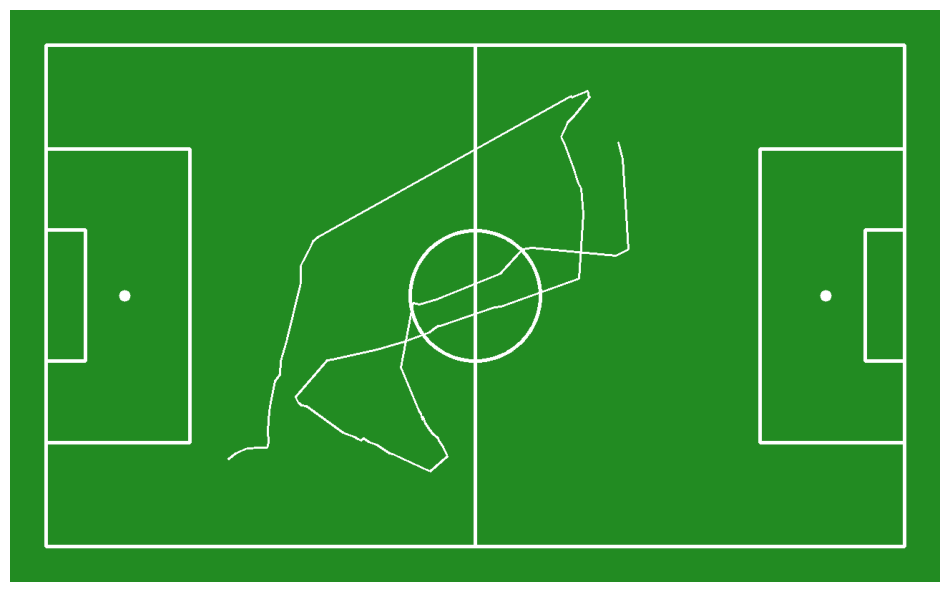

In [40]:
from sports.annotators.soccer import draw_paths_on_pitch

annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_paths_on_pitch(
    config=CONFIG,
    paths=[path],
    color=sv.Color.WHITE,
    pitch=annotated_frame)

sv.plot_image(annotated_frame)

In [ ]:
from typing import List, Union

def replace_outliers_based_on_distance(
    positions: List[np.ndarray],
    distance_threshold: float
) -> List[np.ndarray]:
    last_valid_position: Union[np.ndarray, None] = None
    cleaned_positions: List[np.ndarray] = []
    og_t=distance_threshold
    for position in positions:
        if len(position) == 0:
            # If the current position is already empty, just add it to the cleaned positions
            # cleaned_positions.append(position)
            distance_threshold+=50
            pass
        else:
            if last_valid_position is None:
                # If there's no valid last position, accept the first valid one
                cleaned_positions.append(position)
                last_valid_position = position
            else:
                # Calculate the distance from the last valid position
                distance = np.linalg.norm(position - last_valid_position)
                if distance > distance_threshold:
                    # Replace with empty array if the distance exceeds the threshold
                    # cleaned_positions.append(np.array([], dtype=np.float64))
                    distance_threshold+=50
                    pass 
                else:
                    cleaned_positions.append(position)
                    last_valid_position = position
                    distance_threshold=og_t

    return cleaned_positions

In [42]:

MAX_DISTANCE_THRESHOLD = 250

path_ = replace_outliers_based_on_distance(path, MAX_DISTANCE_THRESHOLD)

In [43]:
path_

[array([     8008.5,      1364.2], dtype=float32),
 array([     8062.4,      1593.1], dtype=float32),
 array([     4967.3,      4503.1], dtype=float32),
 array([     5218.1,      5105.4], dtype=float32),
 array([     5244.1,      5158.8], dtype=float32),
 array([       5262,      5233.7], dtype=float32),
 array([     5276.7,      5193.7], dtype=float32),
 array([     5306.5,      5286.6], dtype=float32),
 array([     5375.4,      5381.9], dtype=float32),
 array([     5404.1,      5427.9], dtype=float32),
 array([       5481,      5494.1], dtype=float32),
 array([     5499.7,      5528.1], dtype=float32),
 array([     5554.5,      5615.3], dtype=float32),
 array([     5610.1,      5748.2], dtype=float32),
 array([     5371.1,      5953.2], dtype=float32),
 array([     5302.3,      5925.5], dtype=float32),
 array([     4911.1,      5744.1], dtype=float32),
 array([     4850.9,      5718.4], dtype=float32),
 array([     4805.7,      5704.5], dtype=float32),
 array([     4739.4,      5651.

# Smooth Ball Movement

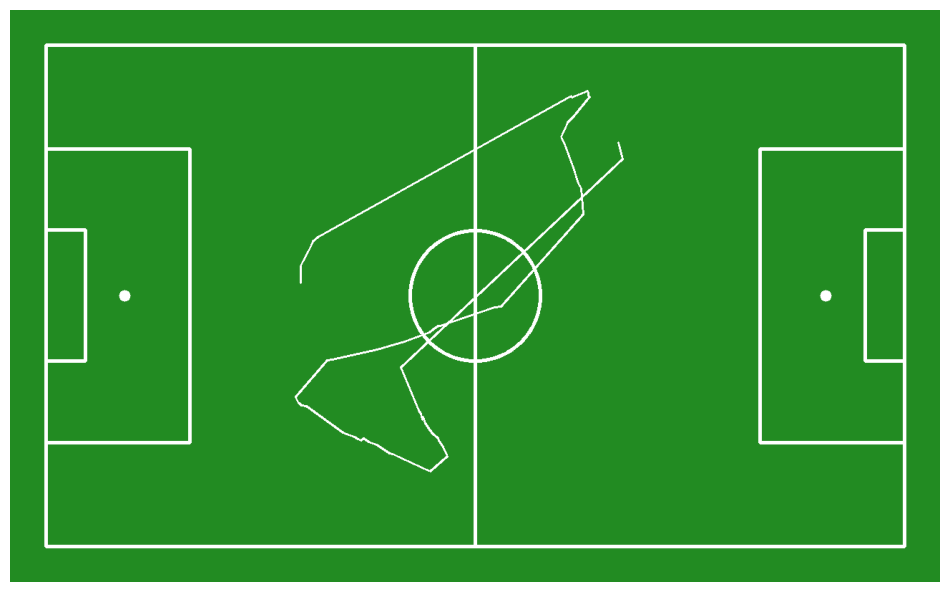

In [44]:
from sports.annotators.soccer import draw_paths_on_pitch

annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_paths_on_pitch(
    config=CONFIG,
    paths=[path_],
    color=sv.Color.WHITE,
    pitch=annotated_frame)

sv.plot_image(annotated_frame)